In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from PFNExperiments.LinearRegression.GenerativeModels.GenerateData import GenerateData, check_data, check_and_plot_data
from PFNExperiments.LinearRegression.GenerativeModels.GenerateDataLM_Examples import make_lm_program_trivial_batched

from PFNExperiments.LinearRegression.GenerativeModels.GenerateX import simulate_X_uniform
from PFNExperiments.LinearRegression.GenerativeModels.LM_abstract import return_only_y, print_code
from PFNExperiments.LinearRegression.GenerativeModels.Quantizer import Quantizer
from PFNExperiments.LinearRegression.Models.MLP_CNF import MLP_CNF, MLP_CNF_BN
from PFNExperiments.Training.Trainer import Trainer, batch_to_model_lm, visualize_training_results
from PFNExperiments.Training.Losses import MSELoss_unsqueezed, nll_loss_full_gaussian
from PFNExperiments.Training.EvalMetrics import mean_squared_error_torch_avg, mae_torch_avg, r2_score_torch_avg
from PFNExperiments.LinearRegression.Models.ModelPosterior import ModelPosteriorFullGaussian, ModelPosteriorFullGaussian2
from PFNExperiments.LinearRegression.Models.AugmentLoss import add_l2_loss_nll_loss

from PFNExperiments.Training.FlowMatching.CFMLossOT import CFMLossOT

from PFNExperiments.Evaluation.ComparePosteriorSamples import compare_all_metrics, marginal_plots_hist_parallel, marginal_plots_kde_together
from PFNExperiments.LinearRegression.Evaluation.CompareModels import ModelComparison
from PFNExperiments.LinearRegression.Models.ModelToPosterior import ModelToPosterior
from PFNExperiments.LinearRegression.ComparisonModels.Hamiltionion_MC import Hamiltionian_MC

from PFNExperiments.LinearRegression.ComparisonModels.Variational_Inference import Variational_Inference, make_guide_program_gamma_gamma

from PFNExperiments.LinearRegression.Evaluation.CompareComparisonModels import CompareComparisonModels

from PFNExperiments.LinearRegression.GenerativeModels.Curriculum import Curriculum
from PFNExperiments.LinearRegression.GenerativeModels.GenerateDataCurriculumCFM import GenerateDataCurriculumCFM

from PFNExperiments.Training.TrainerCurriculumCNF import TrainerCurriculumCNF

from PFNExperiments.LinearRegression.ComparisonModels.AnalyticalSolutionsLM import PosteriorLM_IG
from PFNExperiments.LinearRegression.GenerativeModels.GenerateDataLM_Examples import make_lm_program_ig_batched, make_lm_program_ig
from PFNExperiments.LinearRegression.GenerativeModels.GenerateX import simulate_X_uniform

from PFNExperiments.LinearRegression.Evaluation.CompareComparisonModels import CompareComparisonModels

c:\Users\arik_\Documents\Dokumente\Job_Clausthal\PFNs\Repository\PFNExperiments\.conda\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
N = 10
P = 4
BATCH_SIZE = 1024
N_EPOCHS = 100
N_SAMPLES_PER_EPOCH = 500_000
N_BATCHES_PER_EPOCH = N_SAMPLES_PER_EPOCH//BATCH_SIZE
SAVE_PATH = "Training/FlowMatching/SaveFolderTesting"

#BATCH_SIZE = 128

In [4]:
mu = 1.0
sigma = 2.0

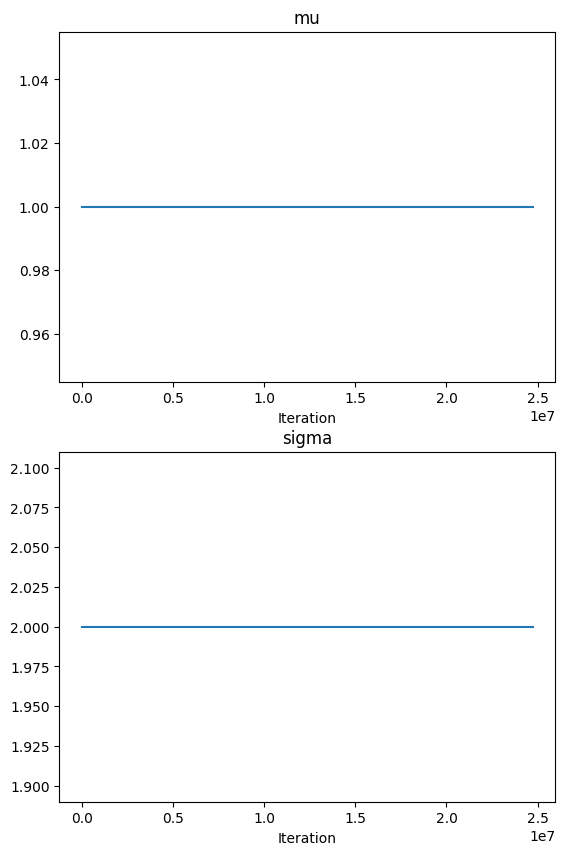

In [5]:
curriculum = Curriculum(max_iter=int(N_EPOCHS*N_BATCHES_PER_EPOCH*BATCH_SIZE*0.5))
curriculum.add_param_list(
    [
    ("mu", curriculum.constant_scheduler(mu)),
    ("sigma", curriculum.constant_scheduler(sigma)),
    ]
)
curriculum.plot_all_schedules()

In [6]:
curriculum.get_params(299*N_SAMPLES_PER_EPOCH)

{'mu': 1.0, 'sigma': 2.0}

In [7]:
data_generator = GenerateDataCurriculumCFM(
    pprogram_maker= make_lm_program_trivial_batched,
    curriculum= curriculum,
)

In [8]:
next(iter(data_generator.make_dataloaders_for_epoch_dynamic()[0])).keys()

dict_keys(['x', 'y', 'beta', 'time', 'base_sample_beta'])

####################################################################################################
Epoch 0


100%|██████████| 10/10 [00:00<00:00, 23.47it/s]


{'X': {'mean': tensor(0.5001), 'variance': tensor(0.0833), 'min': tensor(1.7881e-07), 'max': tensor(1.0000)}, 'y': {'mean': tensor(1.), 'variance': tensor(0.), 'min': tensor(1.), 'max': tensor(1.)}, 'beta': {'mean': tensor([1.0397, 0.9618, 0.9109, 0.9472, 0.9736]), 'variance': tensor([4.0578, 3.9362, 4.0755, 4.0292, 4.1932]), 'min': tensor([-6.3286, -5.6634, -6.7525, -5.7628, -6.1382]), 'max': tensor([7.9345, 8.9431, 6.9846, 7.5606, 7.7405])}}
Statistics for time:
Mean: 0.4999385984847322
Variance: 0.0836131712495932
Min: 2.5987625122070312e-05
Max: 0.9992560148239136


Statistics for base_sample_beta:
Mean: tensor([ 1.4628e-02, -1.8544e-02, -1.1756e-02, -9.8807e-05,  1.0414e-02])
Variance: tensor([0.9858, 1.0036, 1.0132, 1.0052, 1.0201])
Min: tensor([-2.9973, -3.5318, -3.6870, -3.4439, -3.8002])
Max: tensor([3.5856, 3.3228, 3.6880, 3.5605, 3.6786])




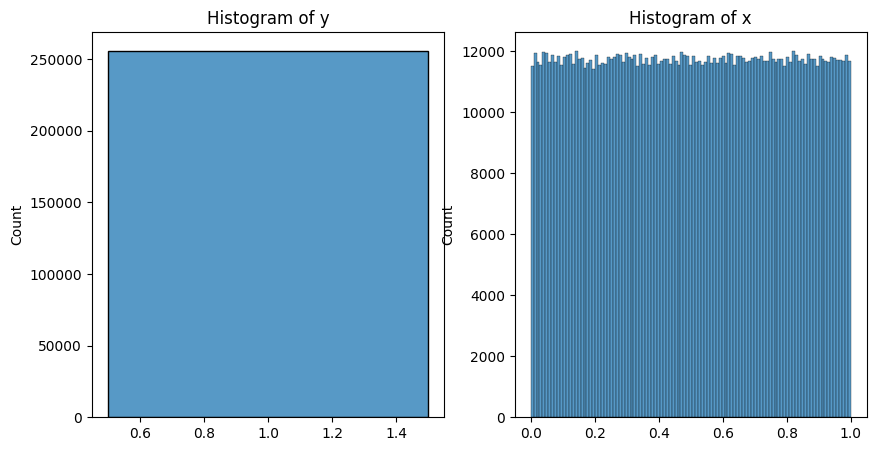

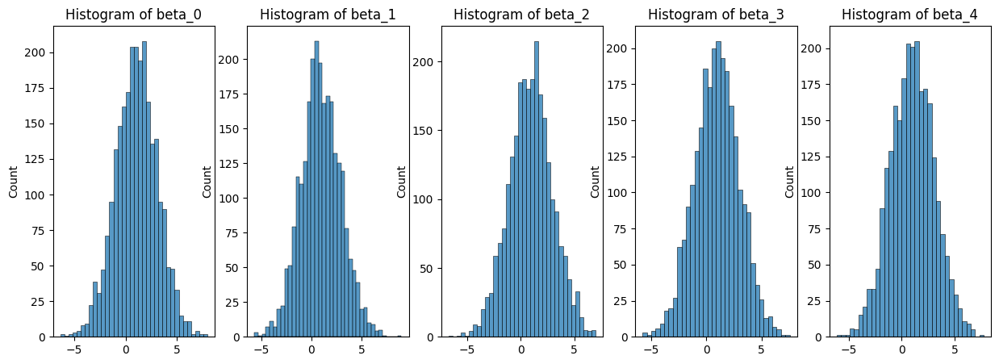

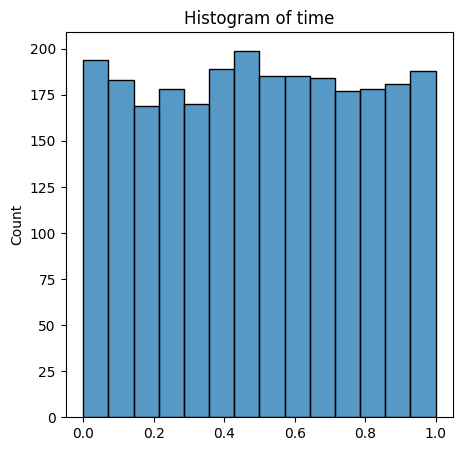

tensor([-0.7901,  0.5592, -0.9247,  ...,  0.1591,  0.1250,  0.2072])
tensor([-0.6484,  0.2329, -0.8012,  ..., -0.9403, -0.5549,  0.9549])
tensor([-1.7677, -0.8125,  0.5488,  ...,  1.3172,  1.1880, -2.2631])
tensor([-0.6823,  0.4980, -0.5614,  ..., -1.0302, -0.9572,  0.5050])
tensor([ 2.1907,  0.1184, -0.7036,  ..., -0.7470, -0.9199, -1.9565])


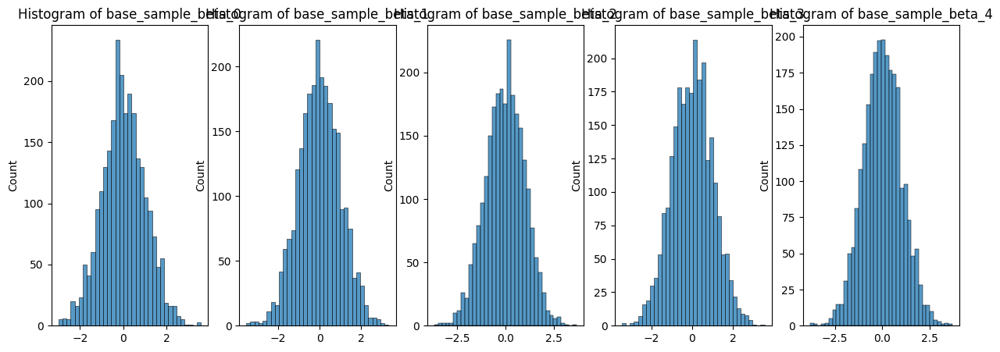

####################################################################################################
Epoch 99


100%|██████████| 10/10 [00:00<00:00, 28.61it/s]


{'X': {'mean': tensor(0.5002), 'variance': tensor(0.0832), 'min': tensor(1.1325e-06), 'max': tensor(1.0000)}, 'y': {'mean': tensor(1.), 'variance': tensor(0.), 'min': tensor(1.), 'max': tensor(1.)}, 'beta': {'mean': tensor([0.9326, 1.0329, 0.9491, 0.9904, 0.9784]), 'variance': tensor([3.8976, 4.1182, 3.9268, 4.1062, 4.0889]), 'min': tensor([-7.5871, -5.9472, -5.4624, -5.3571, -6.1200]), 'max': tensor([7.2944, 8.9848, 7.8925, 7.3127, 7.0556])}}
Statistics for time:
Mean: 0.5088214196963236
Variance: 0.08469063823211156
Min: 0.0003955960273742676
Max: 0.9989668726921082


Statistics for base_sample_beta:
Mean: tensor([ 0.0174,  0.0160, -0.0050,  0.0326,  0.0153])
Variance: tensor([0.9899, 0.9726, 1.0301, 1.0281, 1.0366])
Min: tensor([-3.8830, -3.0997, -3.6660, -3.5599, -3.4277])
Max: tensor([3.4830, 3.2374, 3.8240, 3.3181, 4.6559])




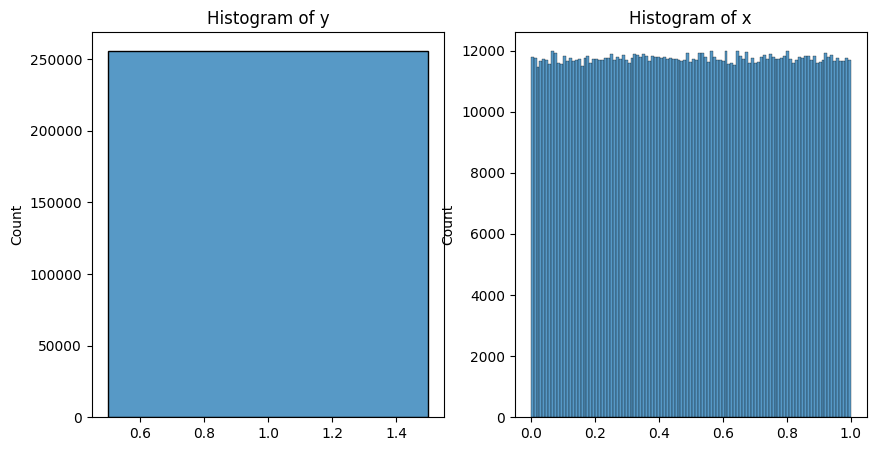

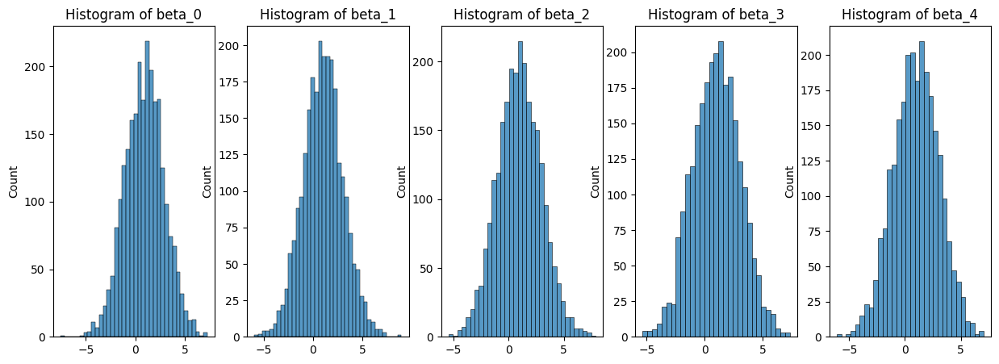

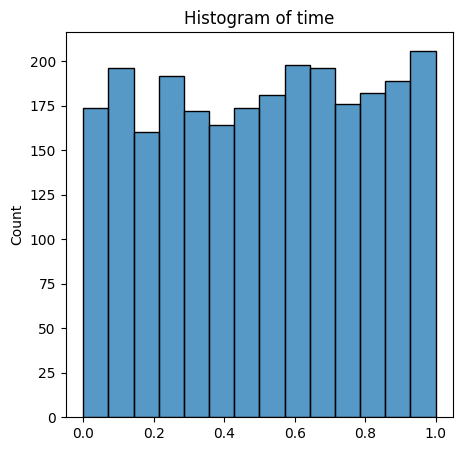

tensor([-0.1873,  0.0711,  0.7198,  ...,  0.9220,  1.9864, -1.5198])
tensor([-0.5205,  0.9874,  0.5933,  ...,  0.6527, -2.7549, -1.4402])
tensor([-1.7600, -0.6279,  0.5263,  ...,  0.2470, -0.5866,  0.3786])
tensor([-0.1741, -0.1426, -0.9530,  ..., -0.1259,  0.2221,  2.4330])
tensor([-1.0294,  0.1797,  0.1686,  ...,  0.8729,  0.7150, -2.0038])


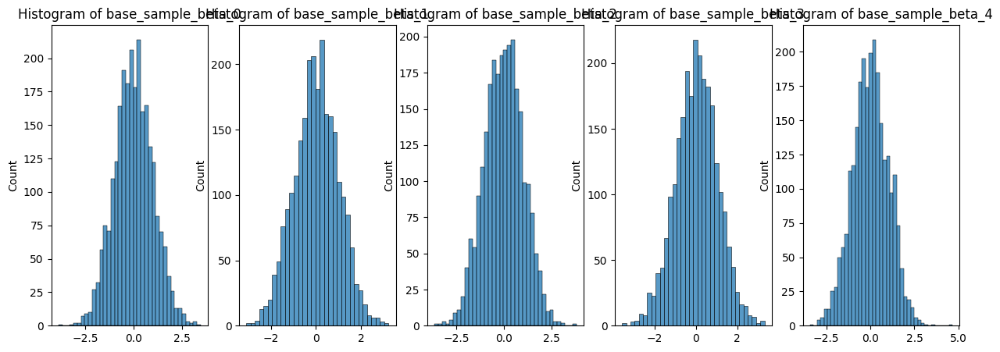

[{'X': {'mean': tensor(0.5001),
   'variance': tensor(0.0833),
   'min': tensor(1.7881e-07),
   'max': tensor(1.0000)},
  'y': {'mean': tensor(1.),
   'variance': tensor(0.),
   'min': tensor(1.),
   'max': tensor(1.)},
  'beta': {'mean': tensor([1.0397, 0.9618, 0.9109, 0.9472, 0.9736]),
   'variance': tensor([4.0578, 3.9362, 4.0755, 4.0292, 4.1932]),
   'min': tensor([-6.3286, -5.6634, -6.7525, -5.7628, -6.1382]),
   'max': tensor([7.9345, 8.9431, 6.9846, 7.5606, 7.7405])}},
 {'X': {'mean': tensor(0.5002),
   'variance': tensor(0.0832),
   'min': tensor(1.1325e-06),
   'max': tensor(1.0000)},
  'y': {'mean': tensor(1.),
   'variance': tensor(0.),
   'min': tensor(1.),
   'max': tensor(1.)},
  'beta': {'mean': tensor([0.9326, 1.0329, 0.9491, 0.9904, 0.9784]),
   'variance': tensor([3.8976, 4.1182, 3.9268, 4.1062, 4.0889]),
   'min': tensor([-7.5871, -5.9472, -5.4624, -5.3571, -6.1200]),
   'max': tensor([7.2944, 8.9848, 7.8925, 7.3127, 7.0556])}}]

In [9]:
data_generator.check_model(
    n_samples_per_epoch=N_SAMPLES_PER_EPOCH,
    epochs_to_check = [0, N_EPOCHS-1],
    p = 5,
    used_batch_samples = 10
)

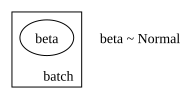

In [10]:
data_generator.render_model()

In [11]:
epoch_loader = data_generator.make_epoch_loader(
    n = N,
    p = P,
    number_of_batches_per_epoch = N_BATCHES_PER_EPOCH,
    n_epochs = N_EPOCHS,
    batch_size= BATCH_SIZE,
    train_frac= 0.5,
    val_frac= 0.1,
    shuffle=False,
    n_samples_to_generate_at_once = 250_000
)

The number of batches times the number of epochs must be equal to the total number of iterations in the curriculum. But got 49971200 and 24985600 respectively


In [12]:
sample_batch = next(iter(epoch_loader[0][0]))

In [13]:
sample_batch.keys()

dict_keys(['x', 'y', 'beta', 'time', 'base_sample_beta'])

In [14]:
"""
model = Transformer(
    n_features= P+1,
    seq_len= N,
    d_model= 1024,
    n_heads=4,
    dim_feedforward=512,
    n_layers=4,
    n_skip_layers_final_heads = 3,
    n_output_units_per_head=[5]
).cuda()
"""

model = MLP_CNF_BN(
    n_data_inputs= (P+1)*N,
    n_parameter_inputs = P,
    hidden_size=512,
)

In [15]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [16]:
'{:.2e}'.format(count_parameters(model))

'2.11e+06'

In [17]:
import torch
from torch.optim.lr_scheduler import ReduceLROnPlateau, OneCycleLR

In [18]:
lr = 1e-4
opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)

In [19]:
loss_fun = CFMLossOT(
    sigma_min=1e-2
)

In [20]:
scheduler = OneCycleLR(opt,
                       max_lr = 1e-4,
                       epochs = N_EPOCHS,
                       steps_per_epoch = N_SAMPLES_PER_EPOCH//BATCH_SIZE,
                       pct_start = 0.1,
                       div_factor=25.0,
                       final_div_factor=1e2)

scheduler = ReduceLROnPlateau(opt)

additional_evals = {
}

In [21]:
trainer = TrainerCurriculumCNF(
    model = model,
    optimizer=opt,
    scheduler = None,
    loss_function=loss_fun,
    epoch_loader = epoch_loader,
    evaluation_functions= additional_evals,
    n_epochs = N_EPOCHS,
    early_stopping_patience = 200,
    schedule_step_on = "batch",
    save_path = SAVE_PATH
)

In [22]:
trainer.save_path

'Training/FlowMatching/SaveFolderTesting/experiment_2024_06_11_09_04_57'

In [23]:
trainer.validate()

100%|██████████| 49/49 [00:08<00:00,  5.68it/s]


{'loss': 637.3569946289062,
 'median_loss': 642.3816528320312,
 'std_loss': 114.43257904052734}

In [24]:
%load_ext tensorboard
%tensorboard --logdir /content/runs

Reusing TensorBoard on port 6006 (pid 21176), started 15:42:35 ago. (Use '!kill 21176' to kill it.)

In [25]:
r = trainer.train()

Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 0


100%|██████████| 49/49 [00:09<00:00,  5.32it/s]


Epoch 0:
Training: {'loss': 573.2963256835938}
Validation: {'loss': 564.3692016601562, 'median_loss': 561.5965576171875, 'std_loss': 139.4441680908203}
Validation curriculum: {'loss': 531.6221923828125, 'median_loss': 533.3450317382812, 'std_loss': 117.64739227294922}
Time: 116.78630948066711


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 249856


100%|██████████| 49/49 [00:08<00:00,  6.02it/s]


Epoch 1:
Training: {'loss': 537.2293701171875}
Validation: {'loss': 524.8784790039062, 'median_loss': 492.8238830566406, 'std_loss': 113.21220397949219}
Validation curriculum: {'loss': 513.3012084960938, 'median_loss': 512.6963500976562, 'std_loss': 106.99185180664062}
Time: 106.26995658874512


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 499712


100%|██████████| 49/49 [00:08<00:00,  5.84it/s]


Epoch 2:
Training: {'loss': 475.204833984375}
Validation: {'loss': 454.5873718261719, 'median_loss': 453.9998474121094, 'std_loss': 124.86741638183594}
Validation curriculum: {'loss': 417.48406982421875, 'median_loss': 393.2843322753906, 'std_loss': 107.45387268066406}
Time: 75.45110774040222


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 749568


100%|██████████| 49/49 [00:04<00:00,  9.98it/s]


Epoch 3:
Training: {'loss': 396.7671203613281}
Validation: {'loss': 390.7525634765625, 'median_loss': 391.63909912109375, 'std_loss': 93.28045654296875}
Validation curriculum: {'loss': 365.2291564941406, 'median_loss': 352.5469055175781, 'std_loss': 85.29695129394531}
Time: 70.71989440917969


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 999424


100%|██████████| 49/49 [00:05<00:00,  9.11it/s]


Epoch 4:
Training: {'loss': 361.12347412109375}
Validation: {'loss': 346.5207214355469, 'median_loss': 342.5571594238281, 'std_loss': 81.49728393554688}
Validation curriculum: {'loss': 367.90362548828125, 'median_loss': 382.0715026855469, 'std_loss': 87.96066284179688}
Time: 65.07835221290588


----------------------------------------------------------------------------------------------------
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 1249280


100%|██████████| 49/49 [00:05<00:00,  9.71it/s]


Epoch 5:
Training: {'loss': 309.89361572265625}
Validation: {'loss': 313.60528564453125, 'median_loss': 303.1516418457031, 'std_loss': 82.58383178710938}
Validation curriculum: {'loss': 286.20172119140625, 'median_loss': 278.6125183105469, 'std_loss': 74.44711303710938}
Time: 64.04666137695312


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 1499136


100%|██████████| 49/49 [00:05<00:00,  9.60it/s]


Epoch 6:
Training: {'loss': 270.392333984375}
Validation: {'loss': 246.0762939453125, 'median_loss': 231.93789672851562, 'std_loss': 68.40750885009766}
Validation curriculum: {'loss': 241.09225463867188, 'median_loss': 240.4207305908203, 'std_loss': 60.902652740478516}
Time: 66.3142659664154


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 1748992


100%|██████████| 49/49 [00:03<00:00, 15.15it/s]


Epoch 7:
Training: {'loss': 247.05592346191406}
Validation: {'loss': 221.27227783203125, 'median_loss': 217.27633666992188, 'std_loss': 62.30849075317383}
Validation curriculum: {'loss': 232.6713409423828, 'median_loss': 226.46400451660156, 'std_loss': 60.632938385009766}
Time: 57.77220916748047


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 1998848


100%|██████████| 49/49 [00:03<00:00, 14.99it/s]


Epoch 8:
Training: {'loss': 214.42642211914062}
Validation: {'loss': 200.66685485839844, 'median_loss': 196.98094177246094, 'std_loss': 55.51519775390625}
Validation curriculum: {'loss': 208.24069213867188, 'median_loss': 195.11959838867188, 'std_loss': 55.37528991699219}
Time: 40.600465536117554


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 2248704


100%|██████████| 49/49 [00:03<00:00, 14.42it/s]


Epoch 9:
Training: {'loss': 195.04684448242188}
Validation: {'loss': 176.7530059814453, 'median_loss': 179.2318878173828, 'std_loss': 35.29279327392578}
Validation curriculum: {'loss': 168.09652709960938, 'median_loss': 167.1167449951172, 'std_loss': 35.96370315551758}
Time: 41.20444893836975


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 2498560


100%|██████████| 49/49 [00:03<00:00, 14.25it/s]


Epoch 10:
Training: {'loss': 178.43702697753906}
Validation: {'loss': 161.86978149414062, 'median_loss': 156.49957275390625, 'std_loss': 44.93253707885742}
Validation curriculum: {'loss': 170.00209045410156, 'median_loss': 165.07421875, 'std_loss': 42.107826232910156}
Time: 43.11680459976196


----------------------------------------------------------------------------------------------------
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 2748416


100%|██████████| 49/49 [00:03<00:00, 12.58it/s]


Epoch 11:
Training: {'loss': 171.2217254638672}
Validation: {'loss': 150.90249633789062, 'median_loss': 151.05899047851562, 'std_loss': 35.69825744628906}
Validation curriculum: {'loss': 154.64239501953125, 'median_loss': 152.33335876464844, 'std_loss': 45.55645751953125}
Time: 45.27579855918884


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 2998272


100%|██████████| 49/49 [00:04<00:00, 11.83it/s]


Epoch 12:
Training: {'loss': 154.07052612304688}
Validation: {'loss': 142.33255004882812, 'median_loss': 142.07362365722656, 'std_loss': 26.700143814086914}
Validation curriculum: {'loss': 151.4165496826172, 'median_loss': 148.90911865234375, 'std_loss': 35.08385467529297}
Time: 53.538479804992676


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 3248128


100%|██████████| 49/49 [00:03<00:00, 13.54it/s]


Epoch 13:
Training: {'loss': 152.8826141357422}
Validation: {'loss': 139.3964385986328, 'median_loss': 139.9179229736328, 'std_loss': 25.352643966674805}
Validation curriculum: {'loss': 133.9134521484375, 'median_loss': 127.46768188476562, 'std_loss': 36.33531951904297}
Time: 57.669180393218994


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 3497984


100%|██████████| 49/49 [00:03<00:00, 14.16it/s]


Epoch 14:
Training: {'loss': 145.8459930419922}
Validation: {'loss': 134.30133056640625, 'median_loss': 132.89065551757812, 'std_loss': 34.51028823852539}
Validation curriculum: {'loss': 127.39524841308594, 'median_loss': 120.61949157714844, 'std_loss': 28.030778884887695}
Time: 45.091835021972656


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 3747840


100%|██████████| 49/49 [00:03<00:00, 14.34it/s]


Epoch 15:
Training: {'loss': 135.71328735351562}
Validation: {'loss': 119.08180236816406, 'median_loss': 118.23762512207031, 'std_loss': 25.46806526184082}
Validation curriculum: {'loss': 128.76388549804688, 'median_loss': 127.54798889160156, 'std_loss': 29.61925506591797}
Time: 44.197025537490845


----------------------------------------------------------------------------------------------------
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 3997696


100%|██████████| 49/49 [00:03<00:00, 13.56it/s]


Epoch 16:
Training: {'loss': 136.82215881347656}
Validation: {'loss': 123.25909423828125, 'median_loss': 119.46073913574219, 'std_loss': 24.336889266967773}
Validation curriculum: {'loss': 124.27806091308594, 'median_loss': 122.75098419189453, 'std_loss': 21.39324951171875}
Time: 44.28317427635193


----------------------------------------------------------------------------------------------------
Saving model
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 4247552


100%|██████████| 49/49 [00:04<00:00, 10.38it/s]


Epoch 17:
Training: {'loss': 133.02859497070312}
Validation: {'loss': 120.53417205810547, 'median_loss': 113.11184692382812, 'std_loss': 28.643918991088867}
Validation curriculum: {'loss': 127.07891845703125, 'median_loss': 120.14569091796875, 'std_loss': 31.55323028564453}
Time: 63.52443242073059


----------------------------------------------------------------------------------------------------
Curriculum parameters: {'mu': 1.0, 'sigma': 2.0} at iteration 4497408


 19%|█▉        | 47/244 [00:09<00:40,  4.87it/s]


KeyboardInterrupt: 

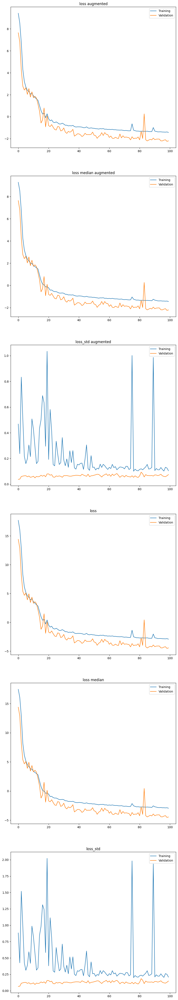

In [ ]:
visualize_training_results(r, loglog = False)

In [ ]:
trainer.load_best_model()

In [ ]:
model = trainer.model

In [ ]:
model.eval()

Transformer(
  (mlp1): PositionwiseFeedForward(
    (w_1): Linear(in_features=11, out_features=261, bias=True)
    (w_2): Linear(in_features=261, out_features=512, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (act1): LeakyReLU(negative_slope=0.01)
  (encoder_layer): TransformerEncoderLayer(
    (self_attn): MultiheadAttention(
      (out_proj): NonDynamicallyQuantizableLinear(in_features=512, out_features=512, bias=True)
    )
    (linear1): Linear(in_features=512, out_features=1024, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
    (linear2): Linear(in_features=1024, out_features=512, bias=True)
    (norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
    (norm2): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
    (dropout1): Dropout(p=0.1, inplace=False)
    (dropout2): Dropout(p=0.1, inplace=False)
  )
  (encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-5): 6 x TransformerEncoderLayer(
        (self_attn): MultiheadAttentio

In [ ]:
trainer.load_best_model()

In [ ]:
trainer.model.cuda()

Transformer(
  (mlp1): PositionwiseFeedForward(
    (w_1): Linear(in_features=11, out_features=261, bias=True)
    (w_2): Linear(in_features=261, out_features=512, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (act1): LeakyReLU(negative_slope=0.01)
  (encoder_layer): TransformerEncoderLayer(
    (self_attn): MultiheadAttention(
      (out_proj): NonDynamicallyQuantizableLinear(in_features=512, out_features=512, bias=True)
    )
    (linear1): Linear(in_features=512, out_features=1024, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
    (linear2): Linear(in_features=1024, out_features=512, bias=True)
    (norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
    (norm2): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
    (dropout1): Dropout(p=0.1, inplace=False)
    (dropout2): Dropout(p=0.1, inplace=False)
  )
  (encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-5): 6 x TransformerEncoderLayer(
        (self_attn): MultiheadAttentio

In [ ]:
trainer.test()

100%|██████████| 196/196 [01:32<00:00,  2.11it/s]


{'loss augmented': tensor(-2.2262),
 'loss median augmented': -2.2285814,
 'loss_std augmented': tensor(0.0803),
 'loss': tensor(-4.4945),
 'loss median': -4.4991918,
 'loss_std': tensor(0.1580)}

In [ ]:
full_model = ModelToPosterior(model.cpu(), mod_posterior)

In [ ]:
benchmark_params_ppgrogram = data_generator.curriculum.get_params(-1)
print(f"params for pprogram: {benchmark_params_ppgrogram}")

pprogram1 = make_lm_program_ig(**benchmark_params_ppgrogram)

pprogram1_y = return_only_y(pprogram1)
print_code(pprogram1)

params for pprogram: {'tau': 1.0, 'a': 5.0, 'b': 2.0}
        def multivariate_lm_return_dict(x: torch.Tensor, y: torch.Tensor = None) -> dict:
                # Define distributions for the global parameters
                sigma_squared_dist = dist.InverseGamma(a, b)

                beta_cov = torch.eye(x.shape[1]) * (tau ** 2)  # the covariance matrix of the parameters of the linear model

                sigma_squared = pyro.sample("sigma_squared", sigma_squared_dist).squeeze()

                beta_dist = dist.MultivariateNormal(torch.zeros(x.shape[1]), beta_cov)
                beta = pyro.sample("beta", beta_dist)

                # Compute mean using matrix multiplication
                mean = torch.matmul(x, beta)

                with pyro.plate("data", len(x)):
                        y = pyro.sample("obs", pyro.distributions.Normal(mean, sigma_squared), obs=y)


                return {
                        "x": x,
                        "y": y,
                      

In [ ]:
test_loader = trainer.testset

In [ ]:
test_batch = next(iter(test_loader))

In [ ]:
test_batch["beta"][:5]

tensor([[-1.2818,  0.9873,  0.1482, -0.5712, -0.5984, -0.5473, -0.9527,  1.5223,
         -0.3405, -1.2228],
        [-0.4696, -0.7058, -0.0346,  0.0329,  1.0993,  0.2038, -0.9372, -0.0417,
         -1.4167, -0.8117],
        [ 0.1525,  0.1409,  0.1654,  1.2303, -1.2372,  1.3794,  0.8367, -0.8166,
          1.4082, -0.2033],
        [-0.3502, -0.5646,  1.3642, -0.2790,  0.0473,  0.5746,  1.0498,  0.1797,
          0.4345, -1.3403],
        [ 1.2414,  1.5476, -1.0665, -0.4631,  0.6295,  0.3571, -0.3854, -0.2166,
         -2.0196,  0.0409]])

In [ ]:
analytical_solution = PosteriorLM_IG(
    pprogram_dict= {
        "tau": tau,
        "a": a,
        "b": b
    },
    n_samples=10_000
)

comparison_model_full_model_gt = ModelComparison(
    modelposterior=full_model,
    comparison_model=analytical_solution,
    save_path = trainer.save_path
)


In [ ]:
def print_wasserstein_distances(res):
  res = res[0]
  distances = []
  for elem in res:
    try:
      distances.append(elem['Wasserstein_distance with metric euclidean'])
    except:
      distances[0].append(elem['Wasserstein_distance with metric euclidean'])


  print(distances)
  print(sum(distances)/len(distances))

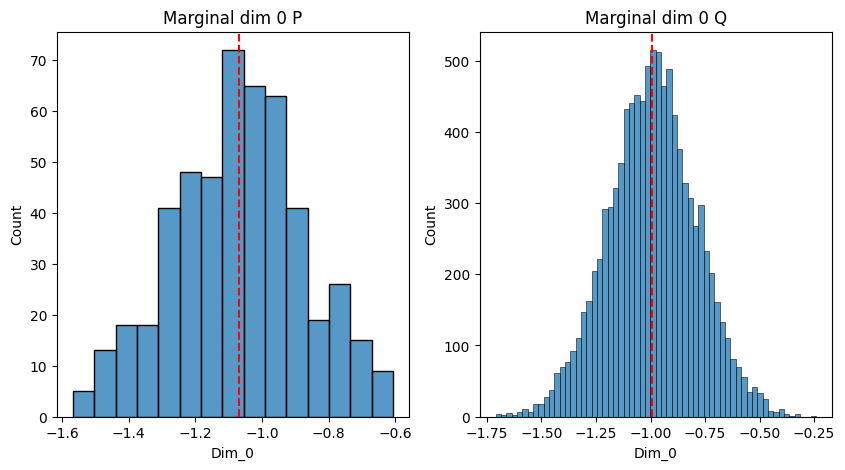

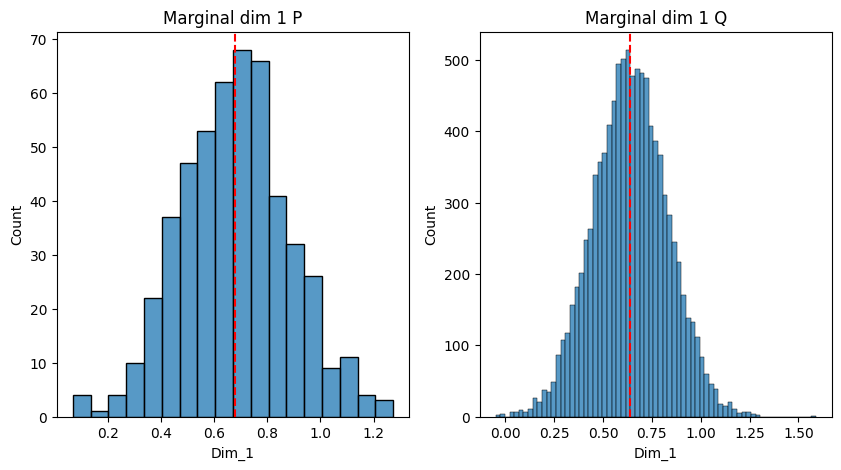

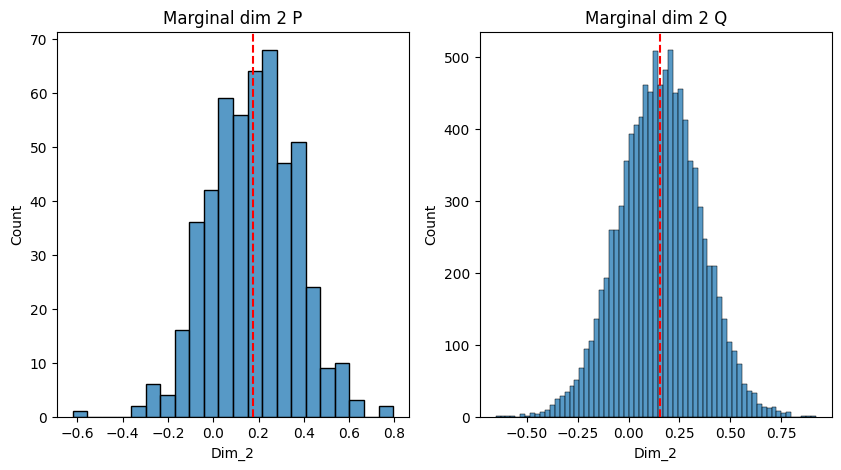

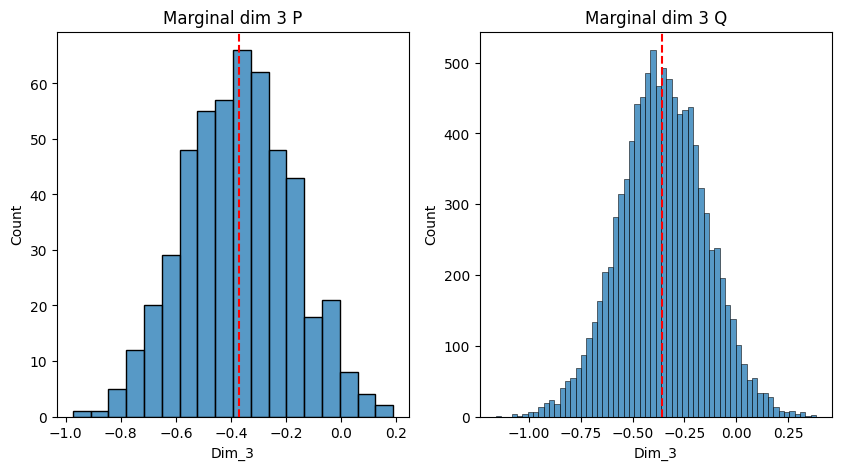

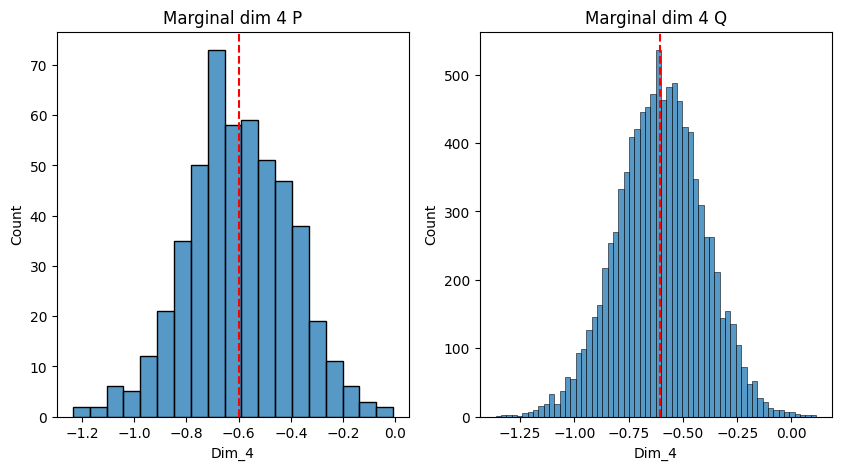

...

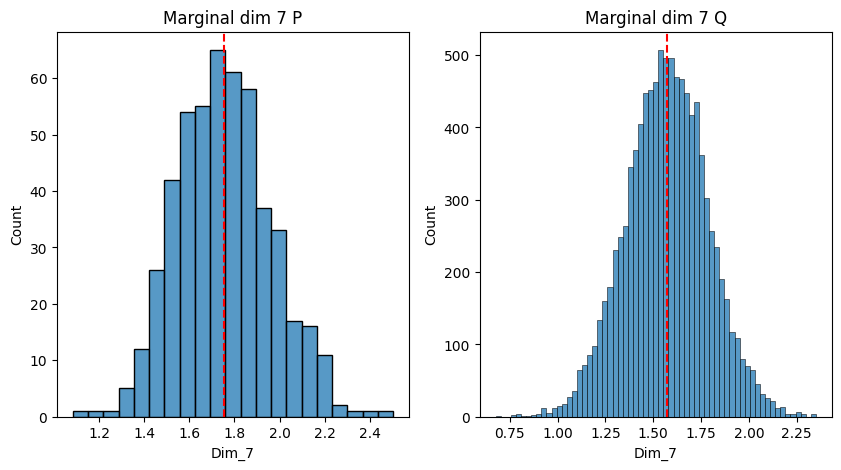

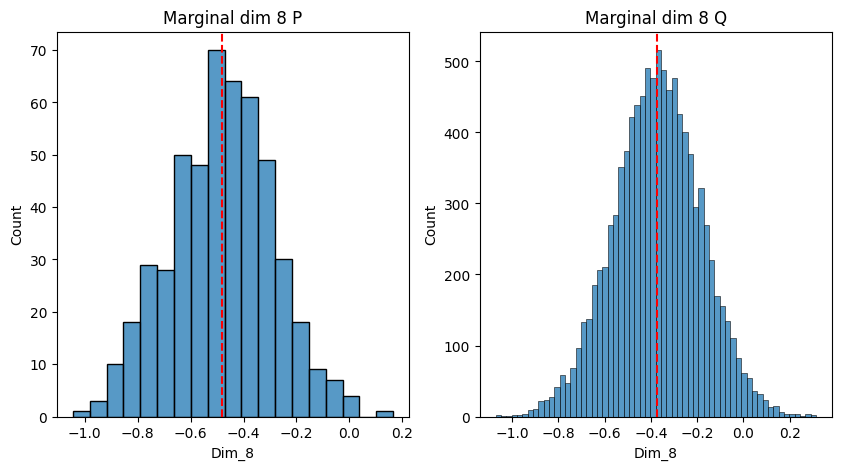

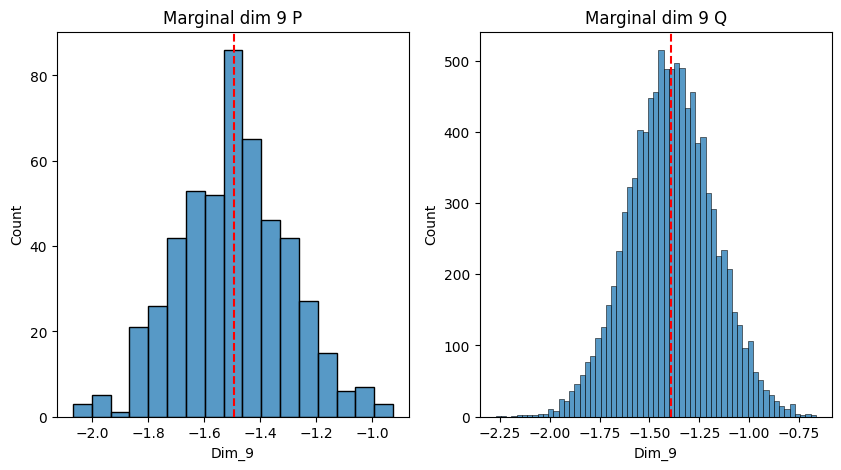

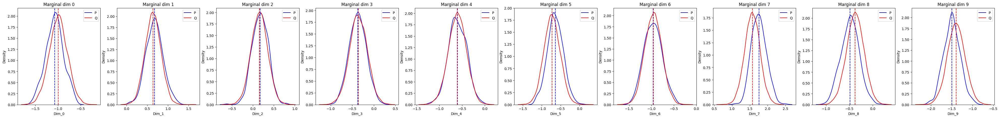

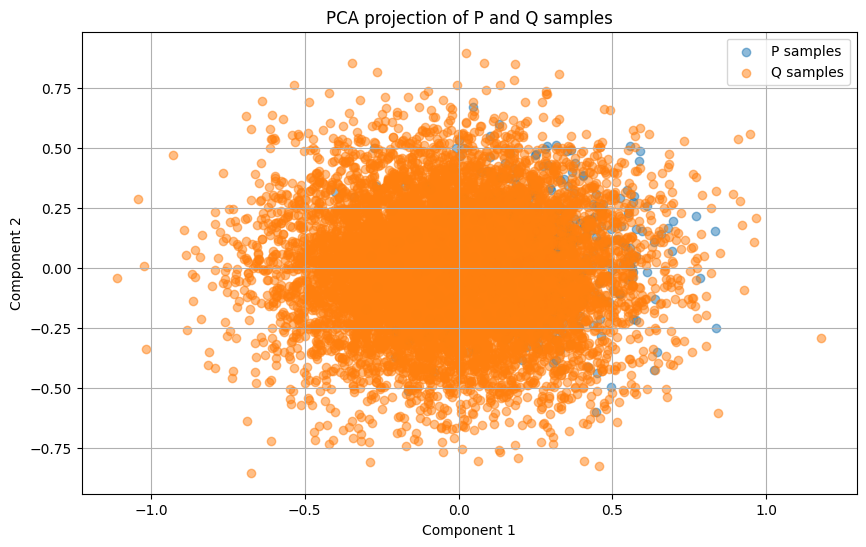

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


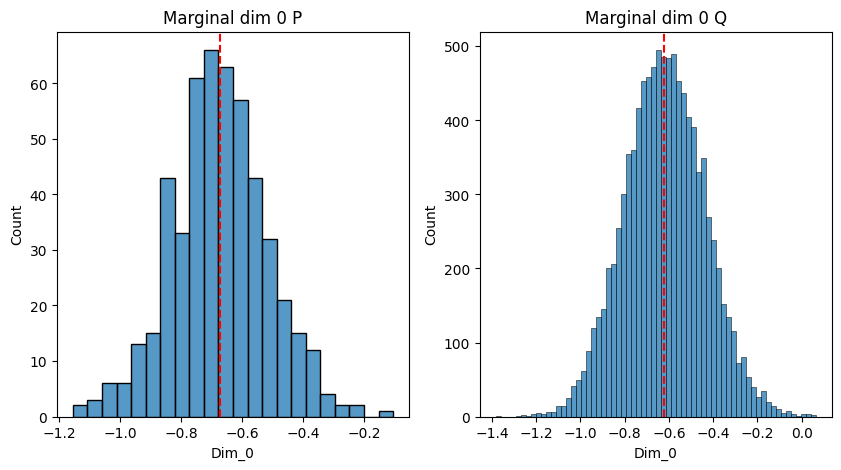

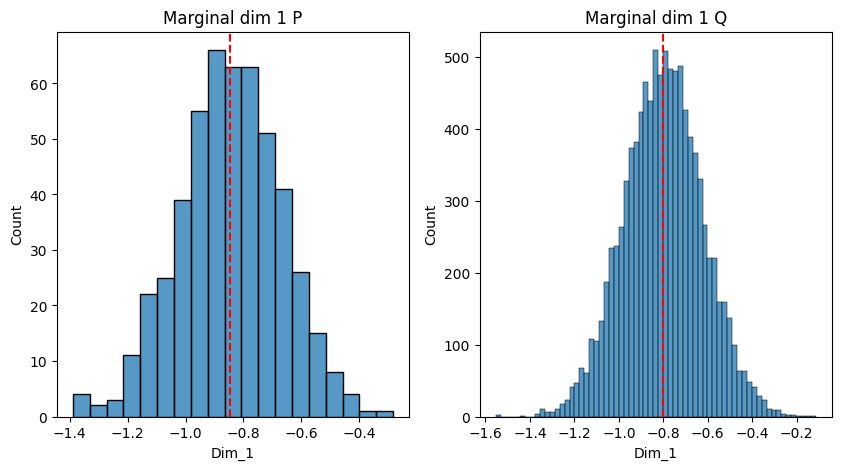

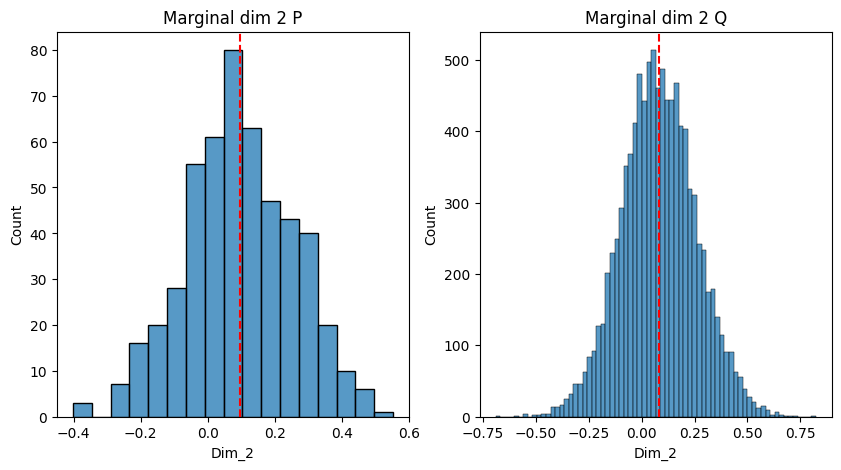

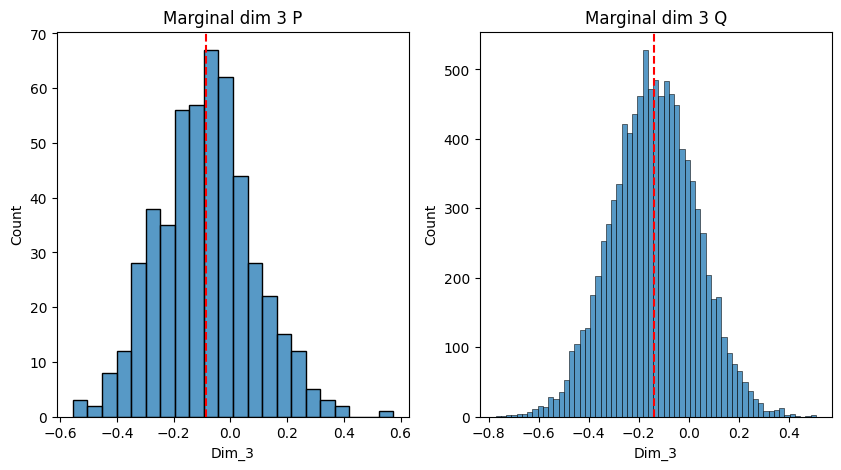

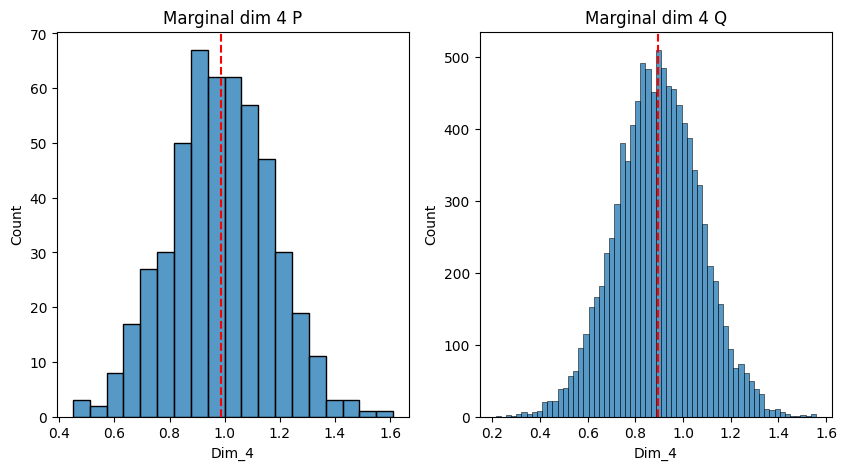

...

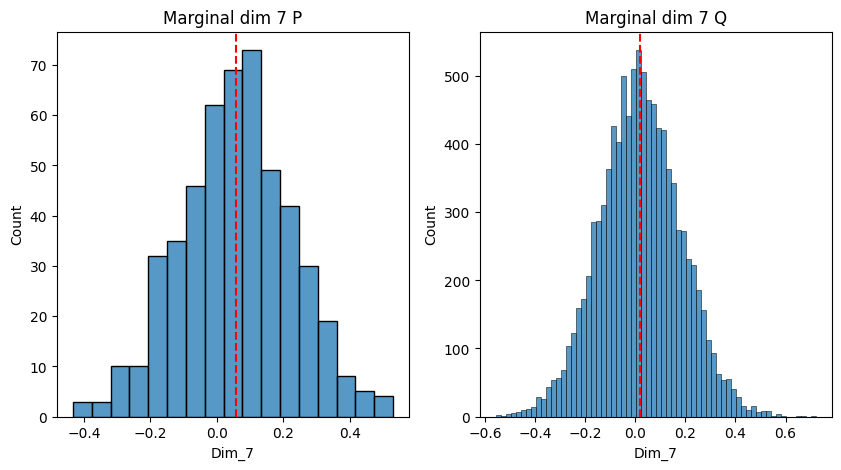

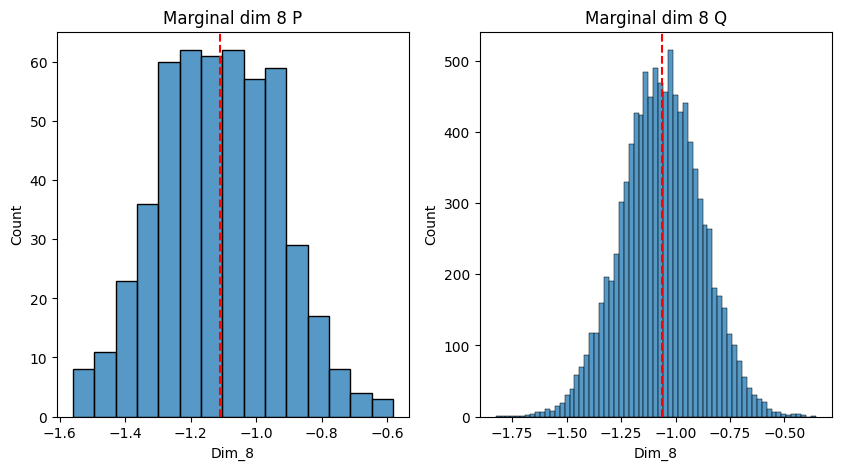

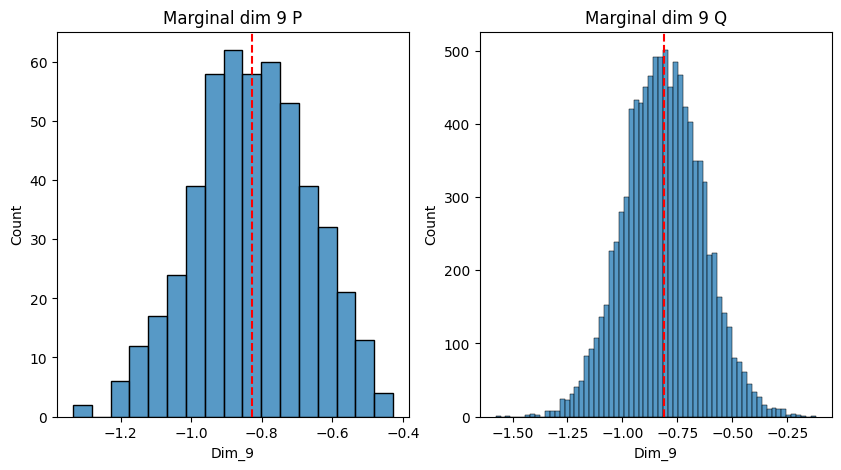

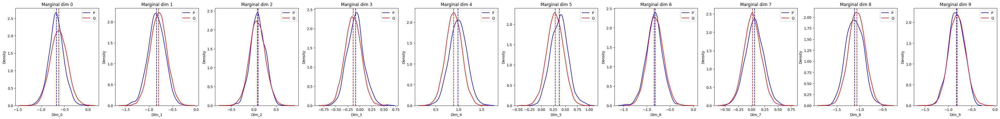

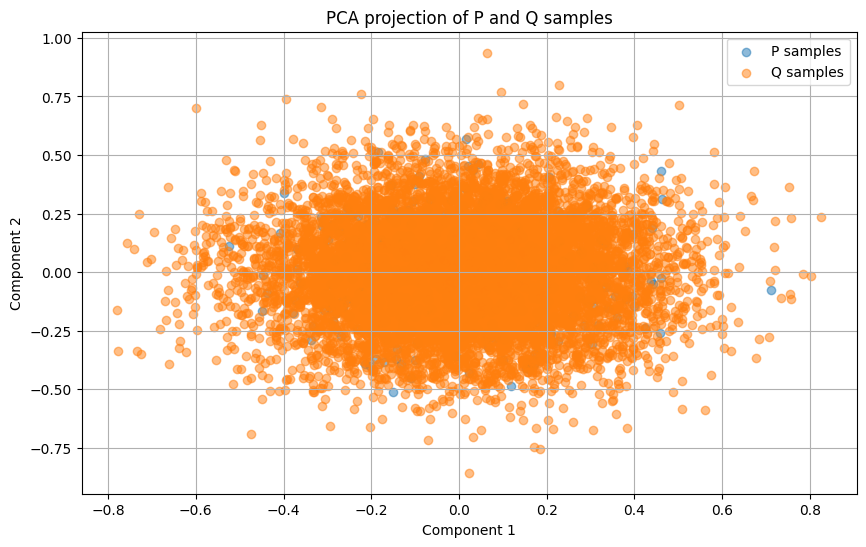

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


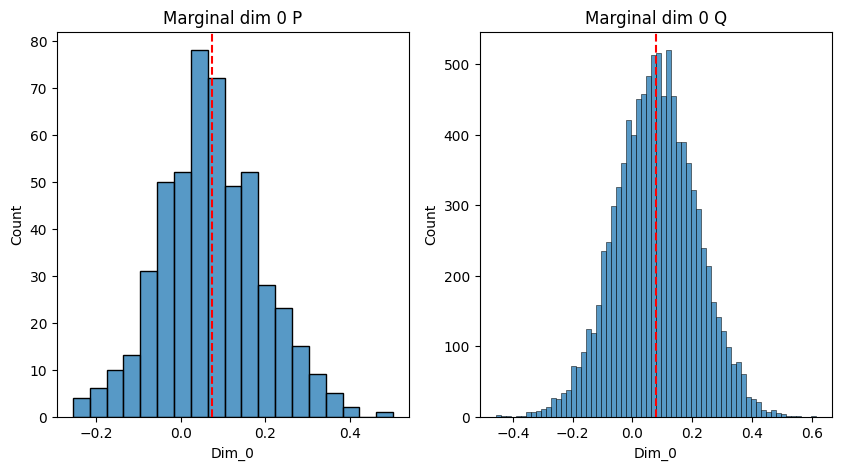

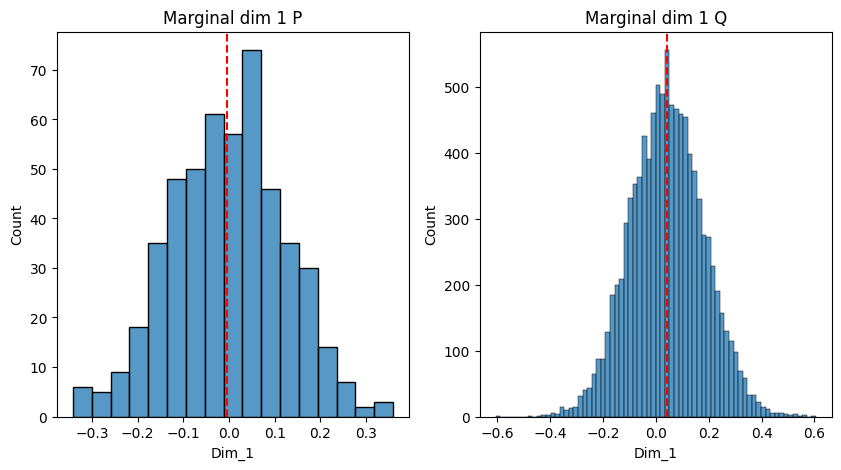

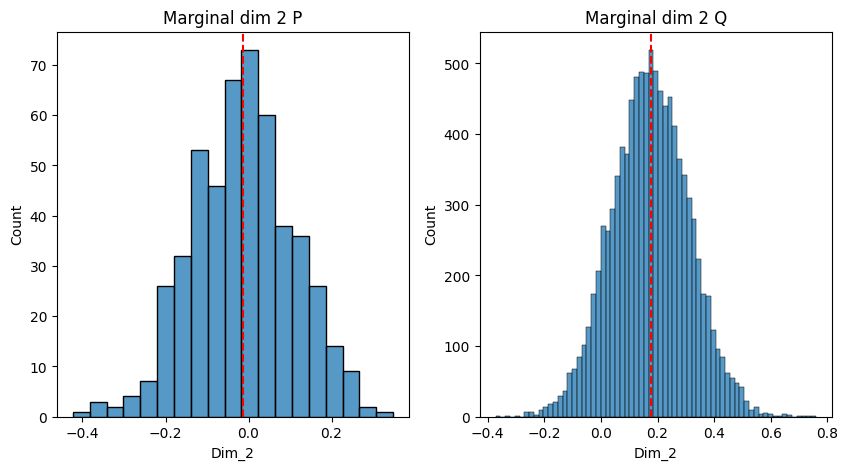

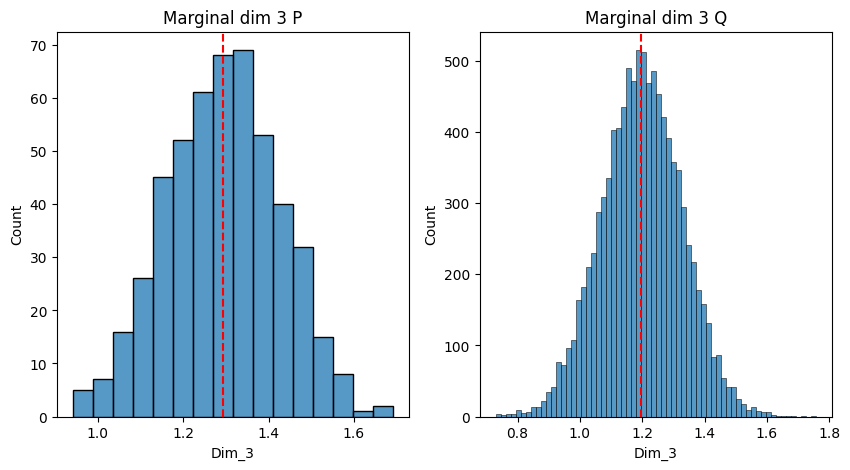

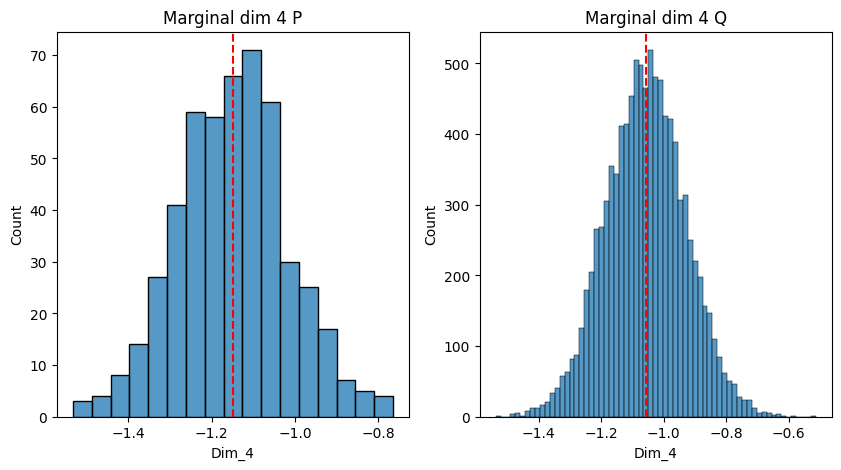

...

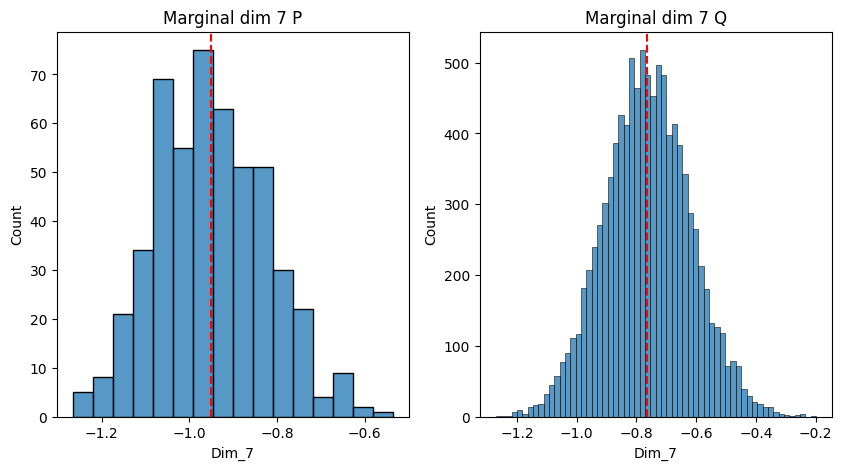

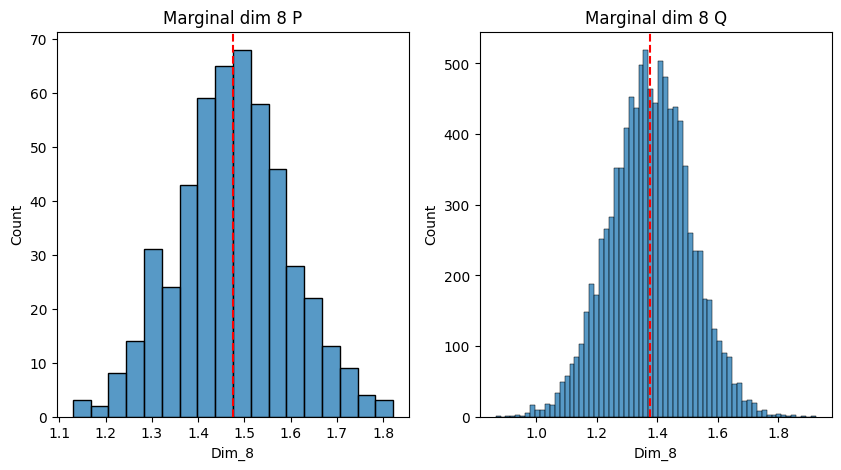

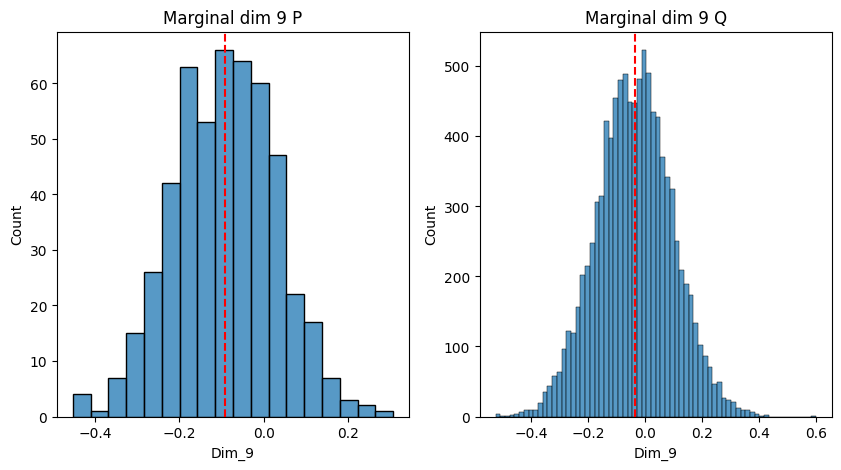

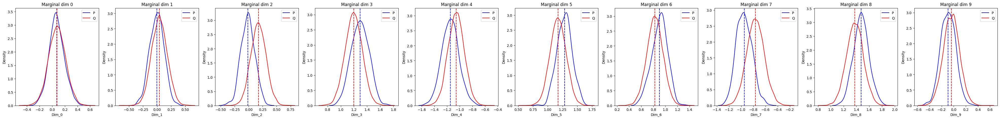

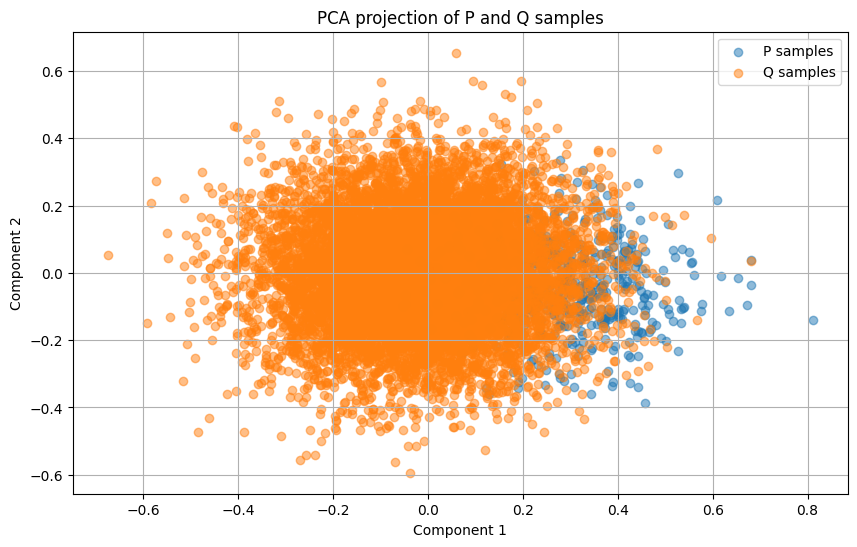

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


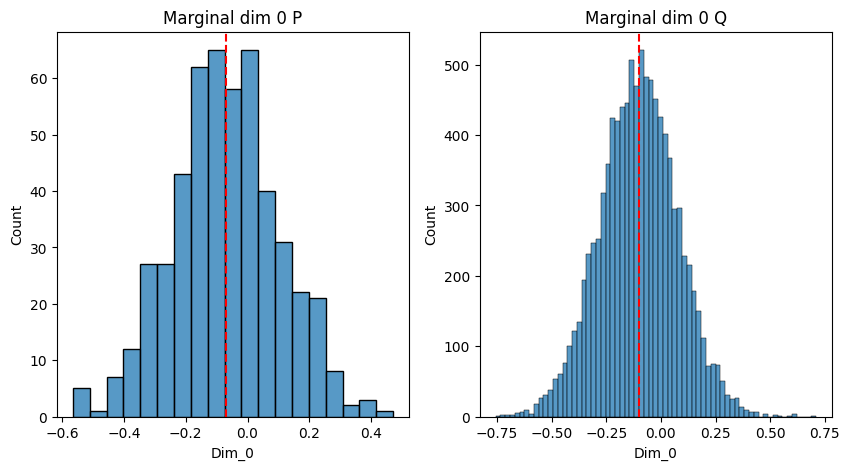

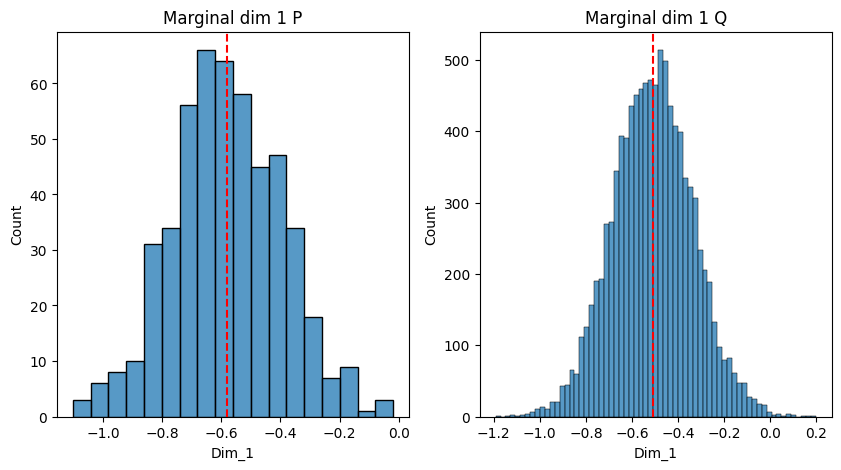

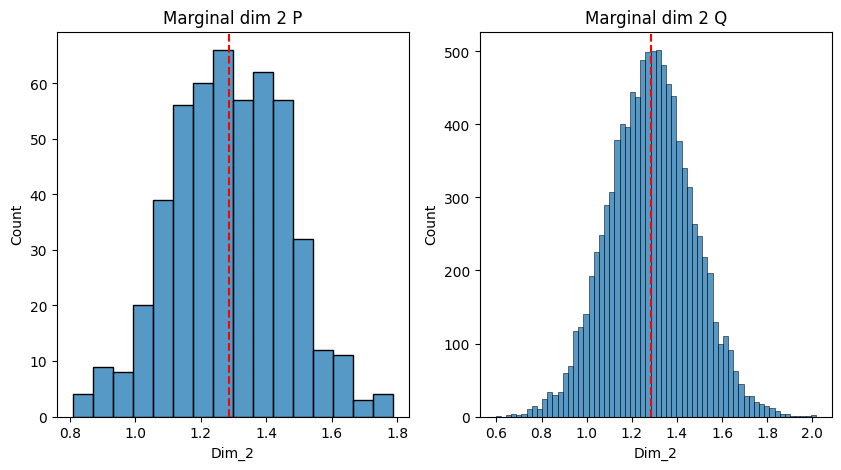

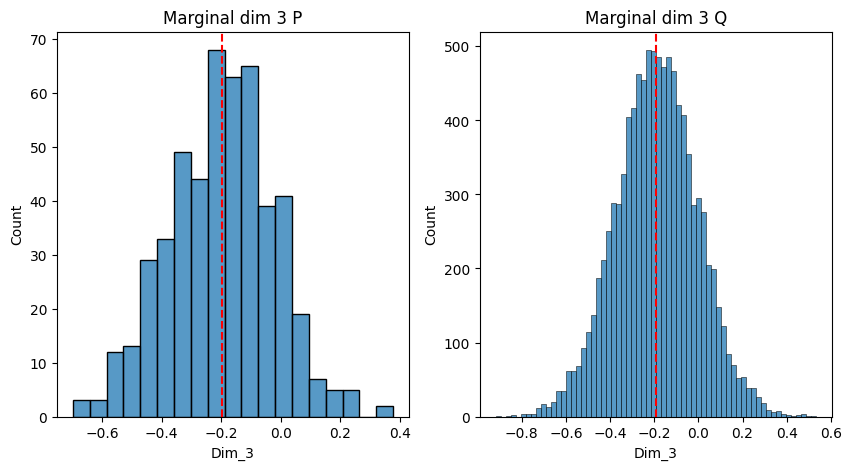

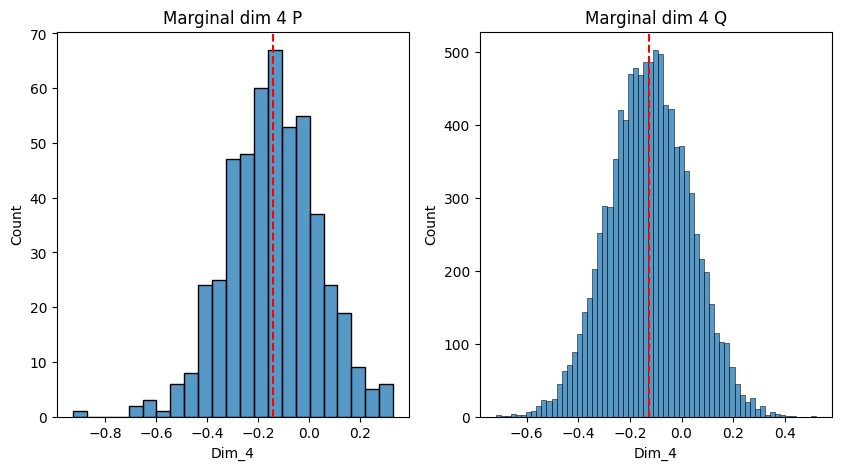

...

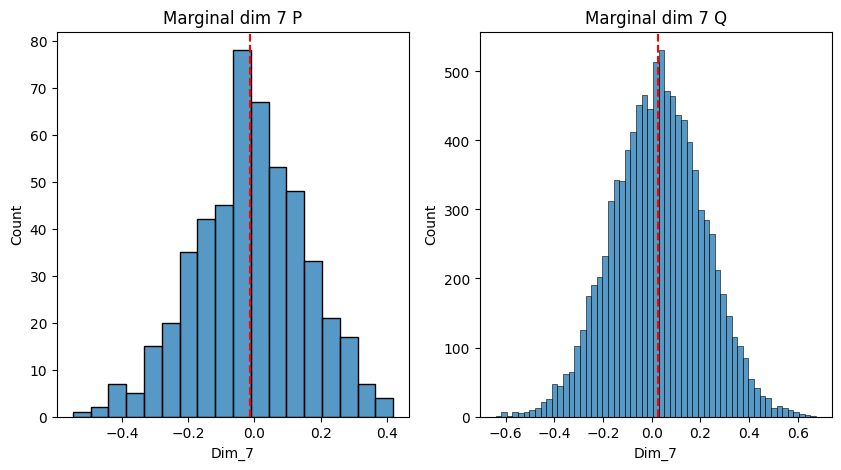

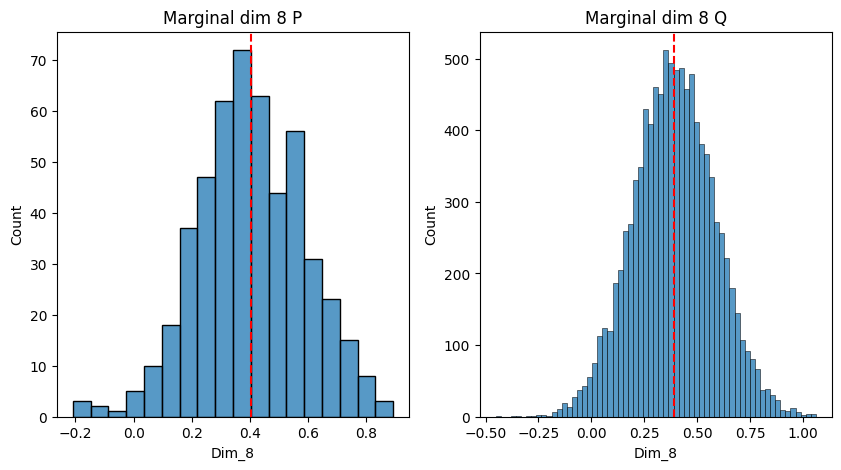

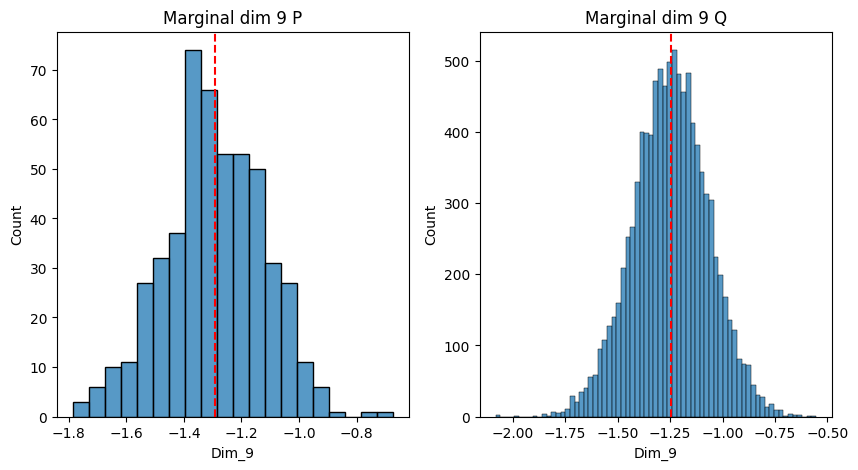

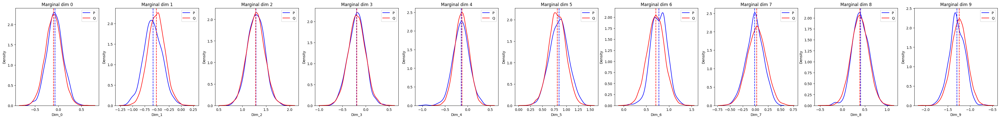

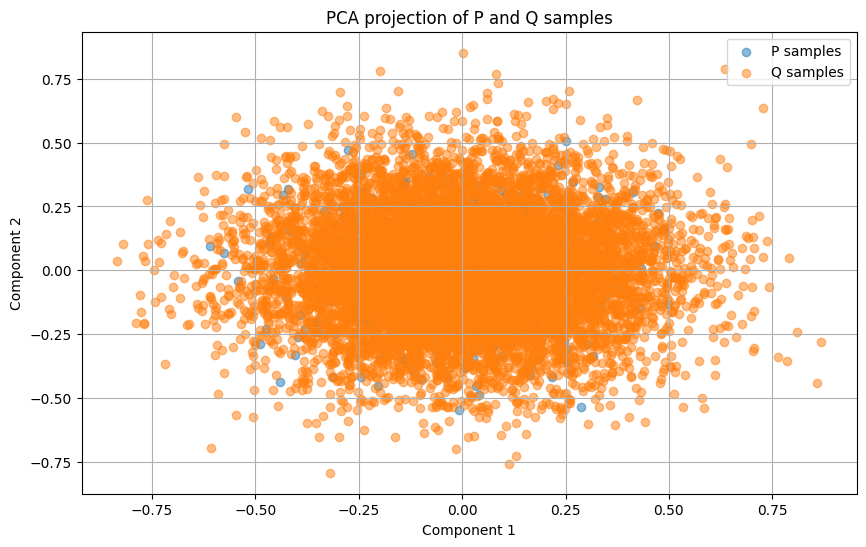

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


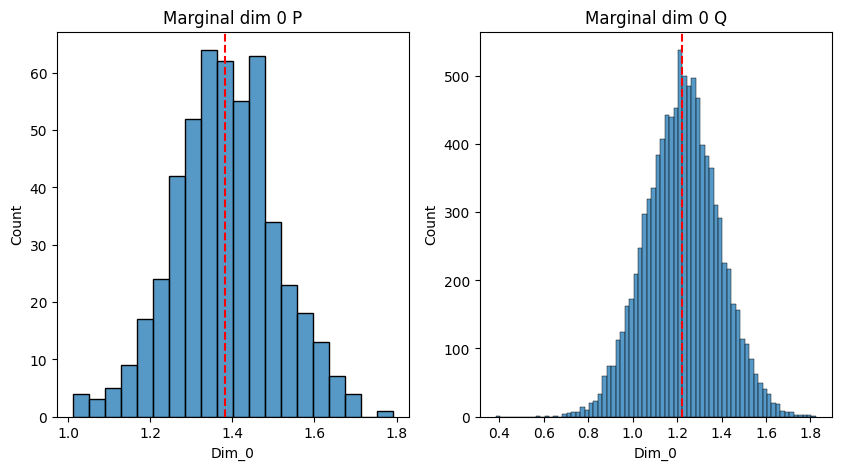

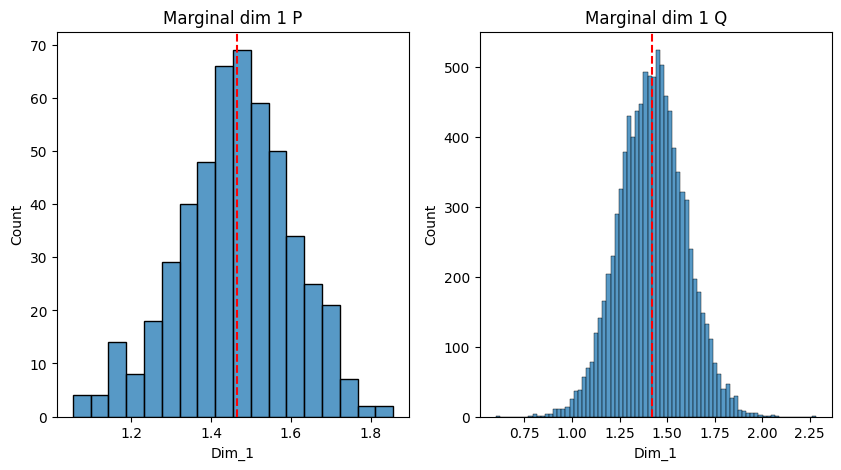

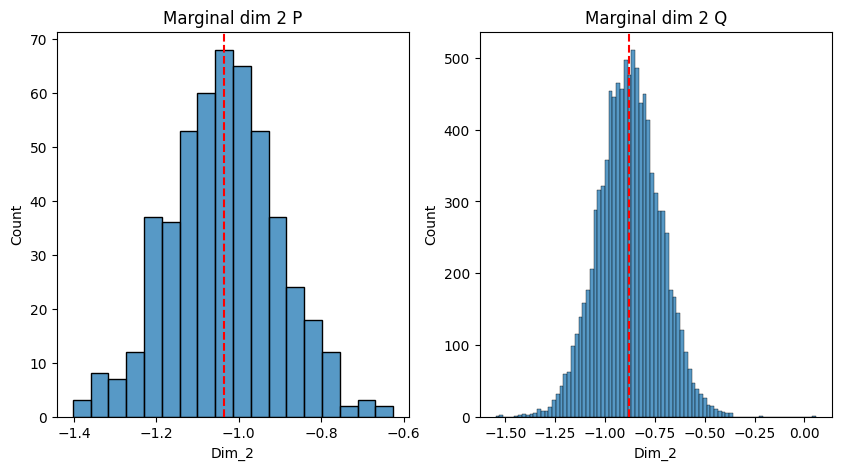

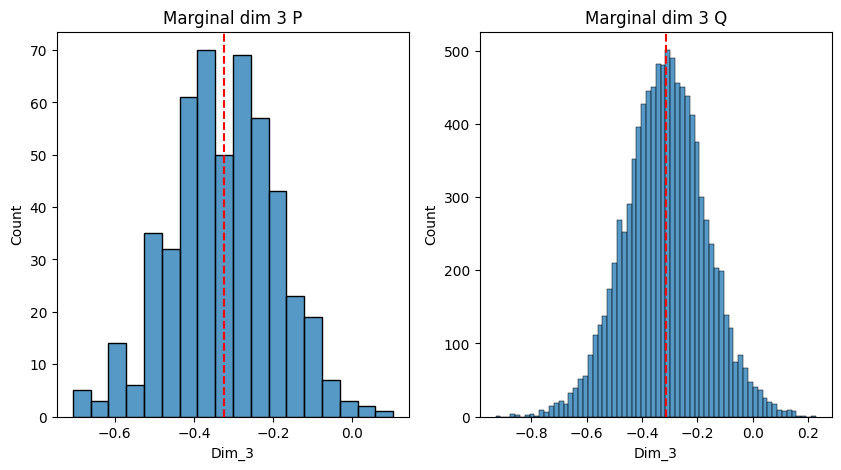

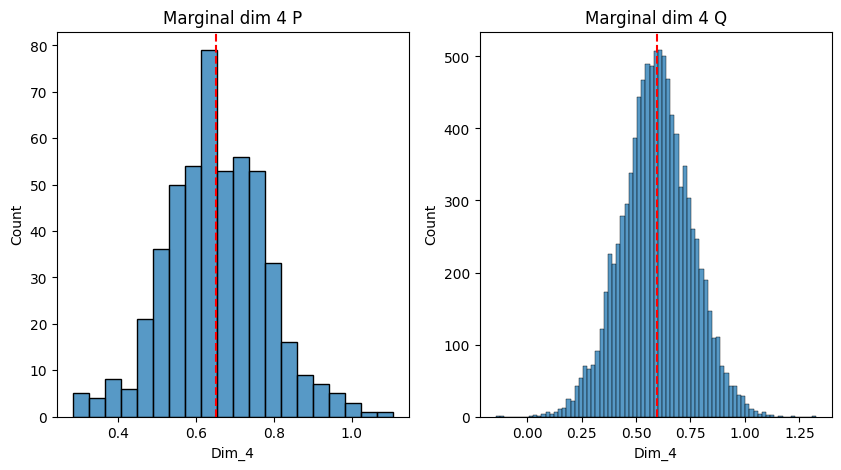

...

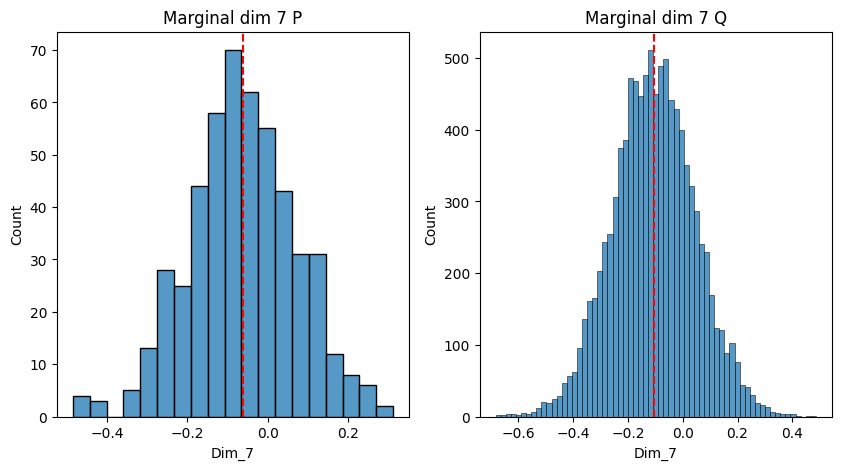

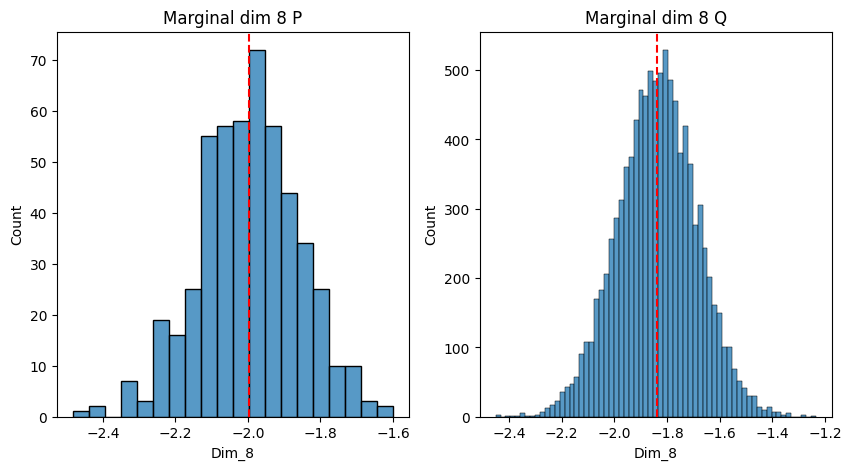

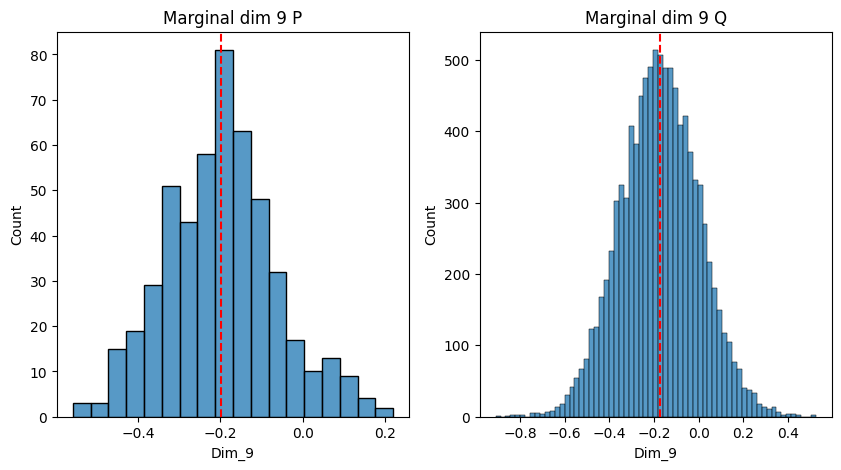

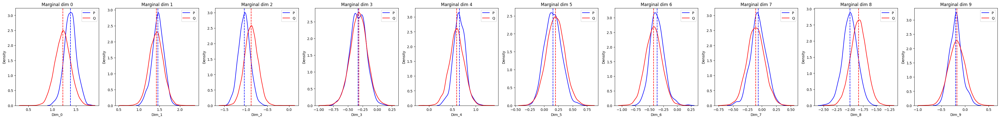

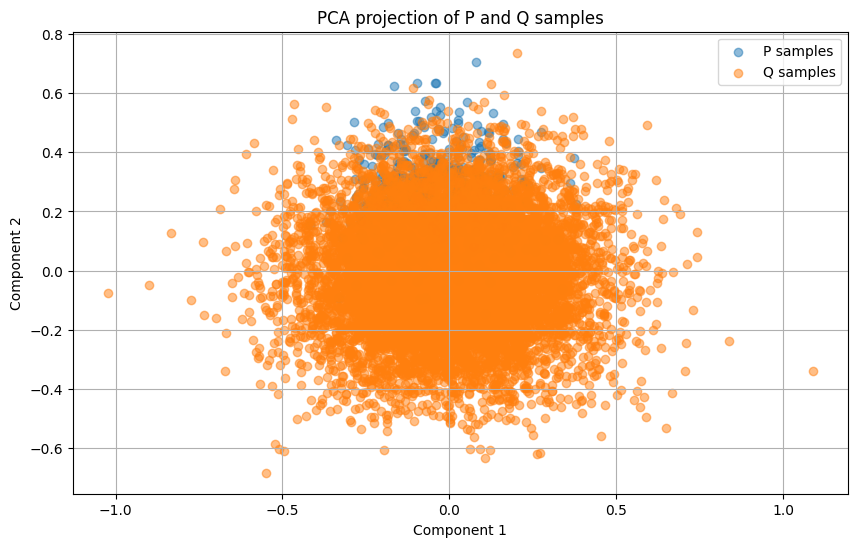

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


([{'CST': {'accuracy': 0.6910000000000001, 'roc_auc_score': 0.6910000000000001}, 'MMD': 0.2064952850341797, 'Wasserstein_distance with metric euclidean': 0.47703036665916443, 'mean_stats': {'absolute_mean_diff': tensor(0.0645), 'squared_mean_diff': tensor(0.0072), 'P_mean': tensor([-1.0702,  0.6784,  0.1767, -0.3724, -0.5991, -0.6415, -0.9654,  1.7546,
        -0.4825, -1.4948]), 'Q_mean': tensor([-0.9929,  0.6404,  0.1550, -0.3561, -0.6039, -0.7285, -0.9593,  1.5709,
        -0.3736, -1.3936])}, 'std_stats': {'absolute_std_diff': tensor(0.0087), 'squared_std_diff': tensor(9.4834e-05), 'P_std': tensor([0.1948, 0.2042, 0.1880, 0.1952, 0.1991, 0.2066, 0.1993, 0.2076, 0.1927,
        0.1962]), 'Q_std': tensor([0.2024, 0.1914, 0.1975, 0.2082, 0.1988, 0.2151, 0.1914, 0.2145, 0.1885,
        0.2126])}, 'q_025_stats': {'absolute_q_025_diff': tensor(0.0618), 'squared_q_025_diff': tensor(0.0086), 'P_q_025': tensor([-1.4595,  0.2920, -0.1659, -0.7585, -0.9997, -1.0596, -1.3264,  1.3873,
        

In [ ]:
r_full_model_gt = comparison_model_full_model_gt.compare_sample_metrics_batch(test_batch["x"][:5].cpu(), test_batch["y"][:5].cpu())
print(r_full_model_gt)


In [ ]:
print_wasserstein_distances(r_full_model_gt)

[0.47703036665916443, 0.38064688444137573, 0.4308997392654419, 0.3781178593635559, 0.42052844166755676]
0.41744465827941896


In [ ]:
hmc_sampler = Hamiltionian_MC(pprogram = pprogram1_y, n_warmup=400, n_samples=400)

comparison_model = ModelComparison(
    modelposterior=full_model,
    comparison_model=hmc_sampler,
    save_path = trainer.save_path
)


Sample: 100%|██████████| 800/800 [00:58, 13.68it/s, step size=1.79e-01, acc. prob=0.941]


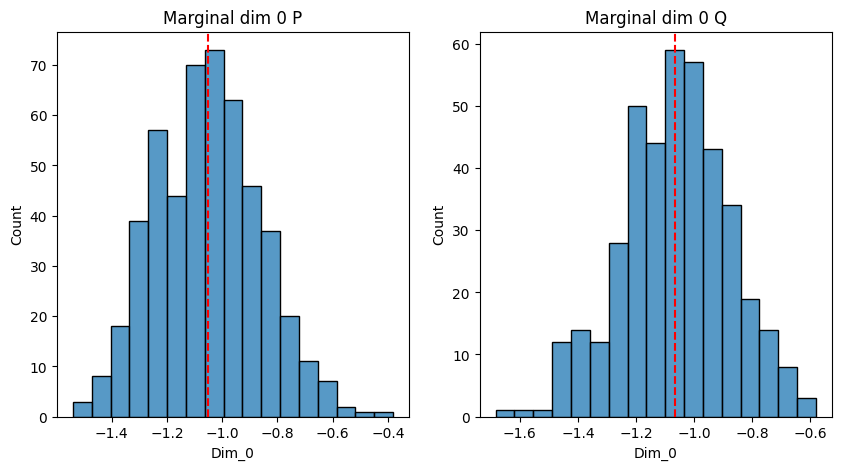

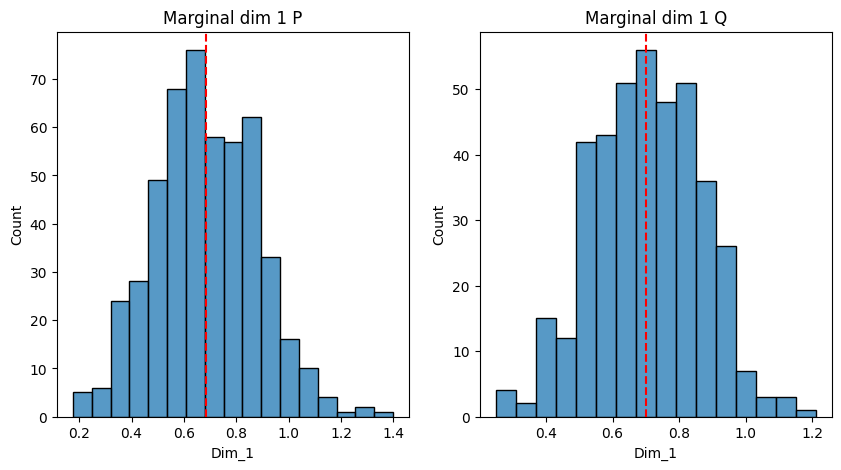

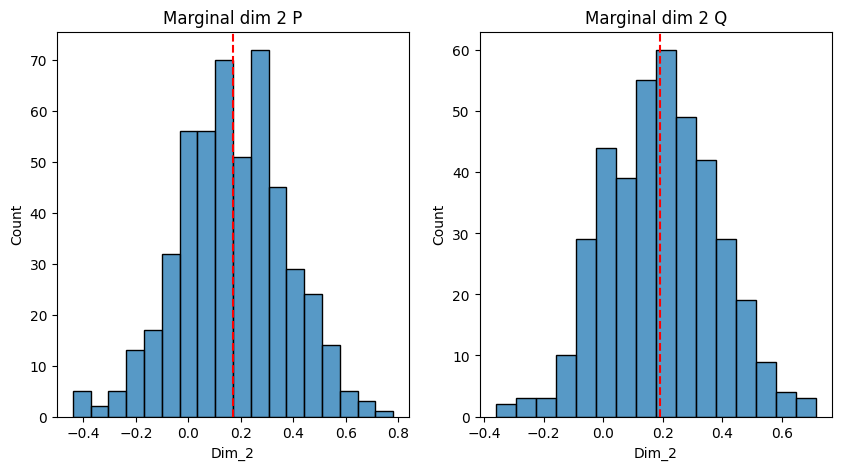

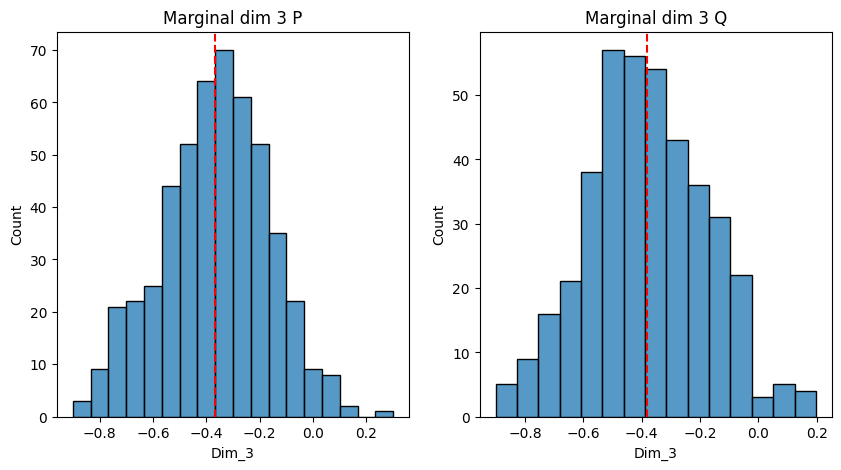

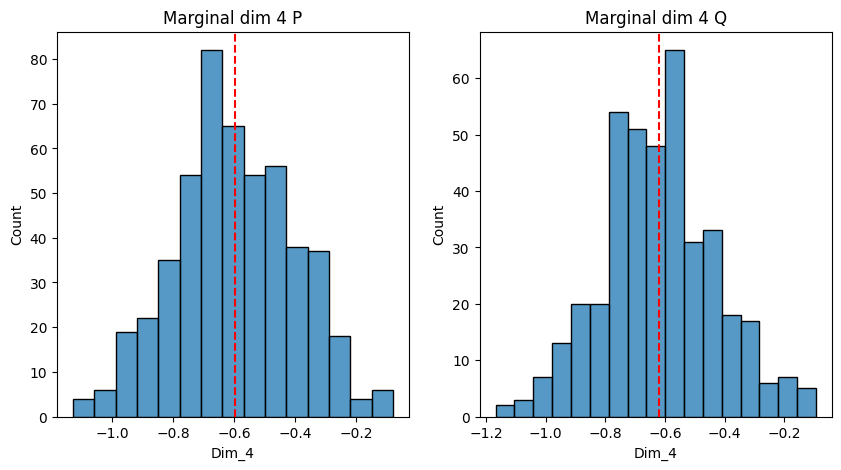

...

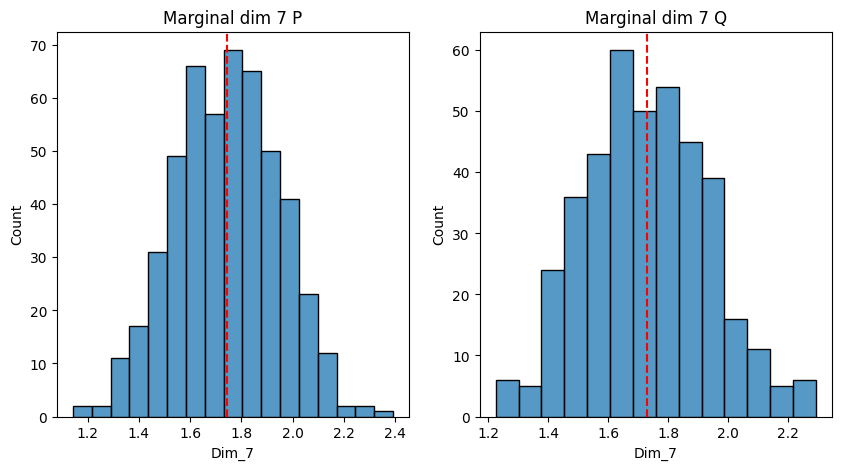

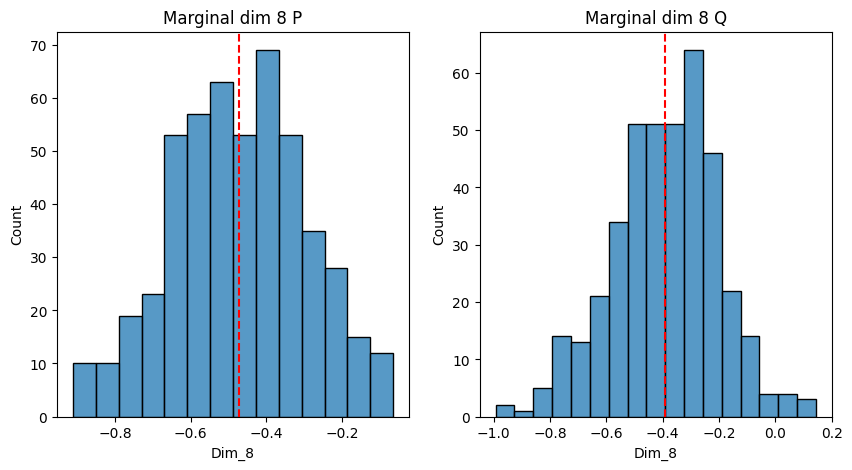

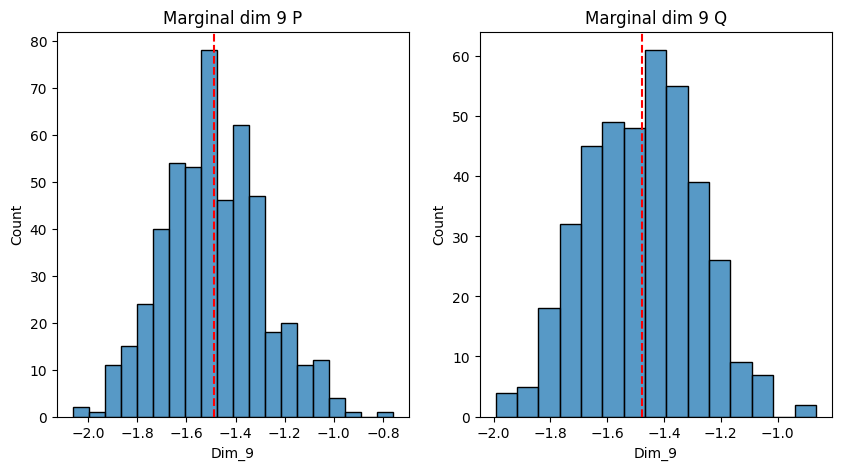

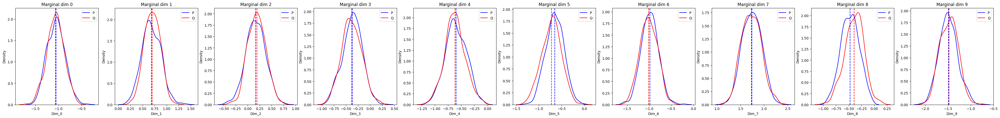

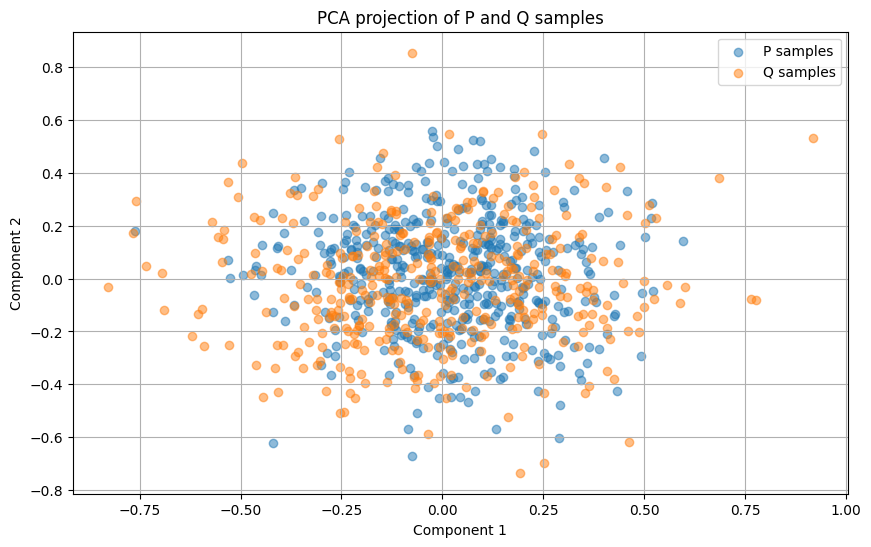

Sample: 100%|██████████| 800/800 [00:52, 15.27it/s, step size=2.01e-01, acc. prob=0.917]


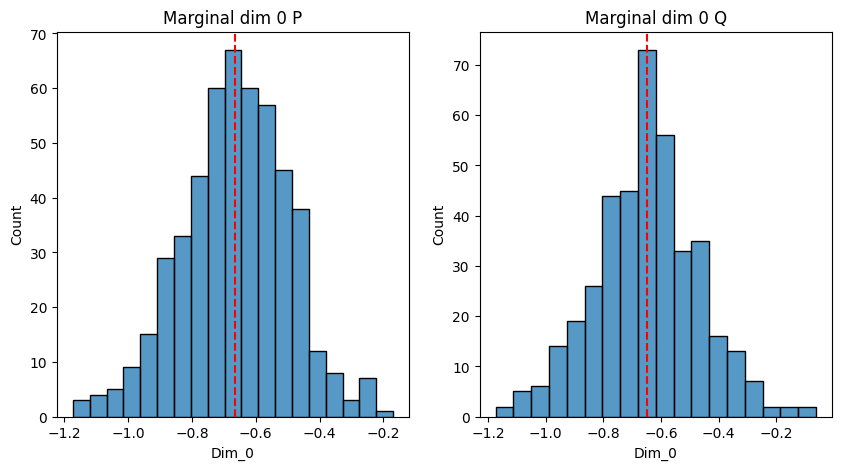

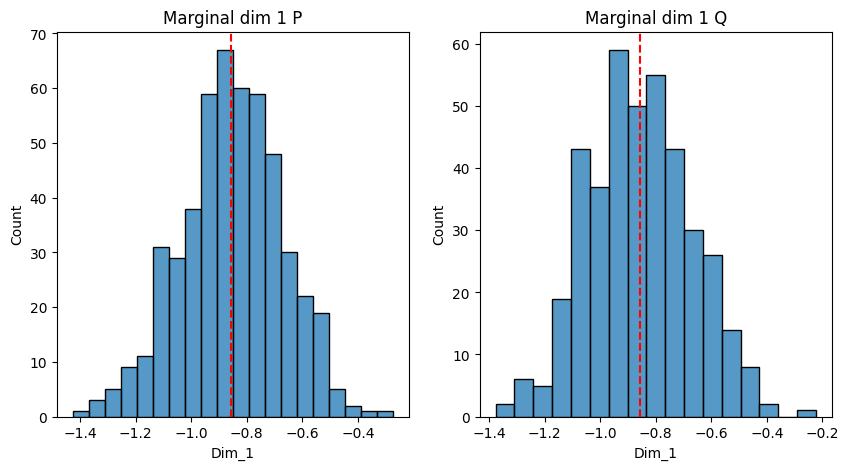

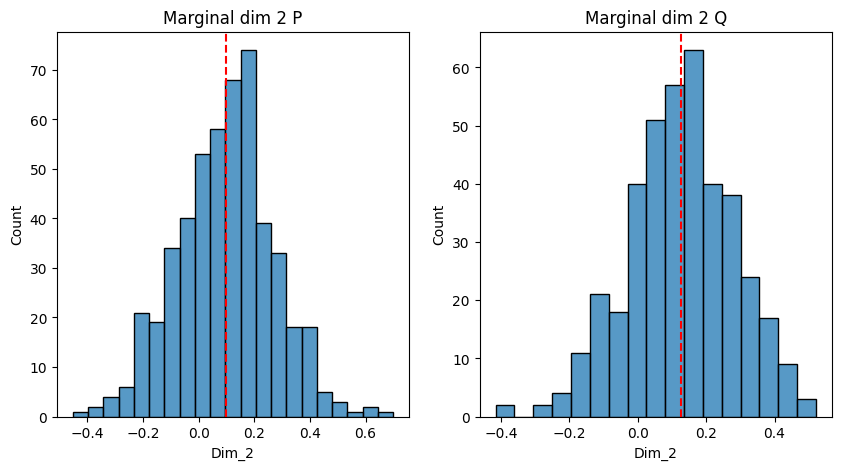

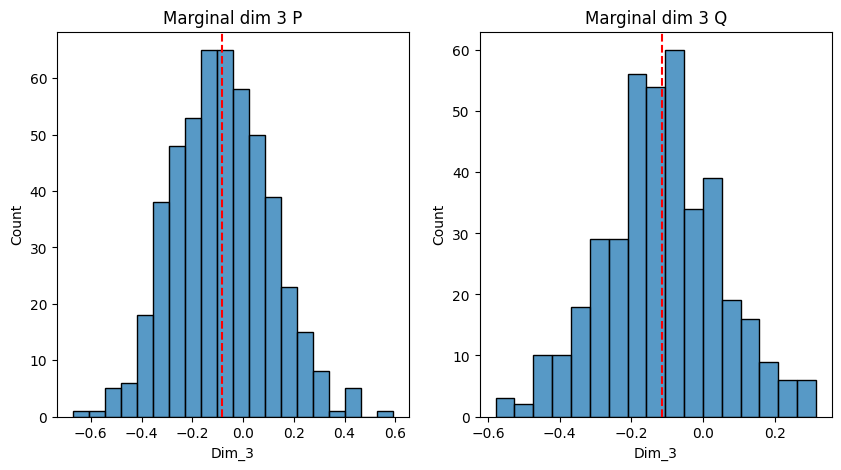

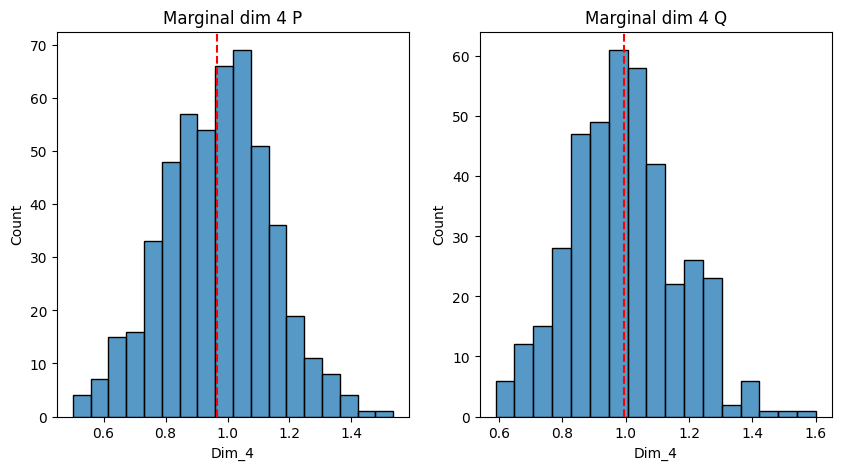

...

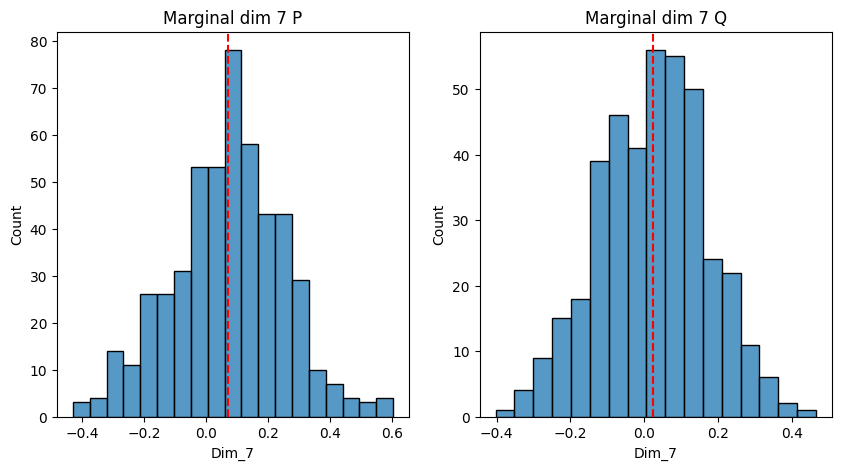

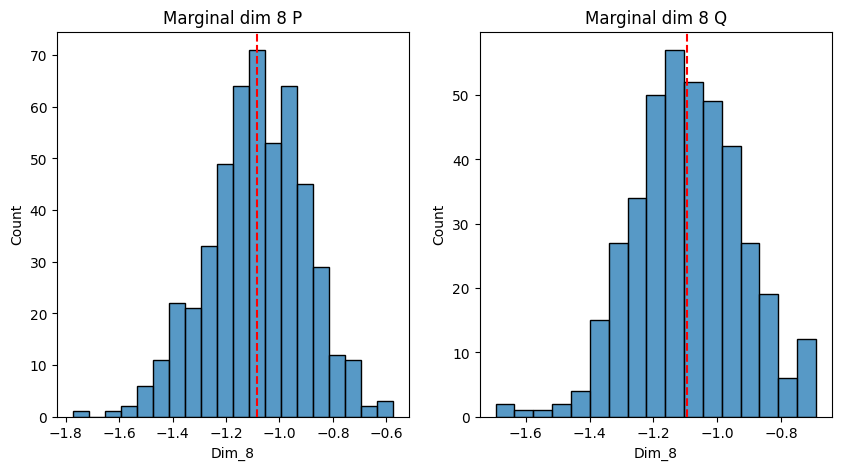

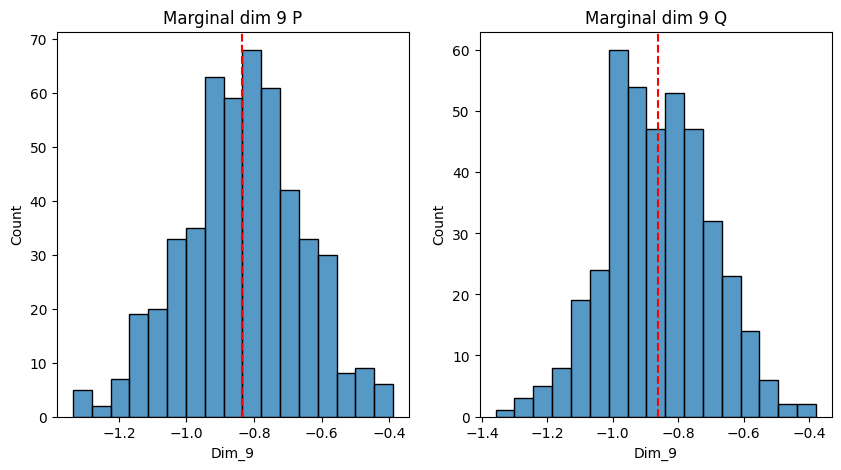

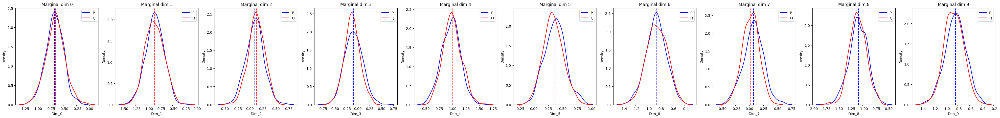

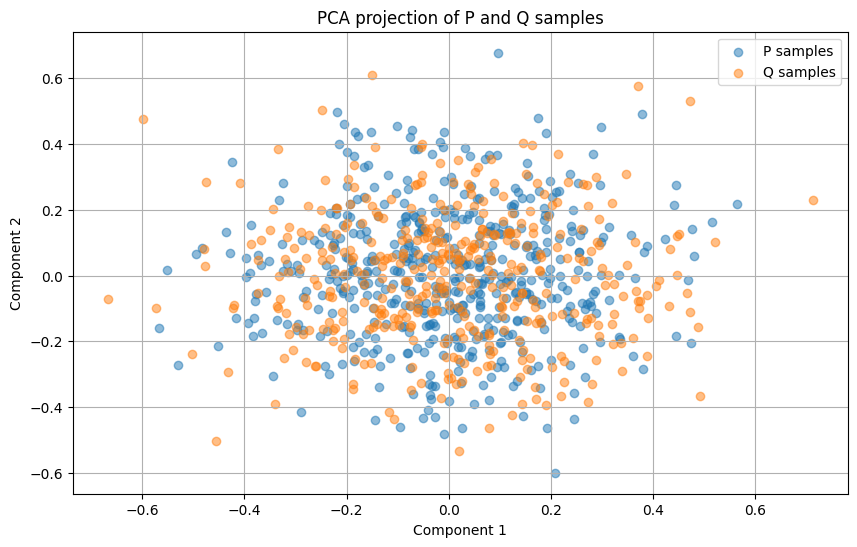

Sample: 100%|██████████| 800/800 [00:55, 14.35it/s, step size=1.88e-01, acc. prob=0.944]


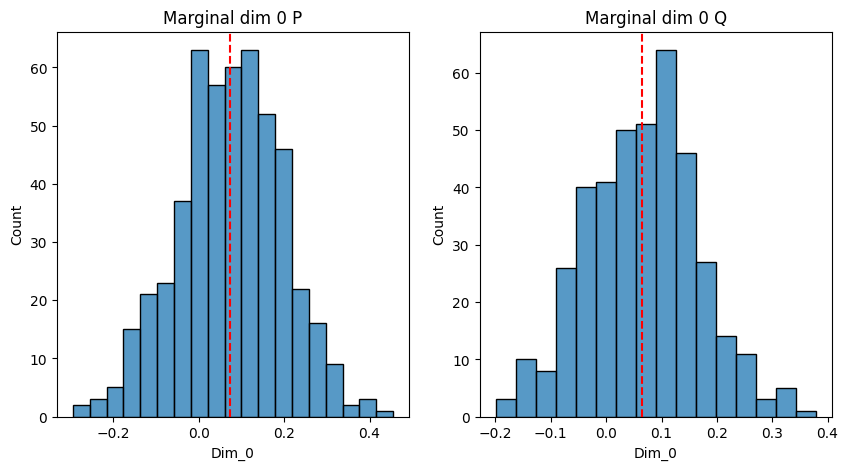

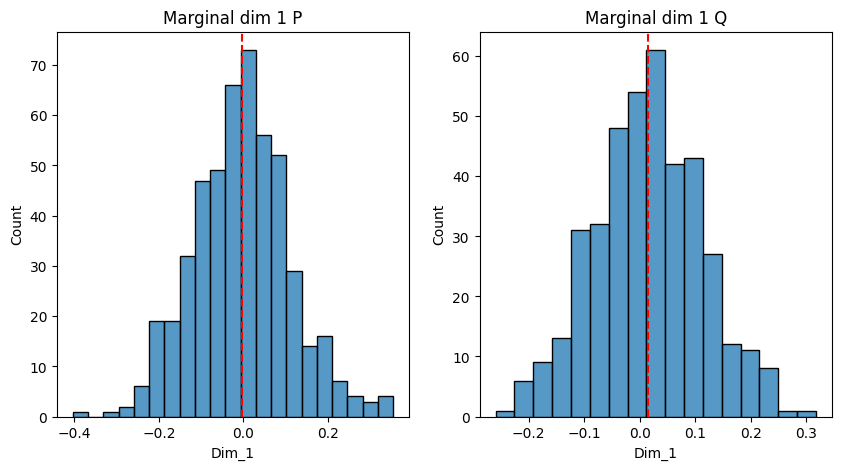

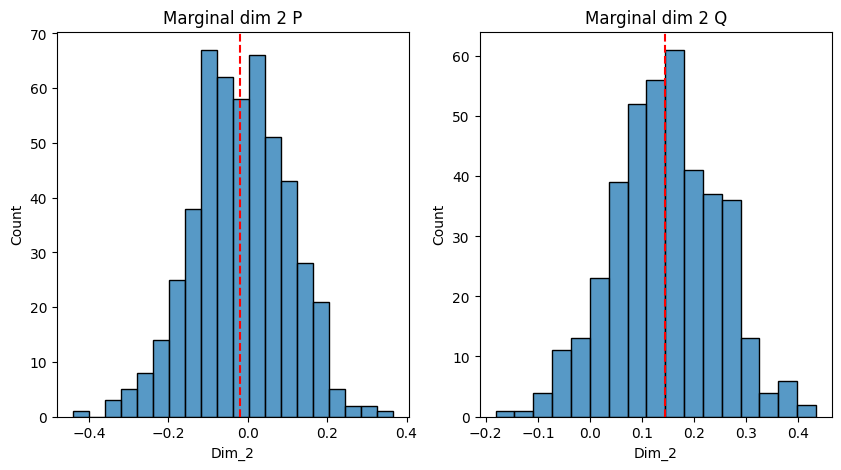

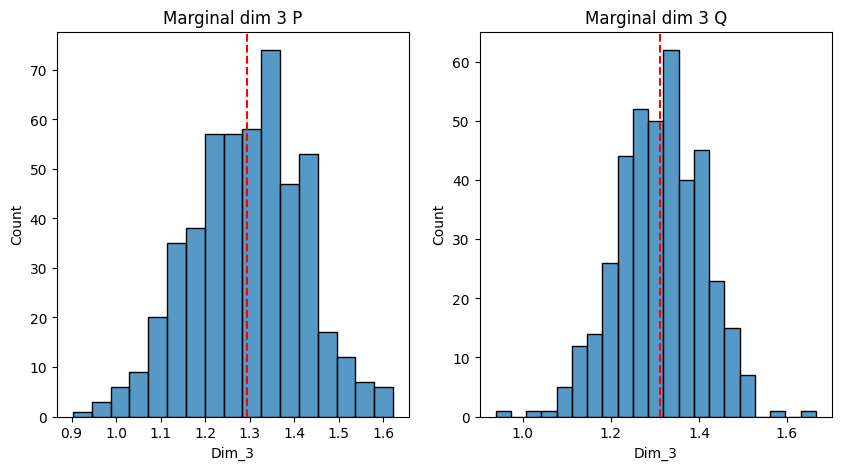

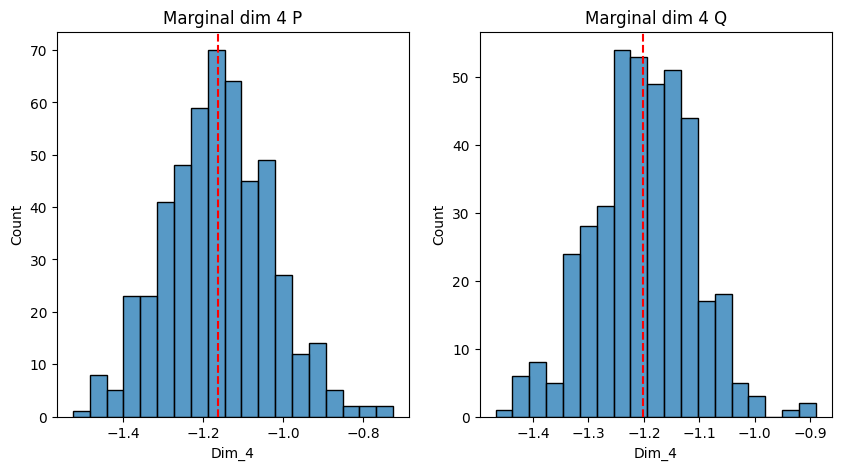

...

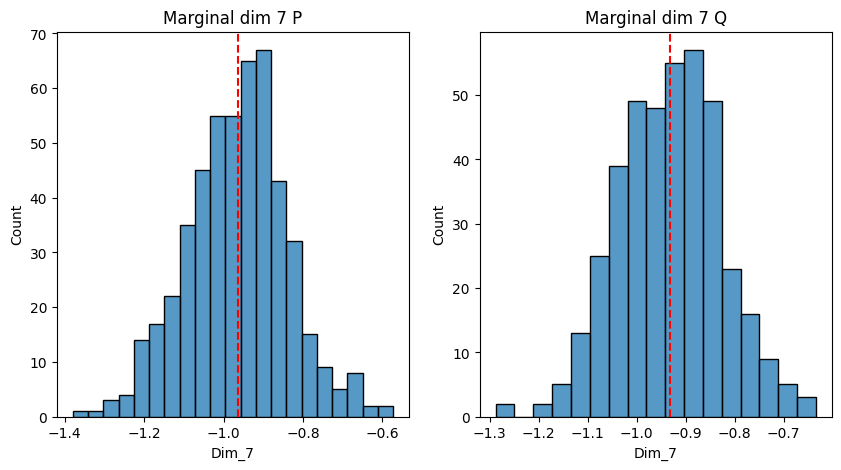

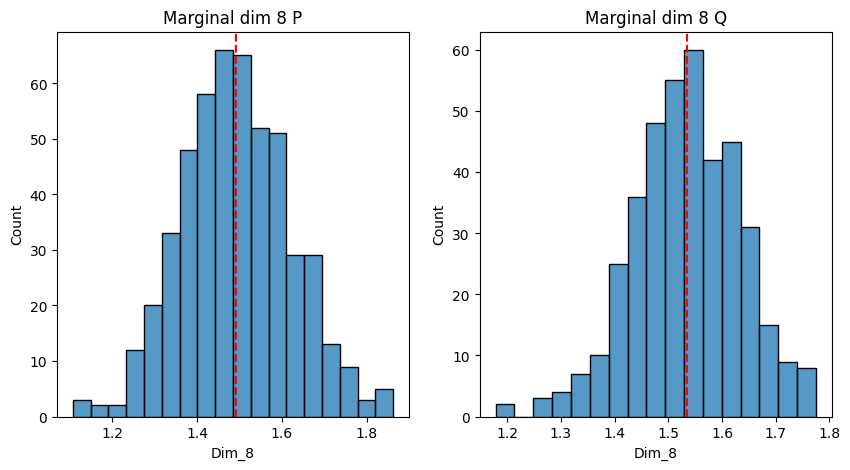

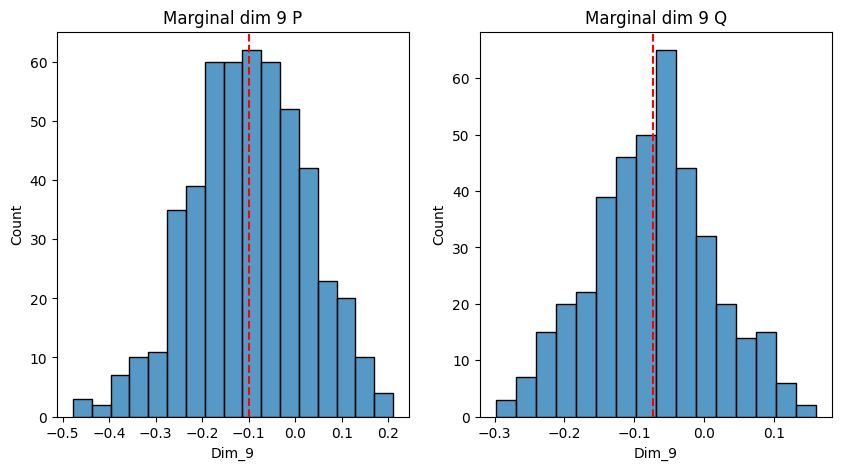

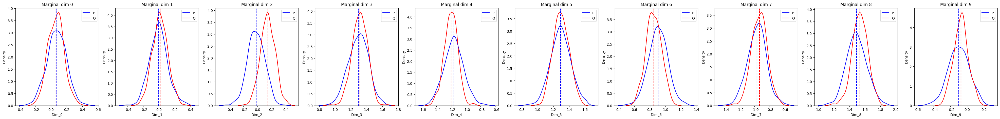

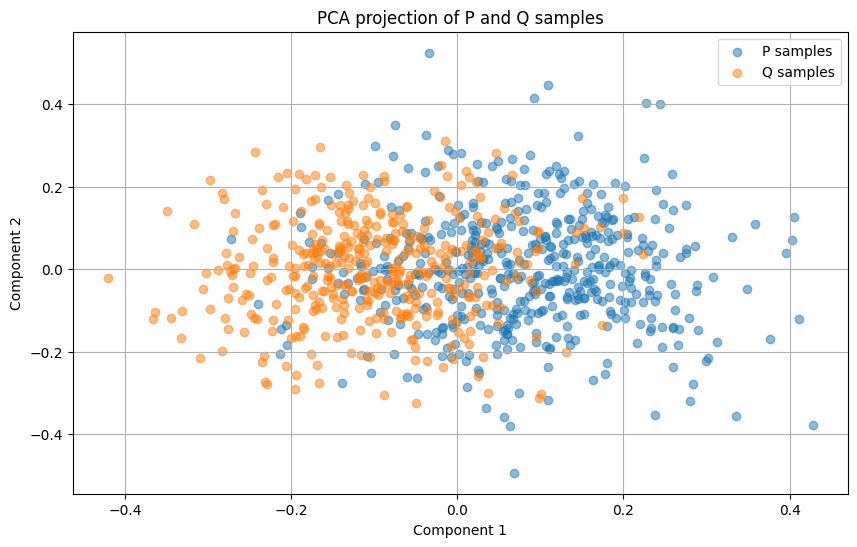

Sample: 100%|██████████| 800/800 [00:57, 13.82it/s, step size=1.74e-01, acc. prob=0.943]


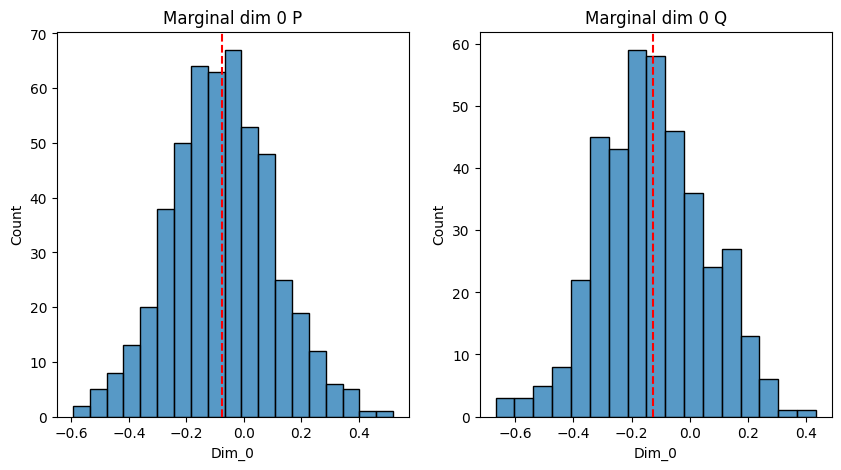

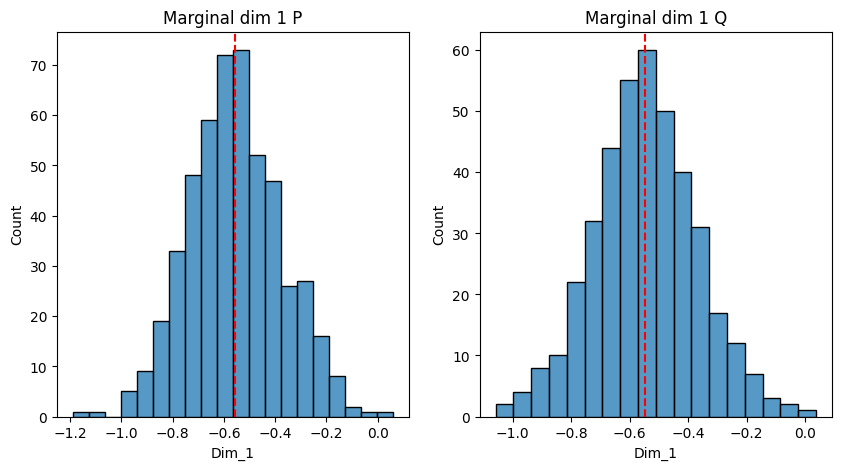

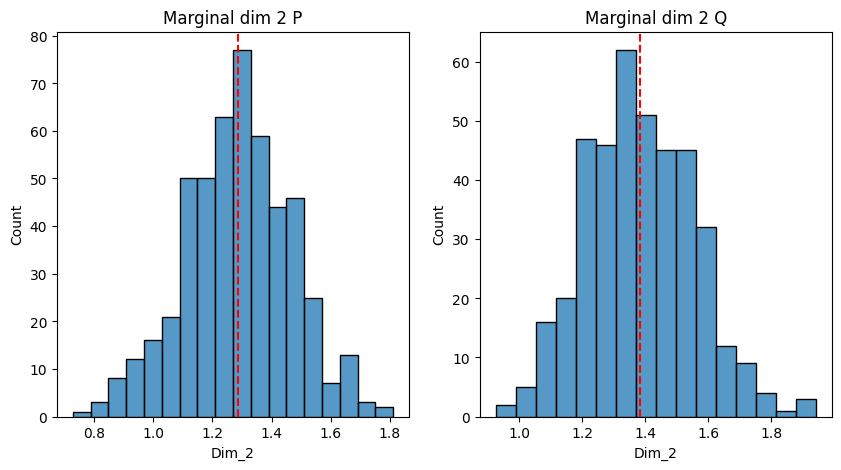

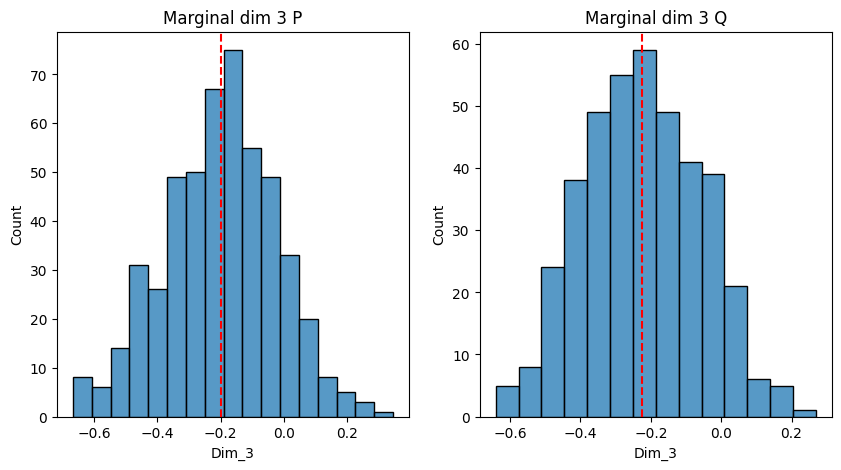

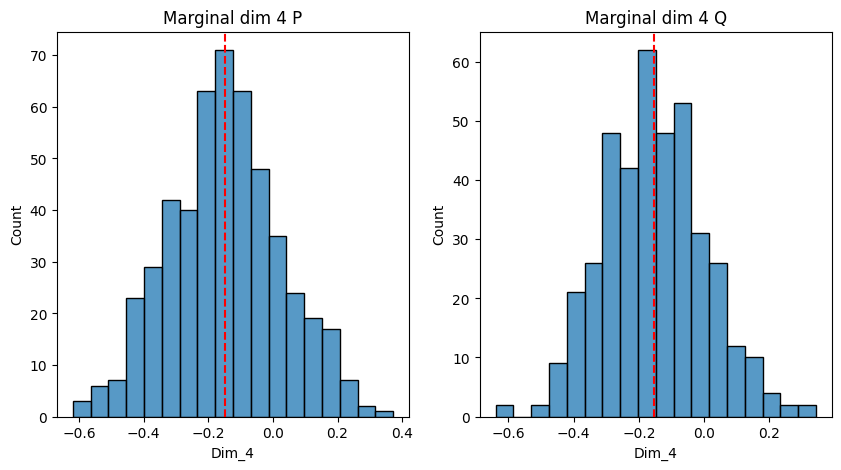

...

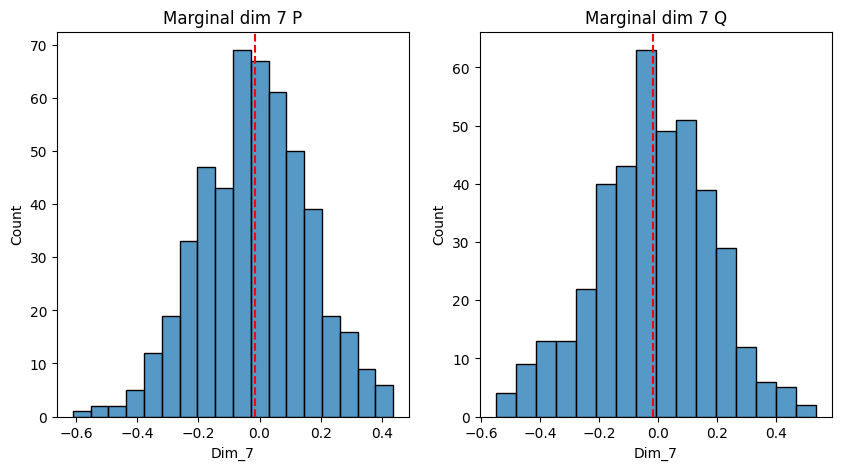

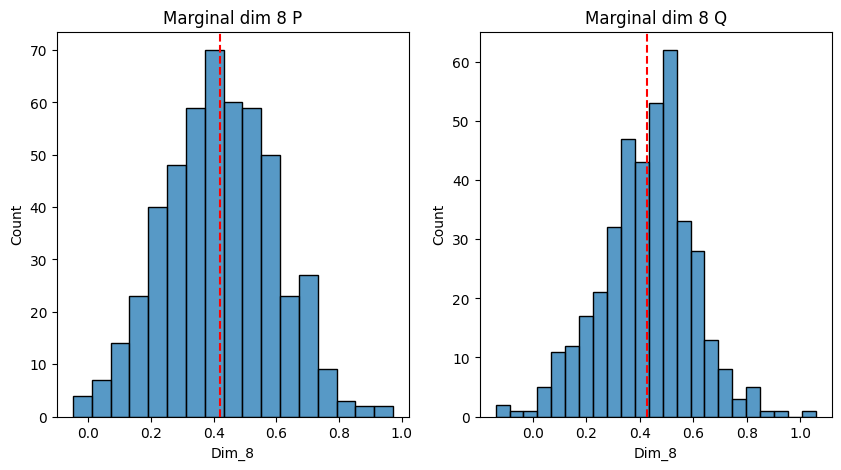

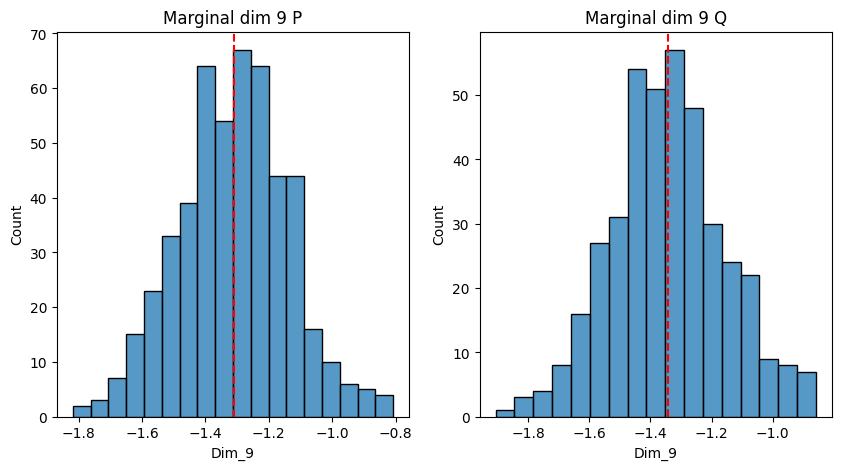

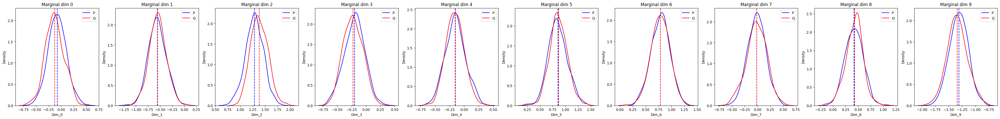

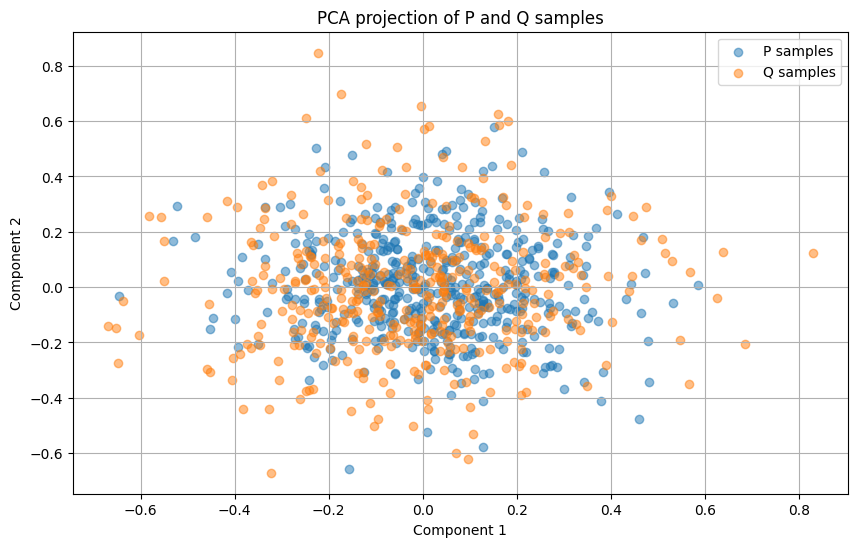

Sample: 100%|██████████| 800/800 [00:58, 13.65it/s, step size=1.85e-01, acc. prob=0.929]


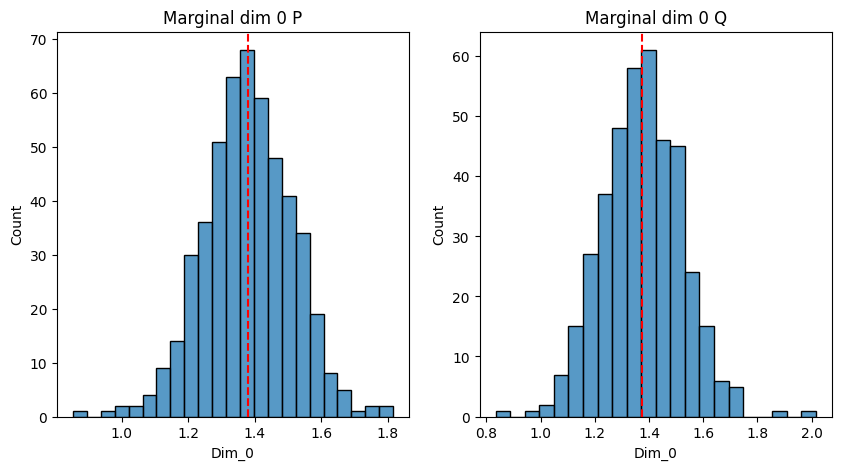

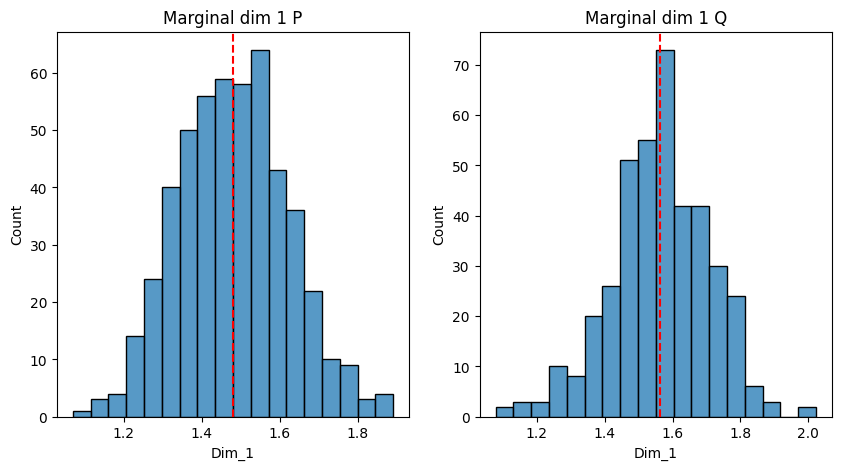

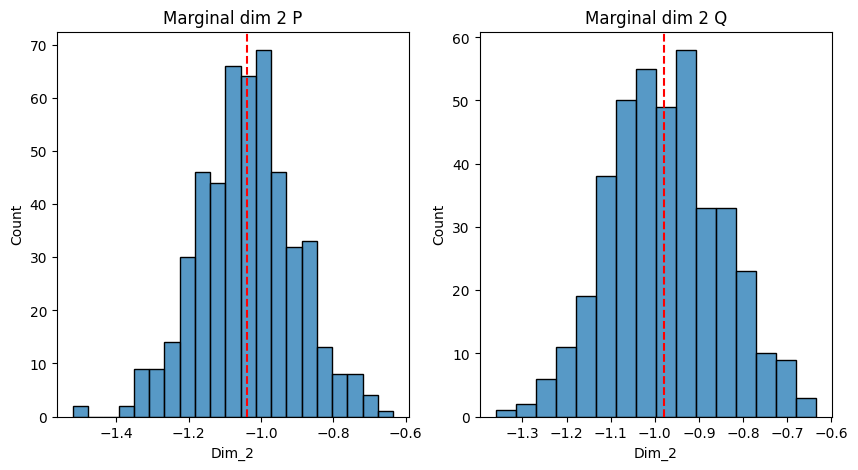

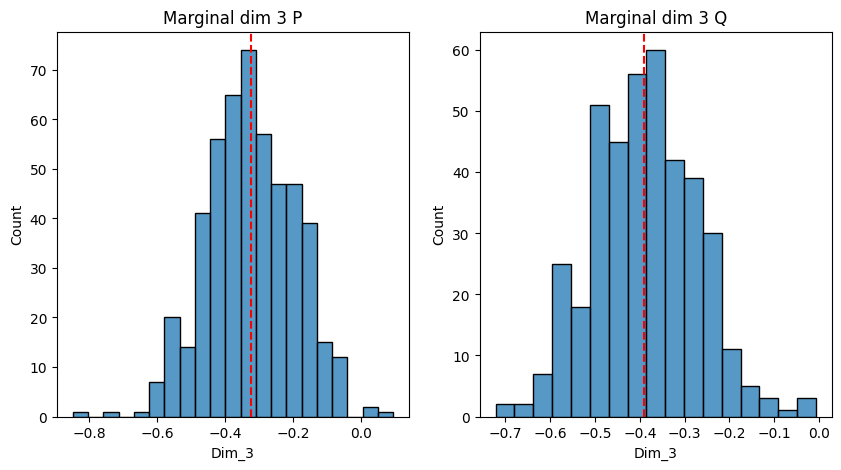

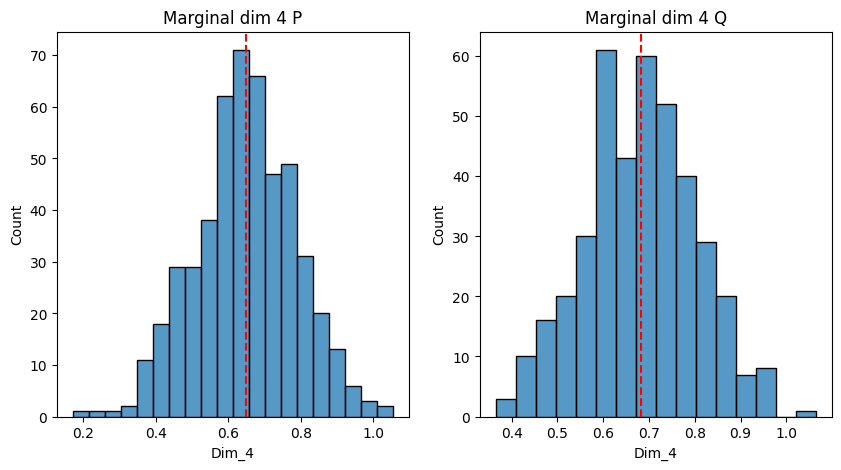

...

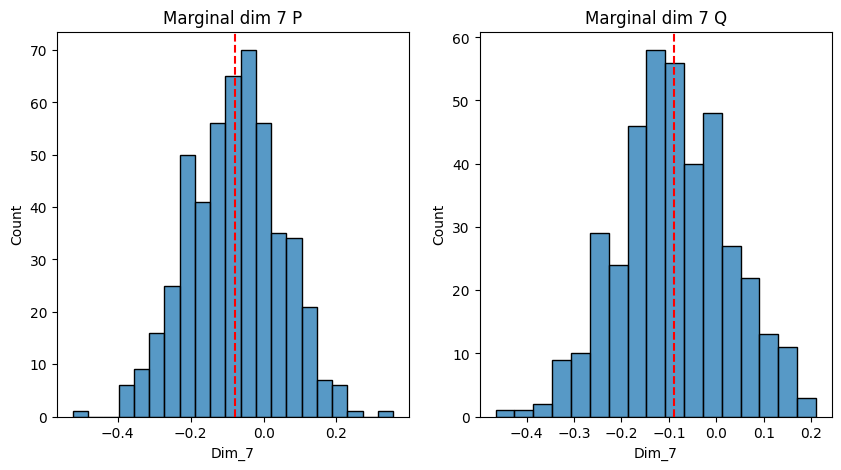

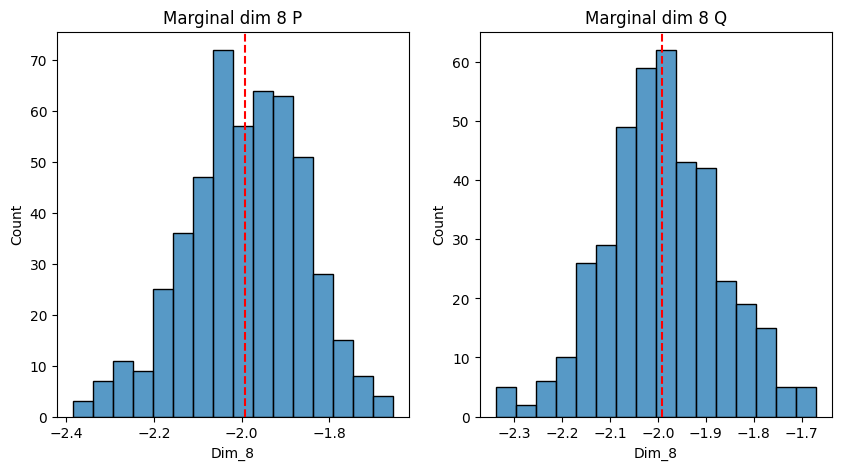

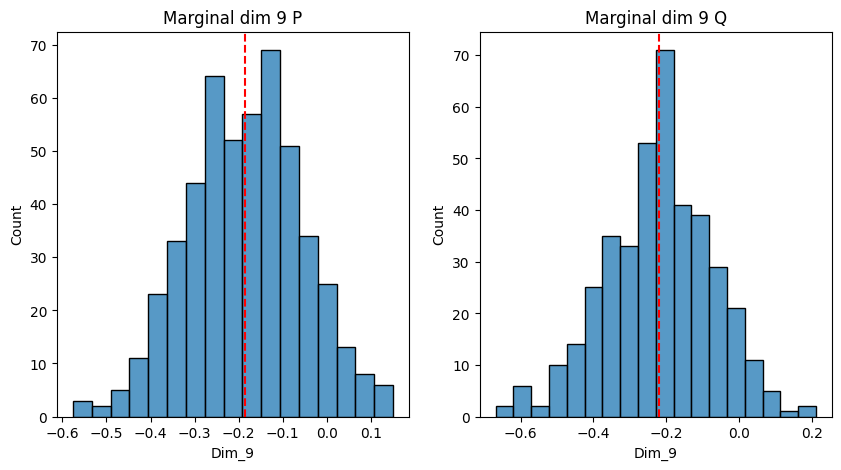

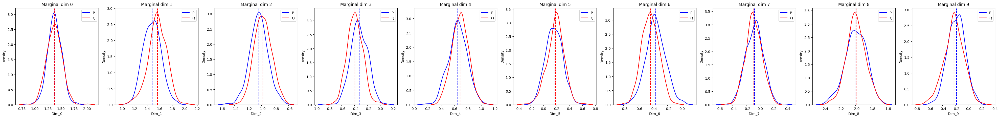

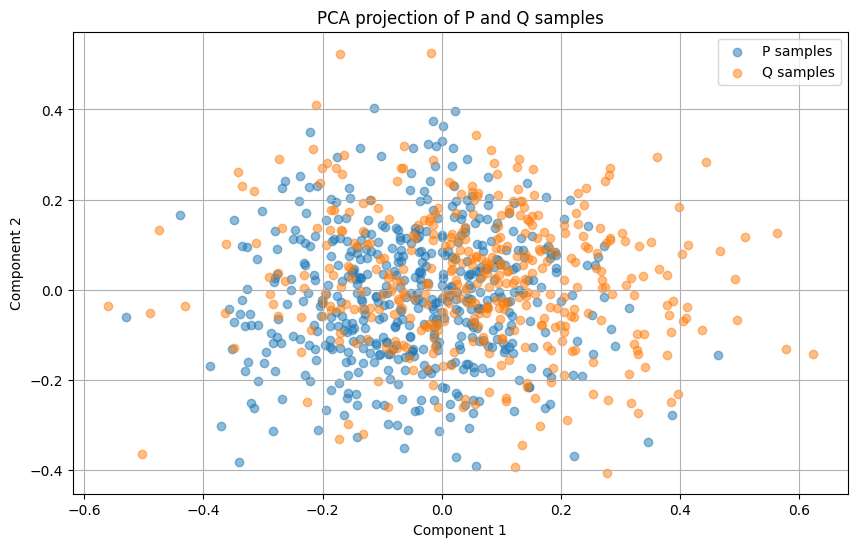

In [ ]:
r_hmc = comparison_model.compare_sample_metrics_batch(test_batch["x"][:5].cpu(), test_batch["y"][:5].cpu())

In [ ]:
print_wasserstein_distances(r_hmc)

[0.43766871094703674, 0.37766504287719727, 0.31306543946266174, 0.3959803879261017, 0.3191247880458832]
0.36870087385177613


In [ ]:
comparison_model_gt_hmc =  CompareComparisonModels(
    comparison_model_1=analytical_solution,
    comparison_model_2=hmc_sampler,
    n_samples_comparison_model_1=10_000,
    save_path = trainer.save_path
)


Sample: 100%|██████████| 800/800 [01:00, 13.25it/s, step size=1.63e-01, acc. prob=0.944]


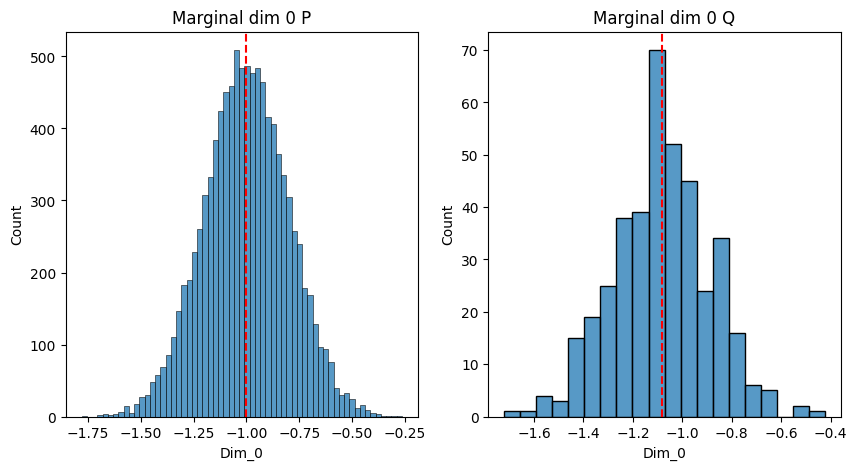

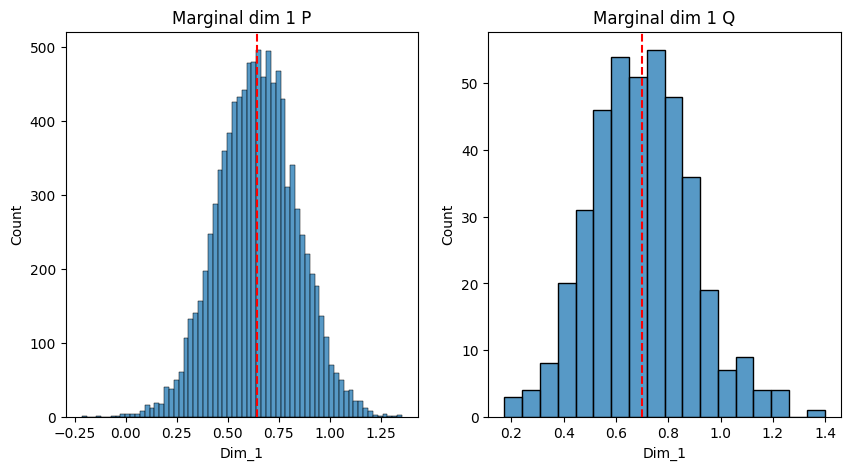

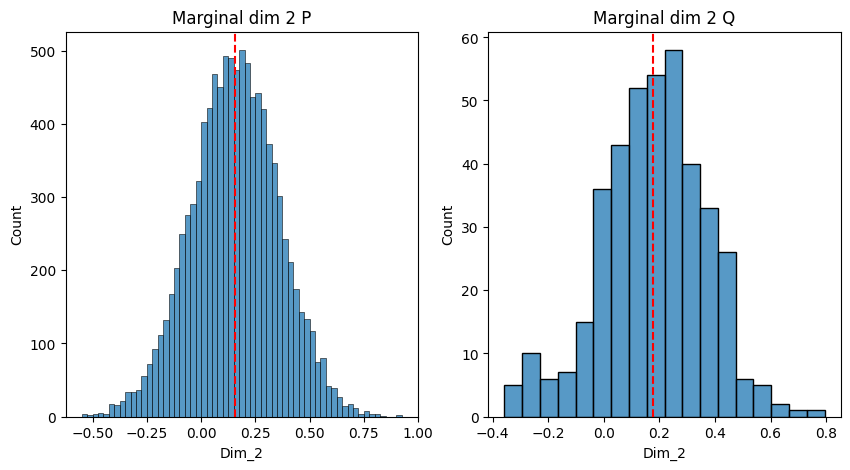

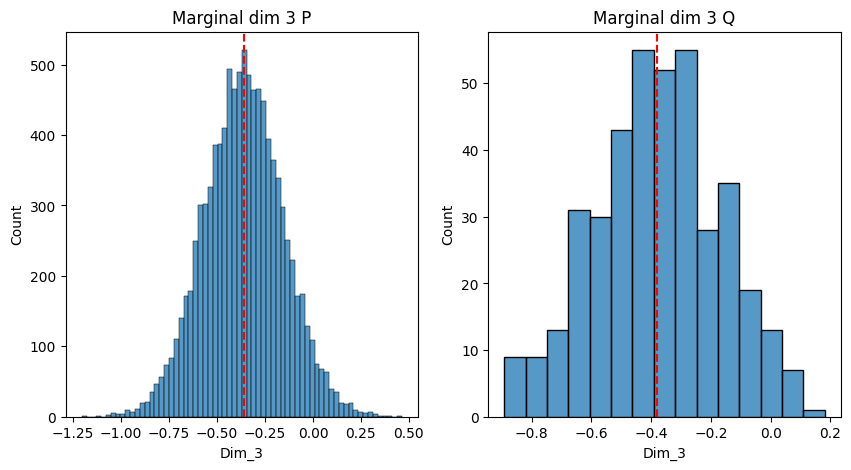

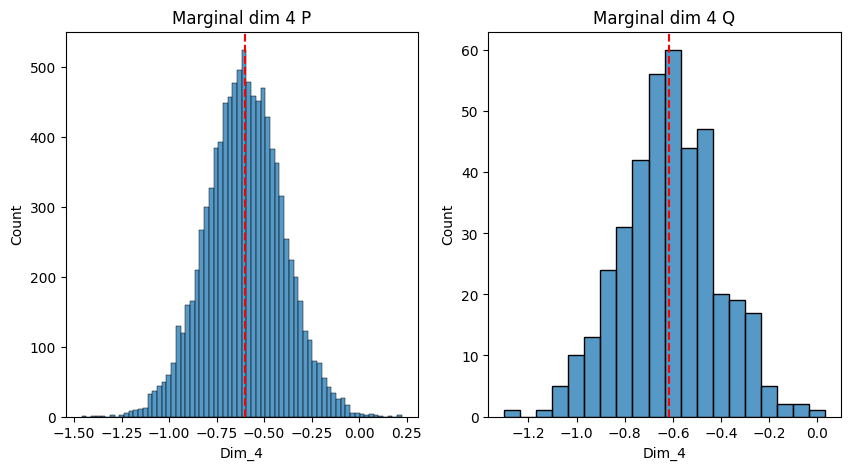

...

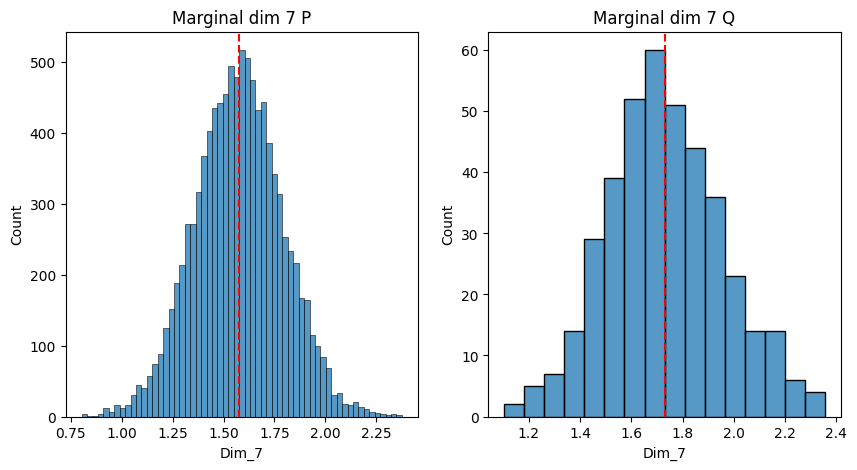

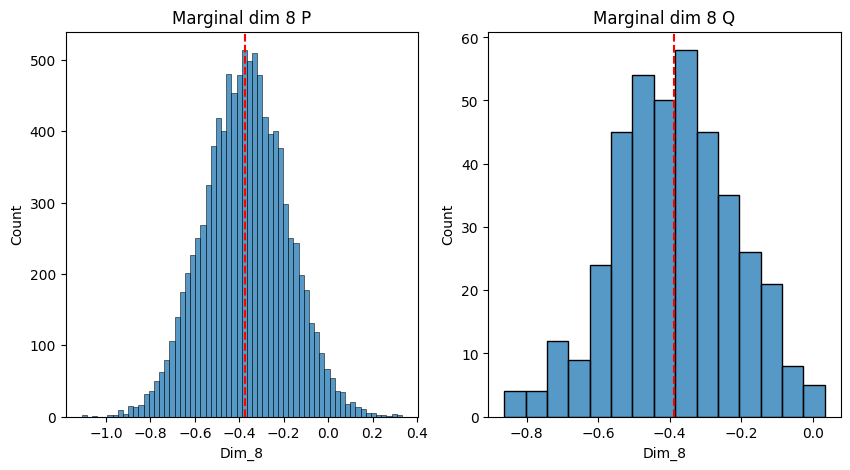

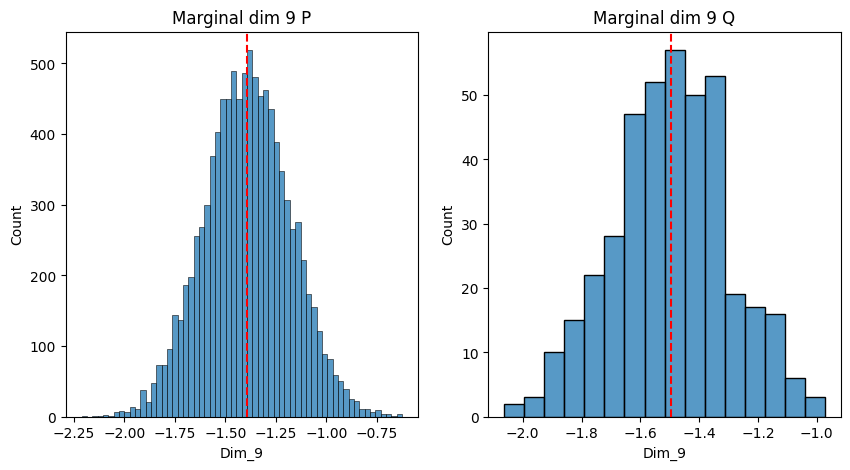

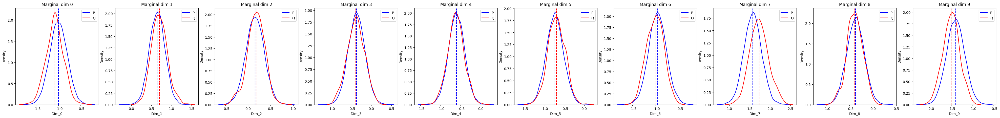

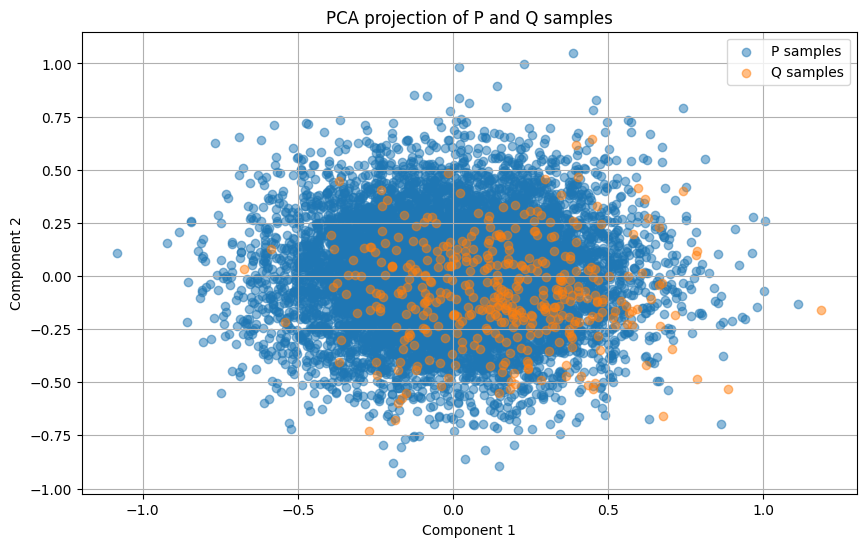

Sample: 100%|██████████| 800/800 [00:48, 16.56it/s, step size=2.13e-01, acc. prob=0.918]


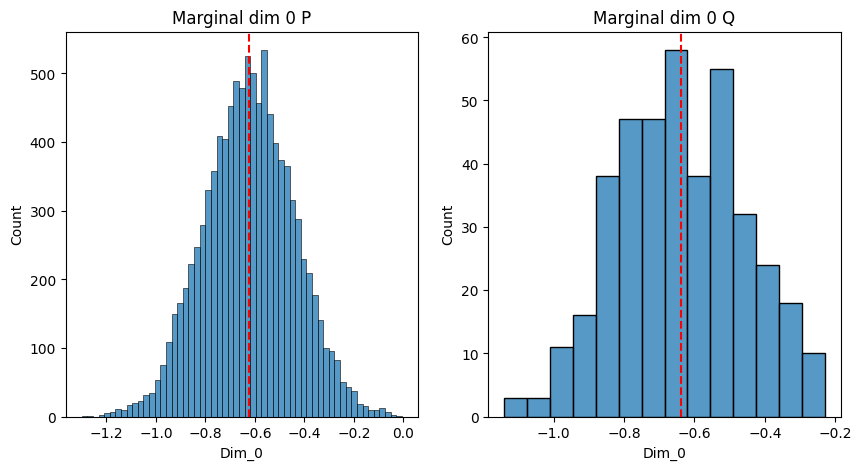

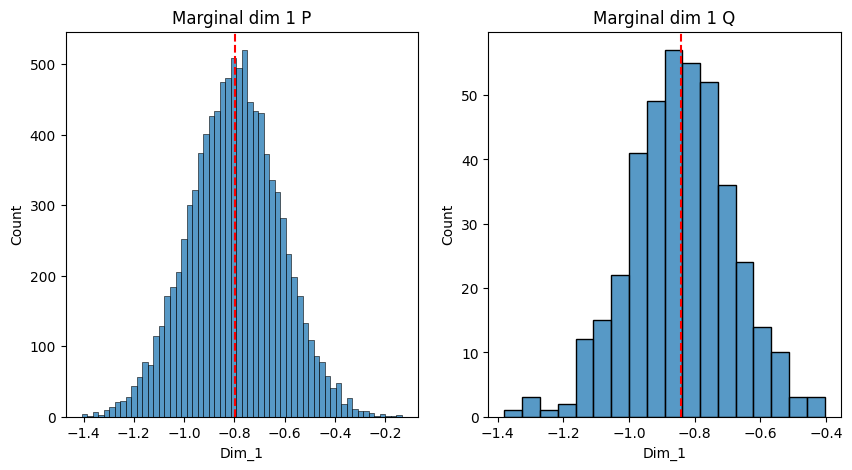

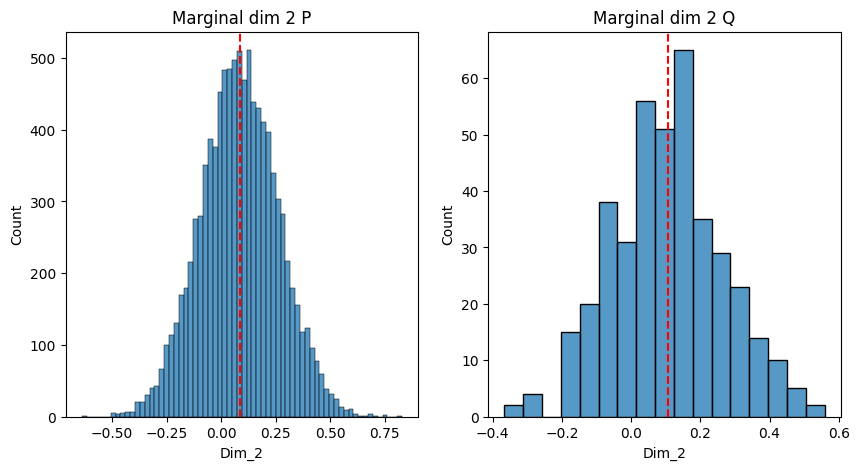

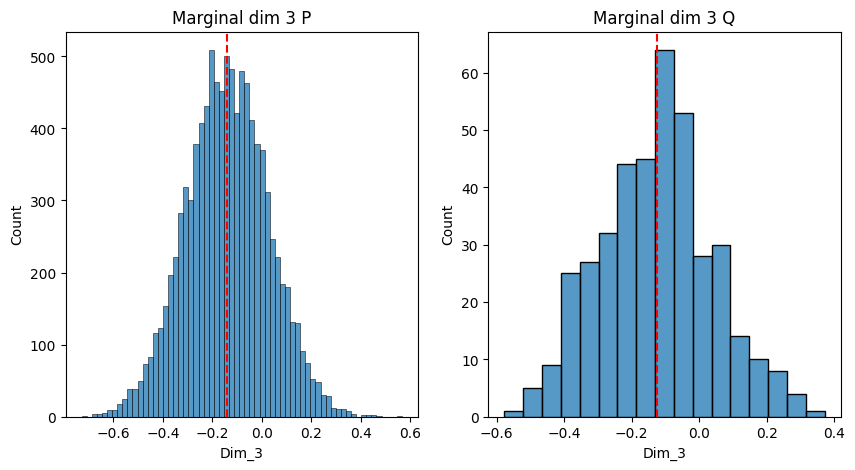

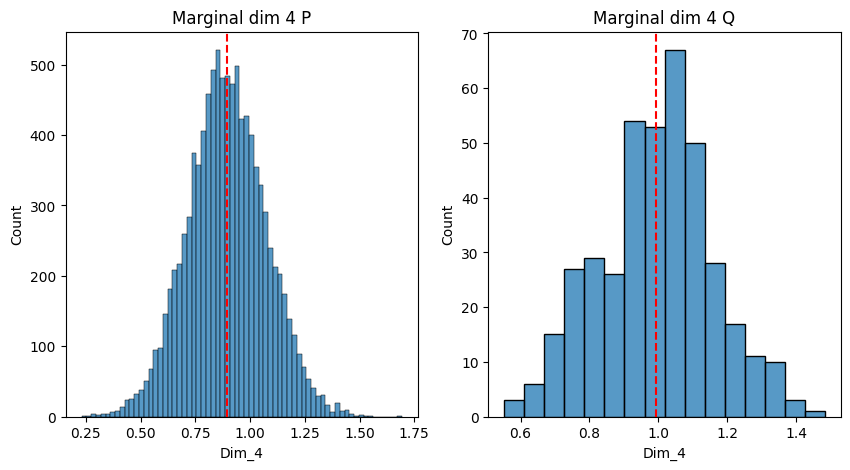

...

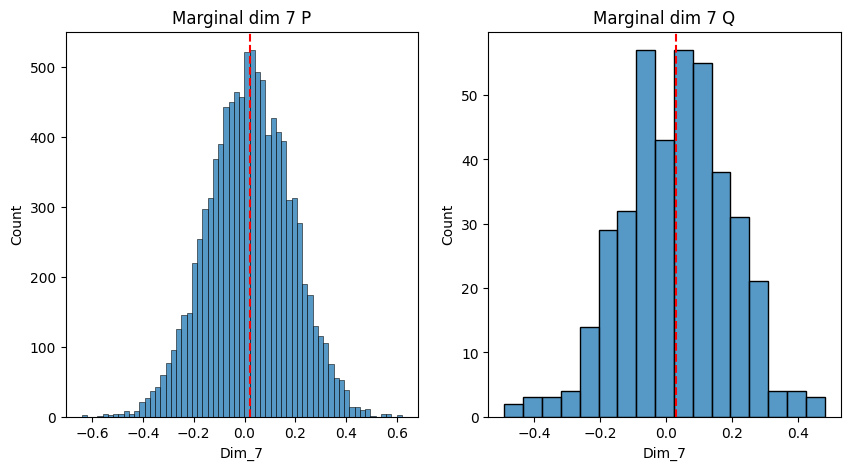

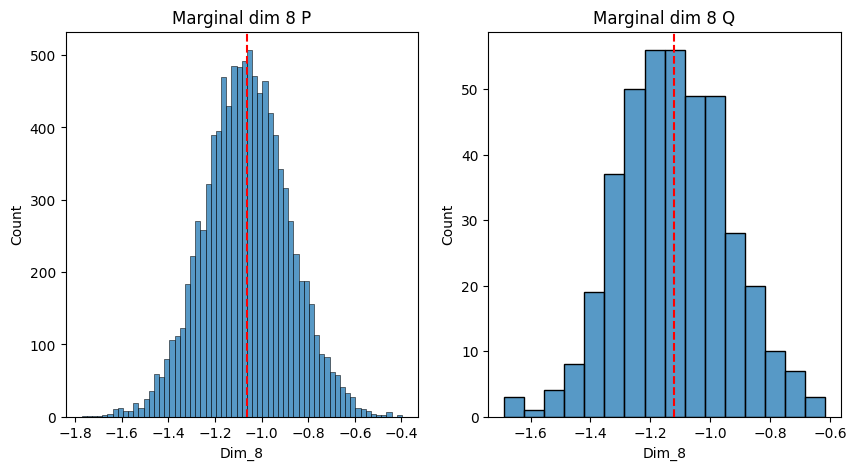

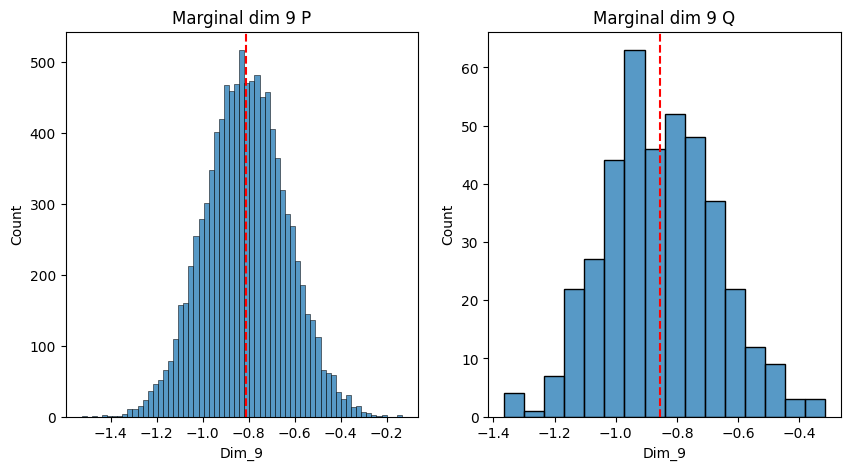

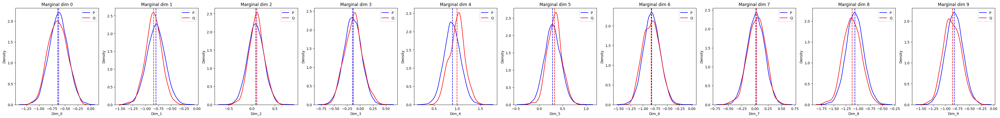

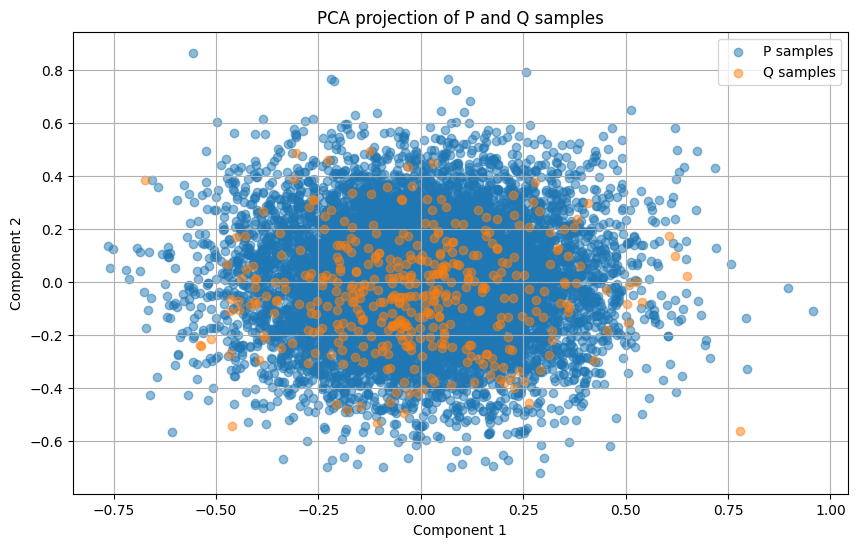

Sample: 100%|██████████| 800/800 [00:57, 13.97it/s, step size=1.66e-01, acc. prob=0.947]


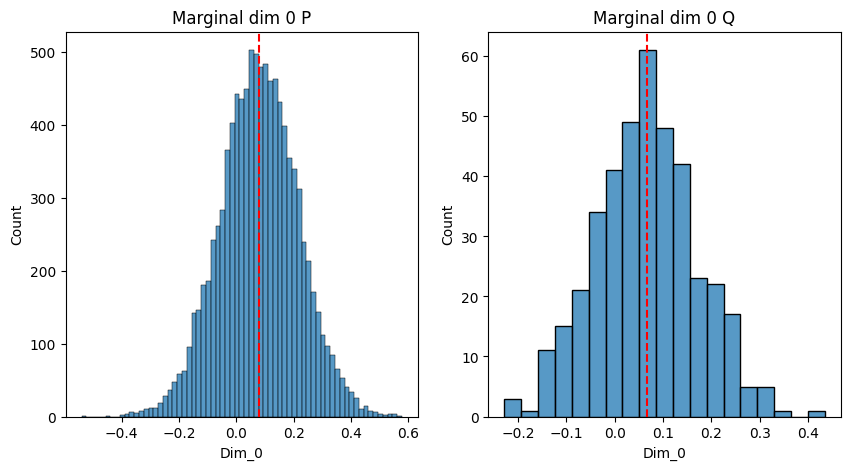

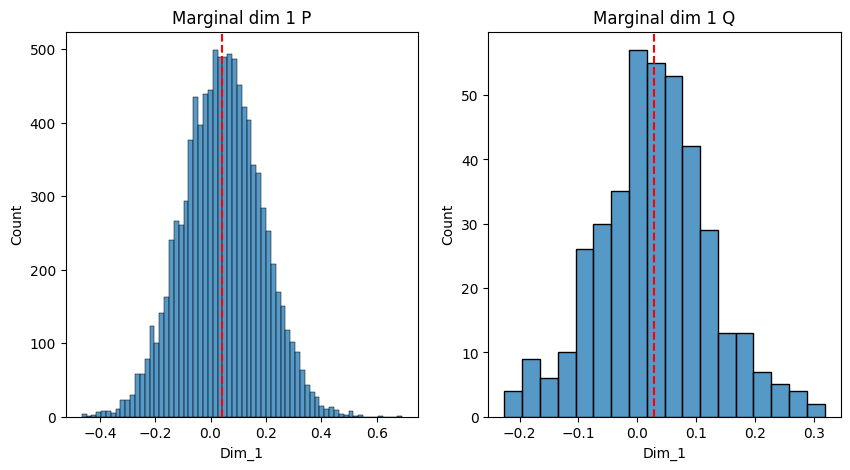

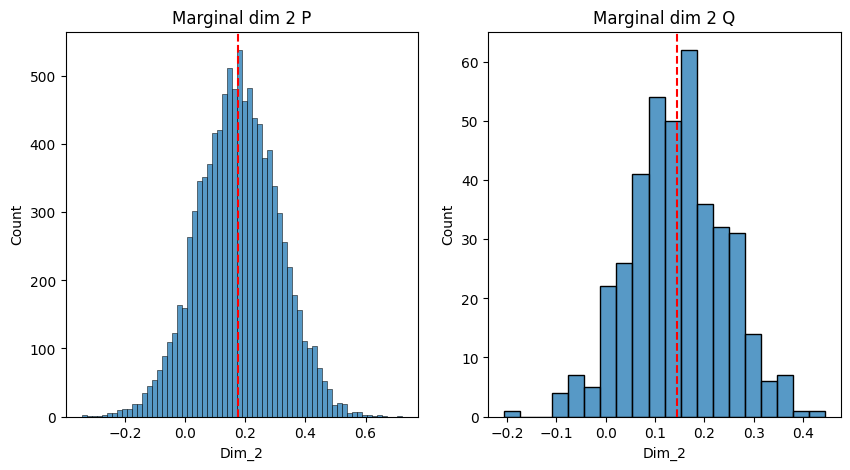

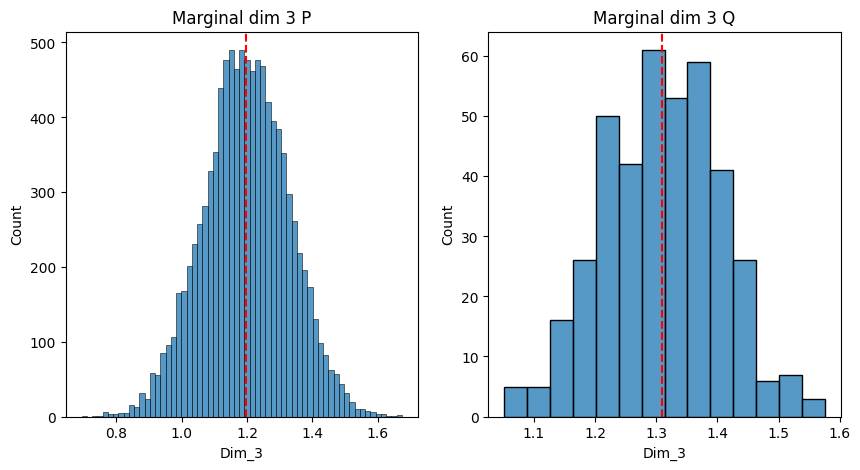

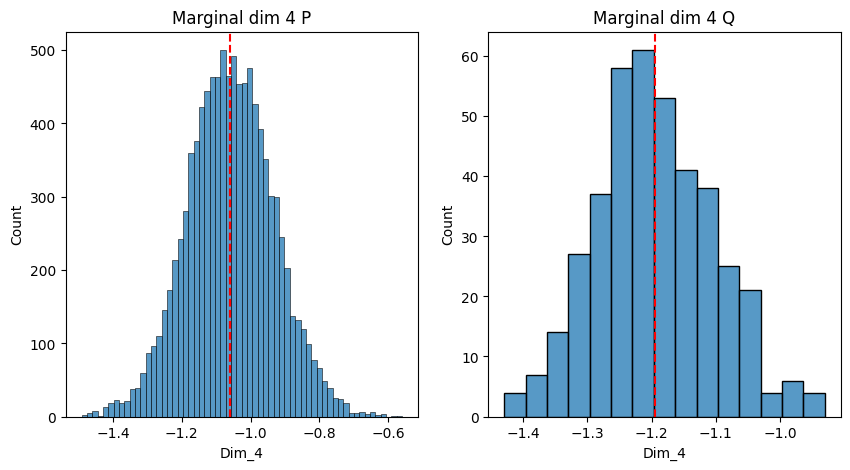

...

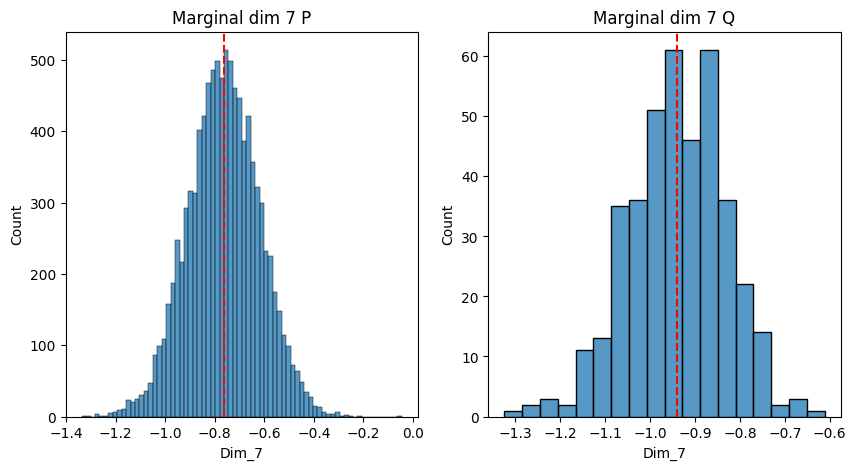

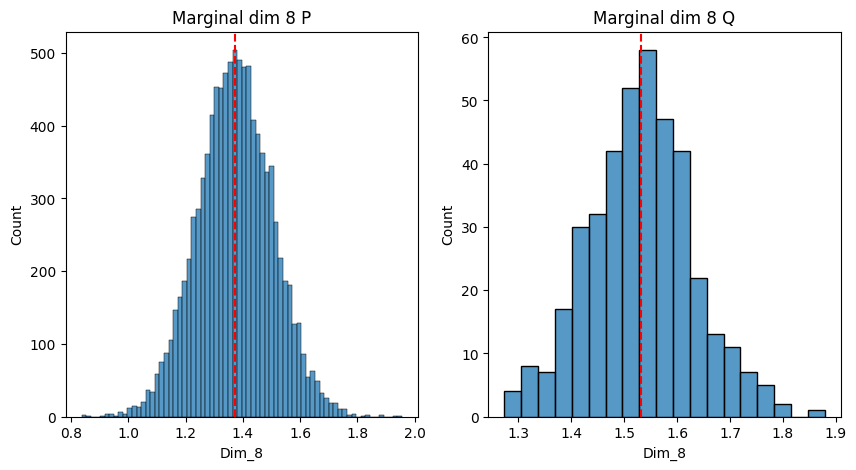

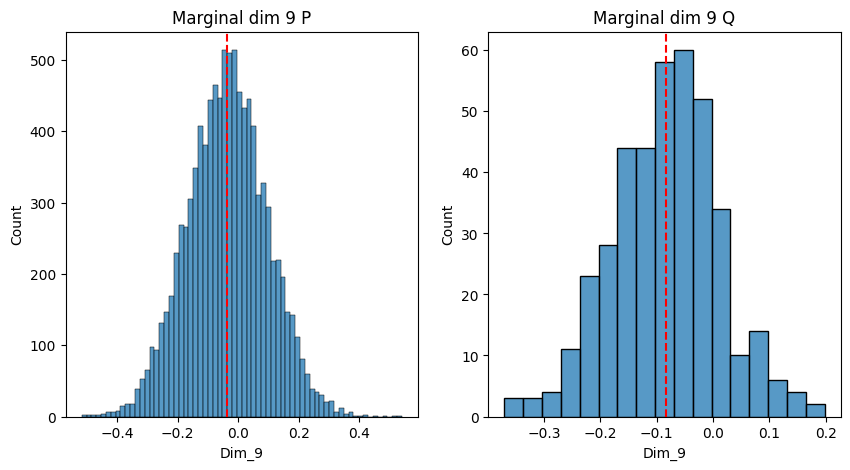

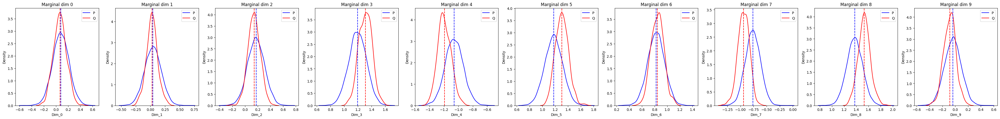

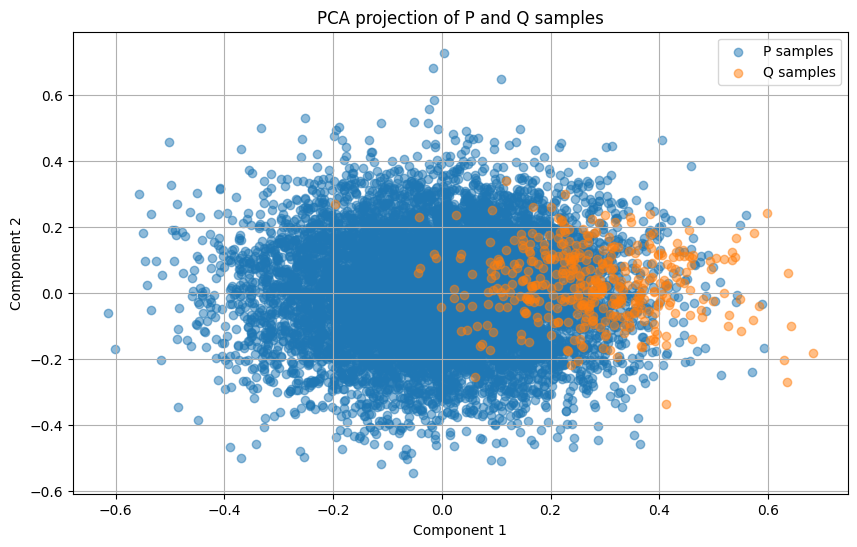

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
Sample: 100%|██████████| 800/800 [01:02, 12.80it/s, step size=1.66e-01, acc. prob=0.954]


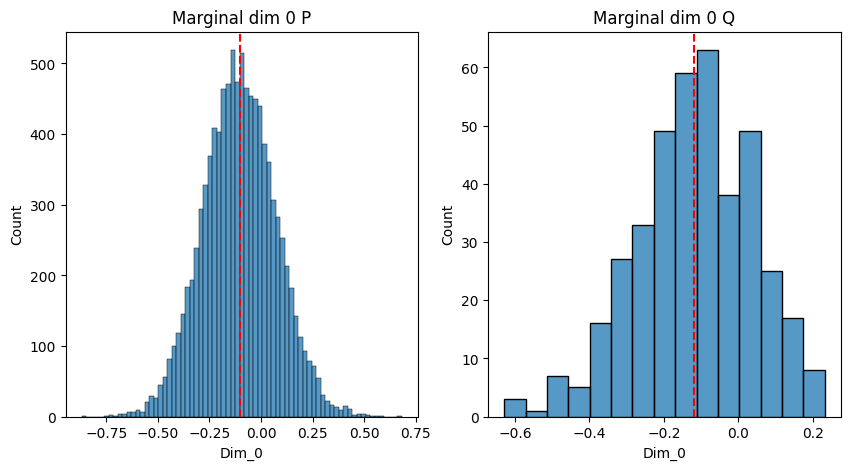

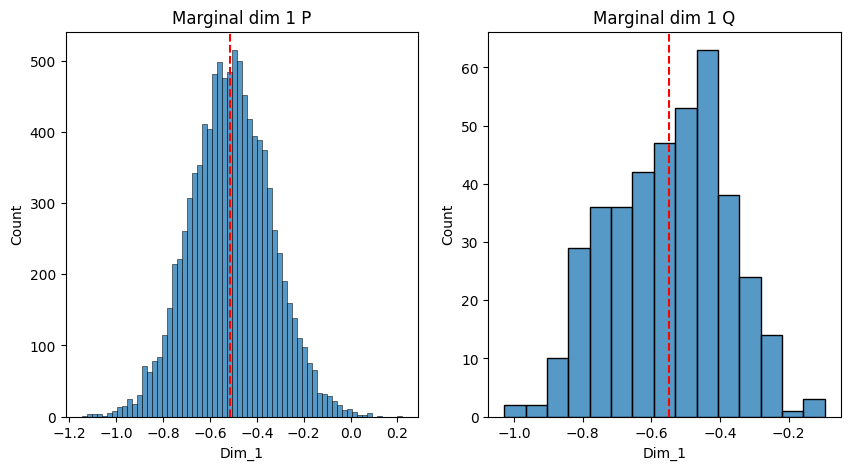

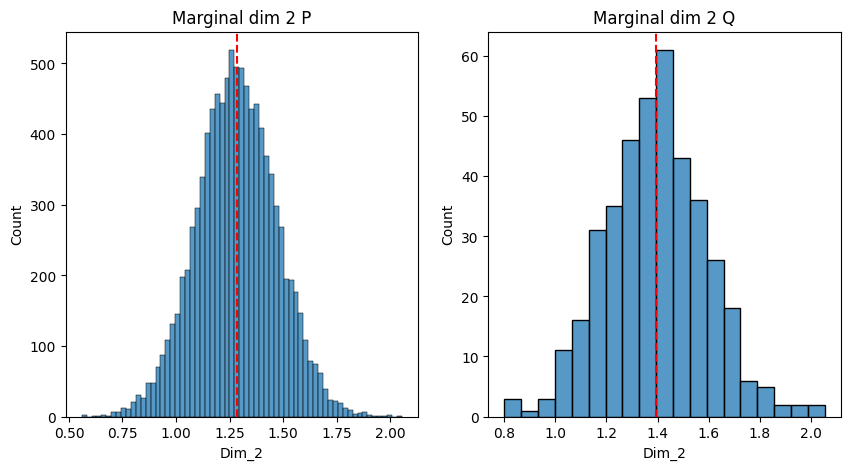

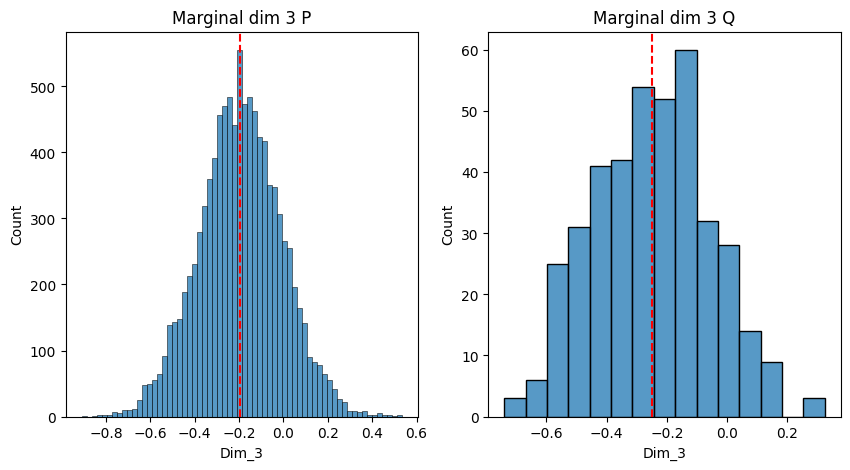

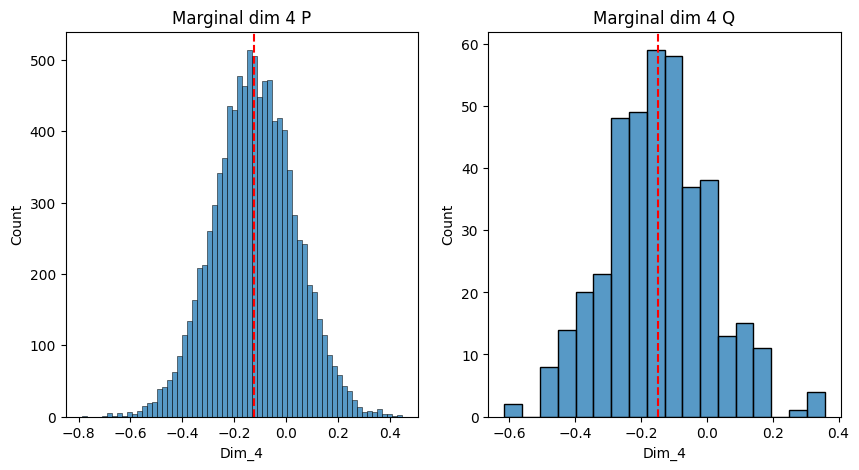

...

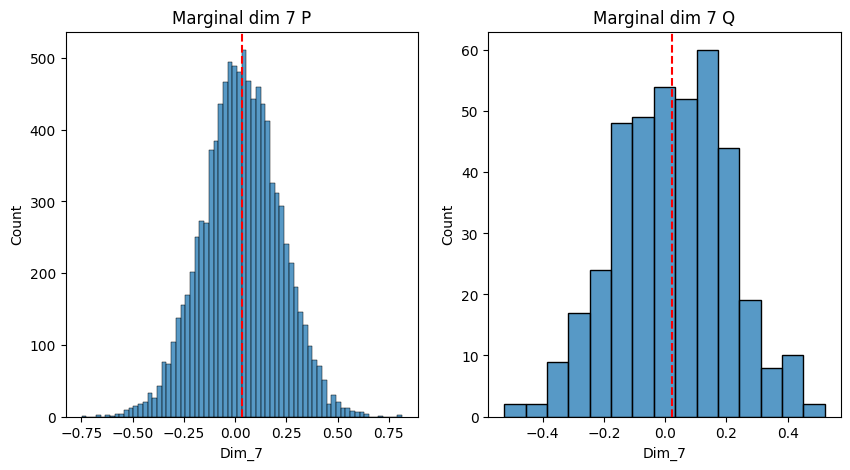

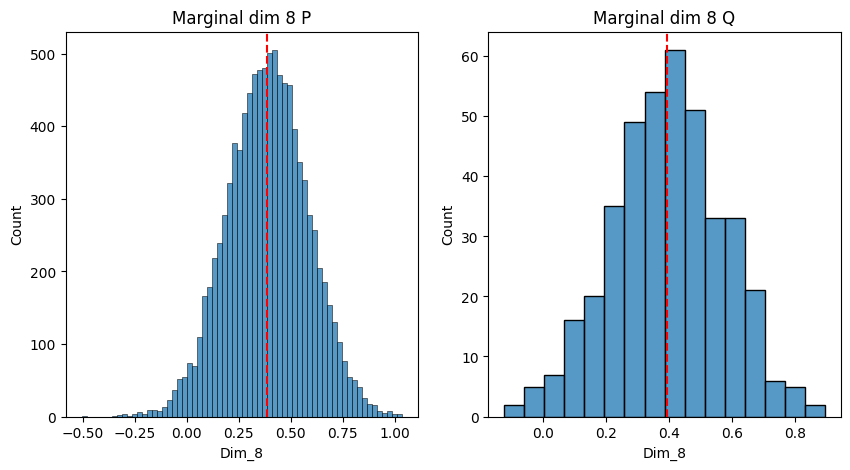

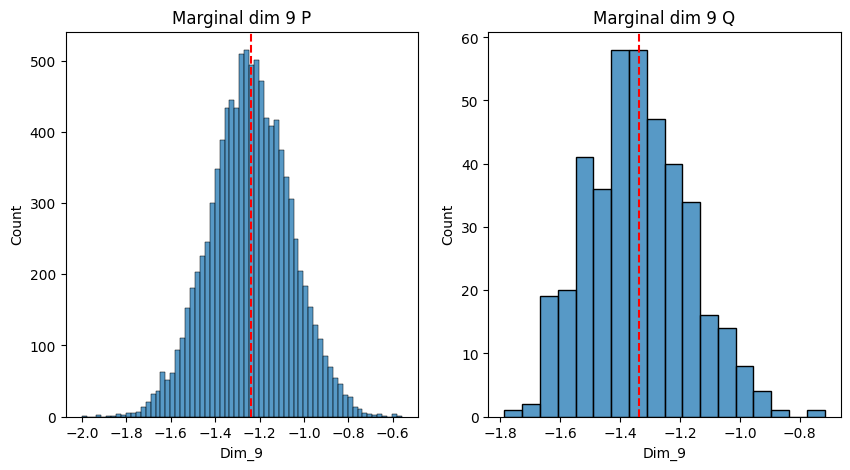

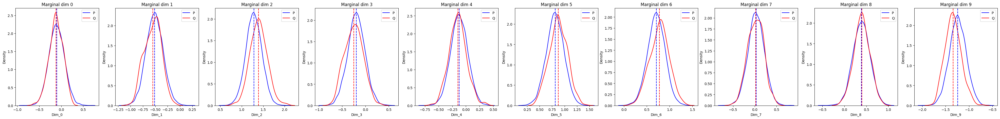

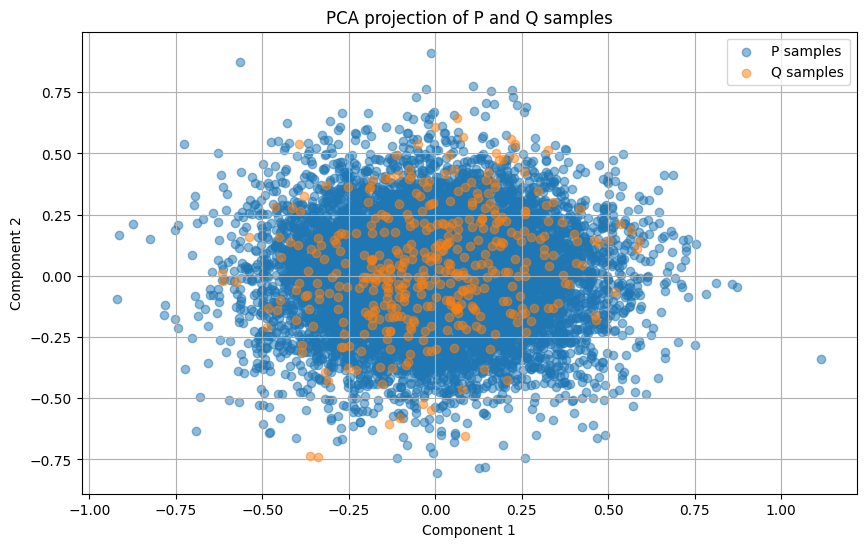

Sample: 100%|██████████| 800/800 [00:56, 14.22it/s, step size=1.82e-01, acc. prob=0.930]


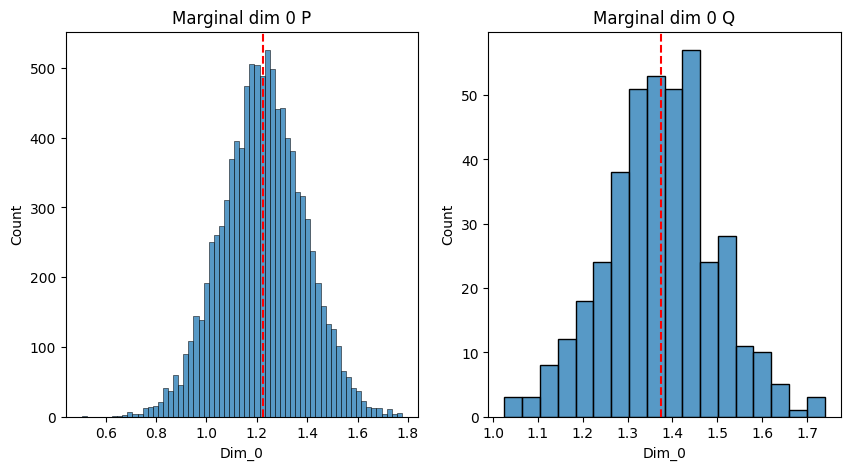

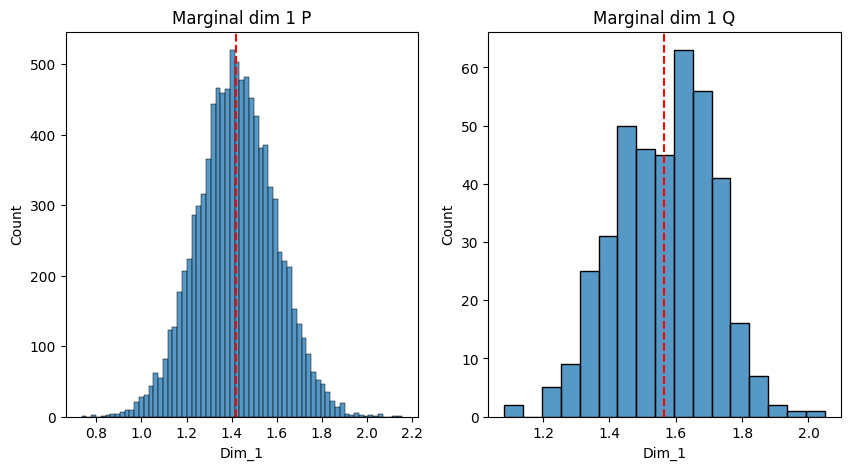

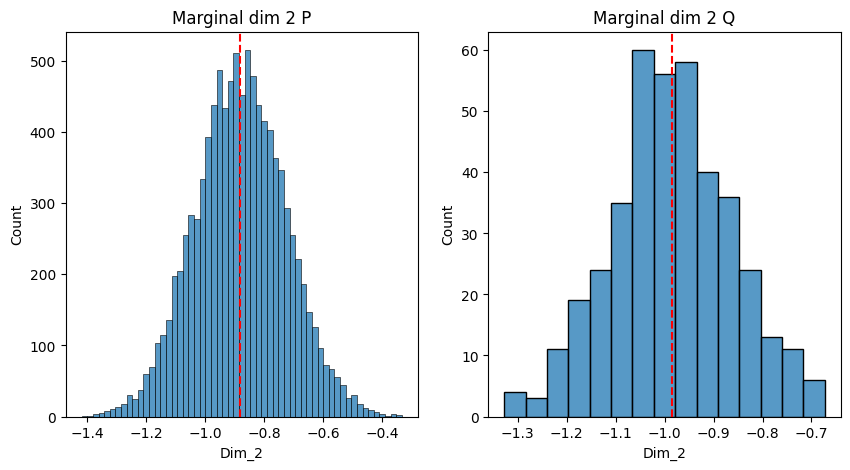

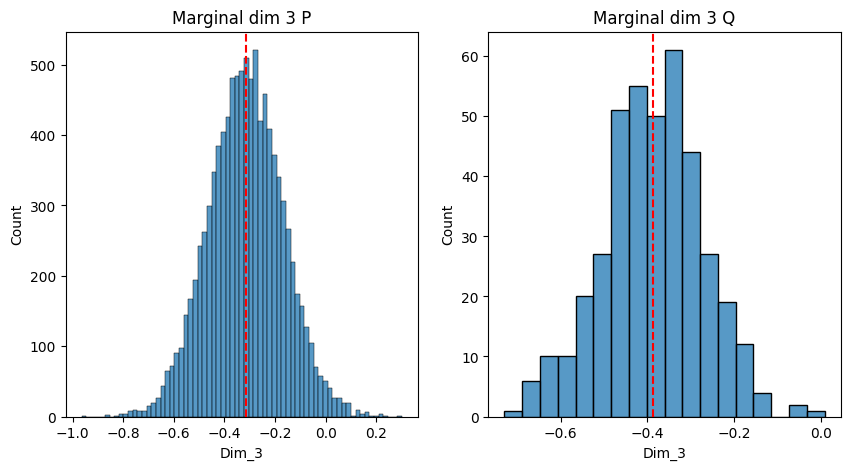

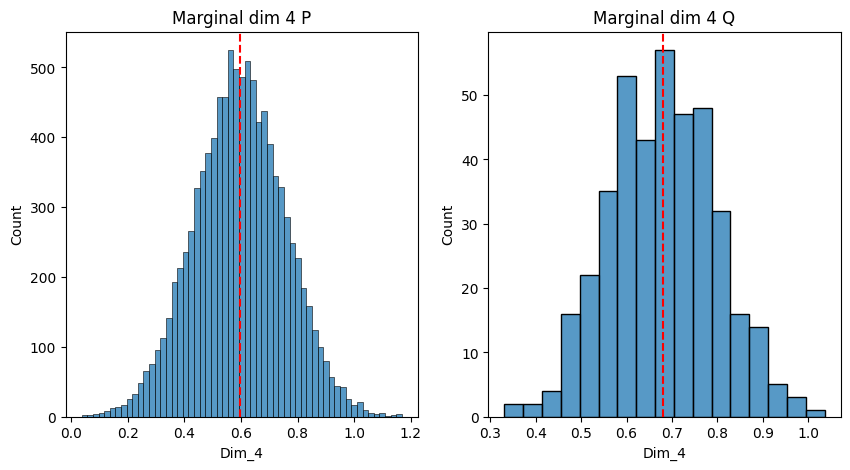

...

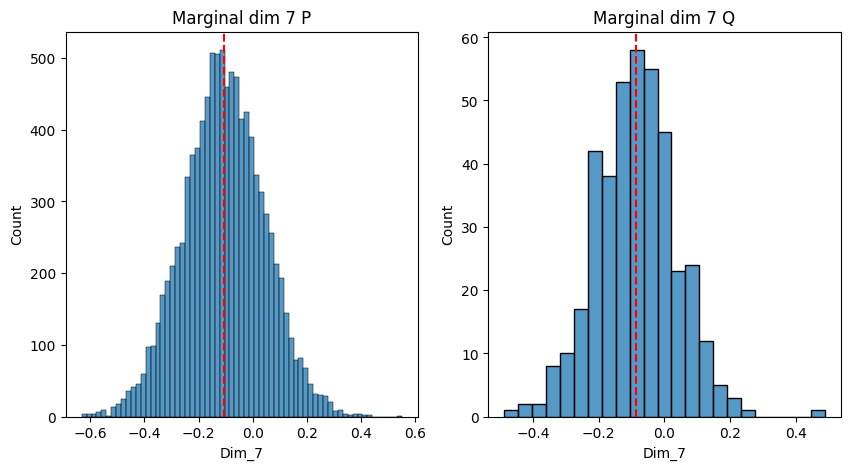

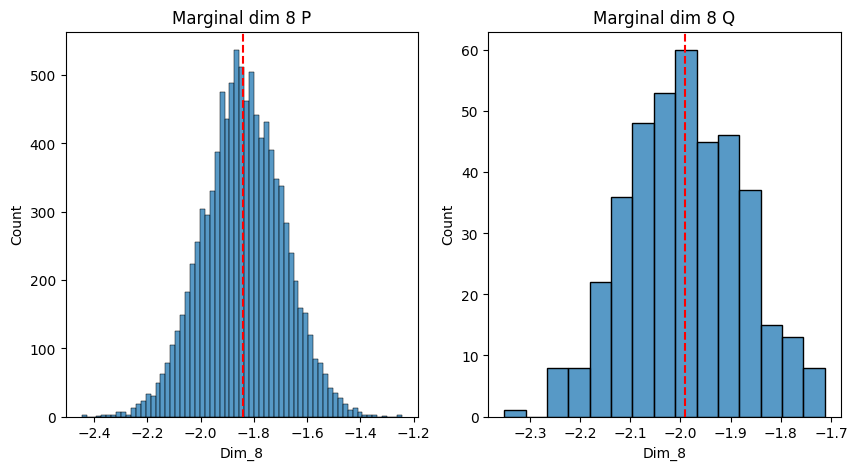

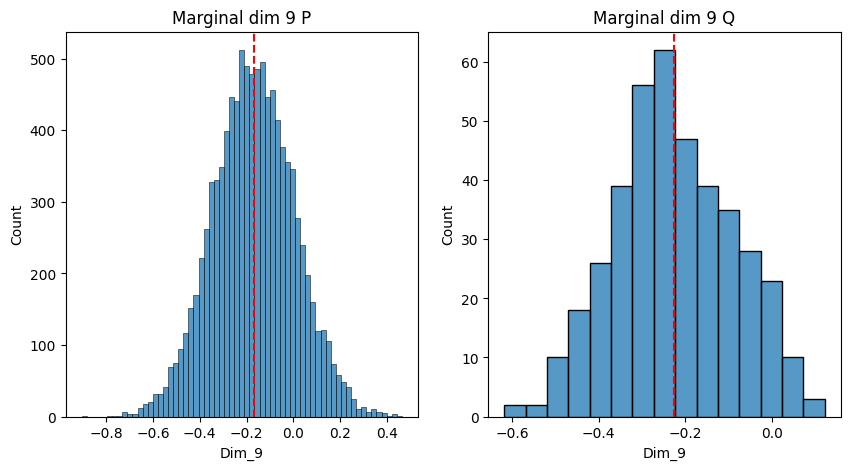

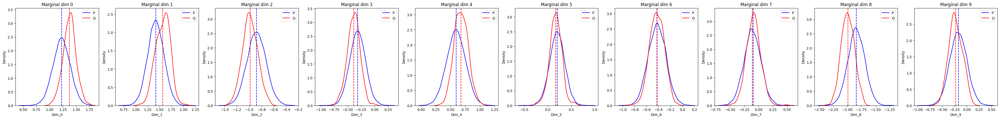

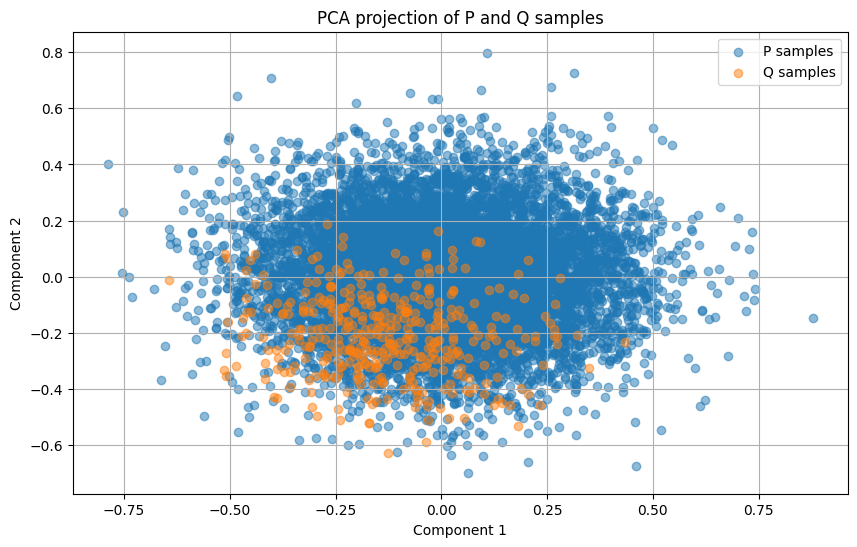

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


([{'CST': {'accuracy': 0.65, 'roc_auc_score': 0.65}, 'MMD': 0.14801430702209473, 'Wasserstein_distance with metric euclidean': 0.4489794373512268, 'mean_stats': {'absolute_mean_diff': tensor(0.0550), 'squared_mean_diff': tensor(0.0050), 'P_mean': tensor([-1.0013,  0.6448,  0.1559, -0.3610, -0.6018, -0.7273, -0.9603,  1.5743,
        -0.3729, -1.3914]), 'Q_mean': tensor([-1.0838,  0.6982,  0.1768, -0.3792, -0.6147, -0.6891, -1.0103,  1.7304,
        -0.3877, -1.4944])}, 'std_stats': {'absolute_std_diff': tensor(0.0087), 'squared_std_diff': tensor(0.0001), 'P_std': tensor([0.2002, 0.1924, 0.2019, 0.2066, 0.2003, 0.2139, 0.1922, 0.2156, 0.1865,
        0.2129]), 'Q_std': tensor([0.1956, 0.1944, 0.1900, 0.2104, 0.1998, 0.2074, 0.1808, 0.2246, 0.1675,
        0.1947])}, 'q_025_stats': {'absolute_q_025_diff': tensor(0.0518), 'squared_q_025_diff': tensor(0.0051), 'P_q_025': tensor([-1.3947,  0.2730, -0.2452, -0.7682, -0.9969, -1.1405, -1.3357,  1.1513,
        -0.7349, -1.8082]), 'Q_q_025': t

In [ ]:
r_hmc_gt = comparison_model_gt_hmc.compare_sample_metrics_batch(test_batch["x"][:5], test_batch["y"][:5])
print(r_hmc_gt)

In [ ]:
print_wasserstein_distances(r_hmc_gt)

[0.4489794373512268, 0.3644297420978546, 0.4104160666465759, 0.4008573591709137, 0.4202669858932495]
0.4089899182319641


In [ ]:
guide_gamma_gamma = make_guide_program_gamma_gamma()

In [ ]:
vi = Variational_Inference(
    pprogram=pprogram1,
    guide = guide_gamma_gamma,
    n_steps = 2000,
    n_samples=10_000,
    lr = 1e-2
)

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


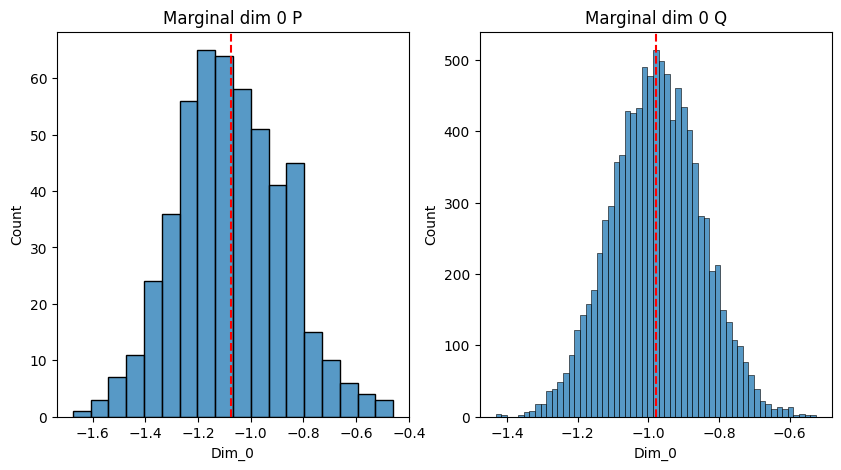

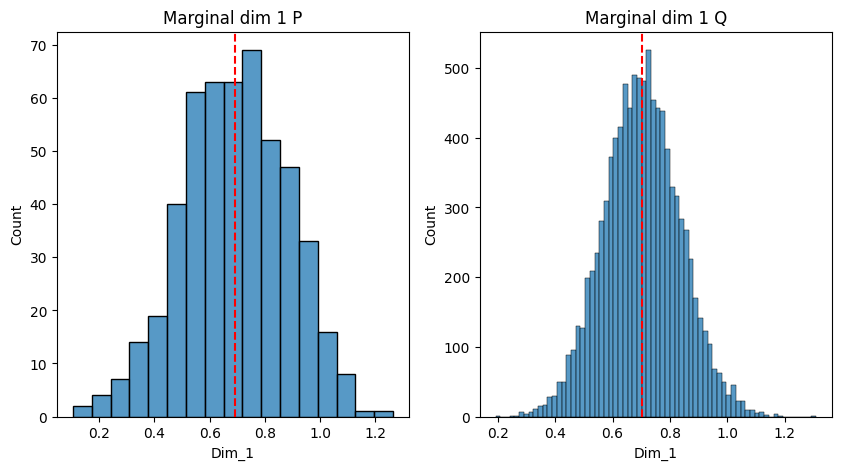

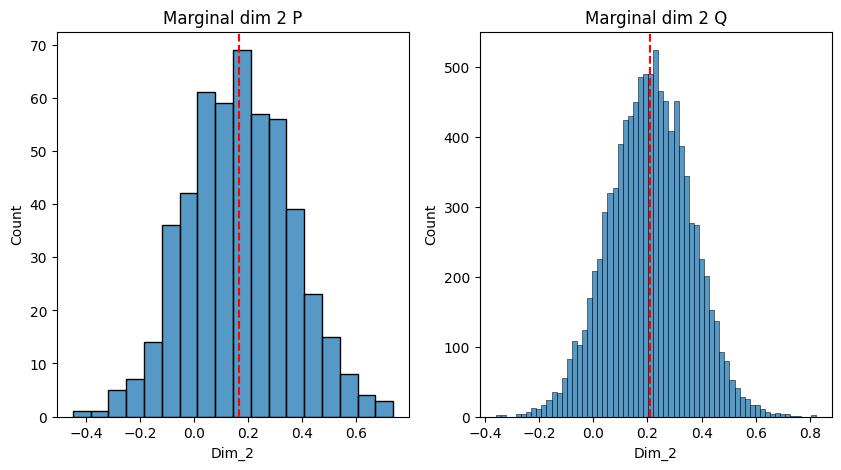

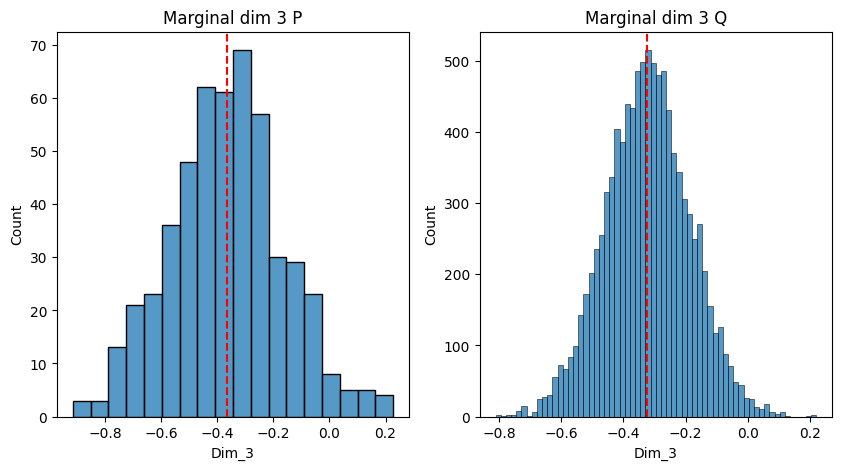

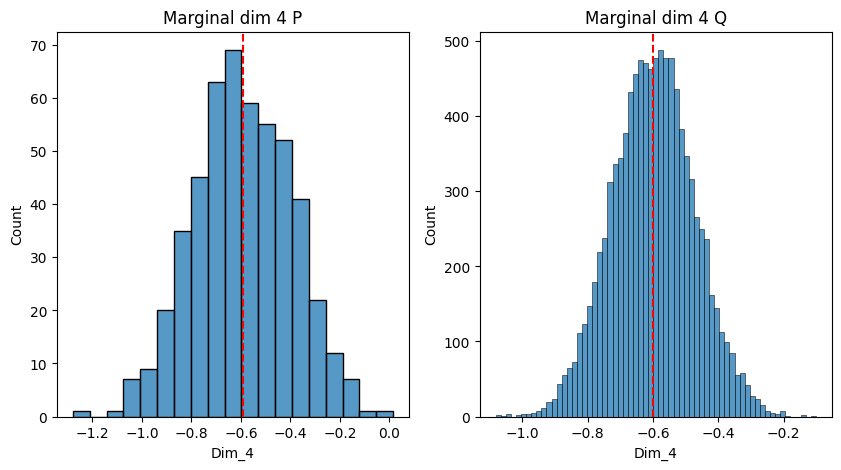

...

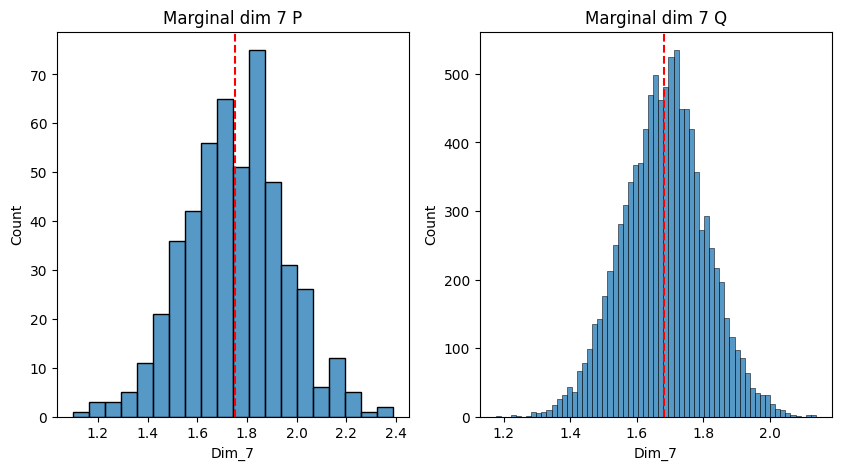

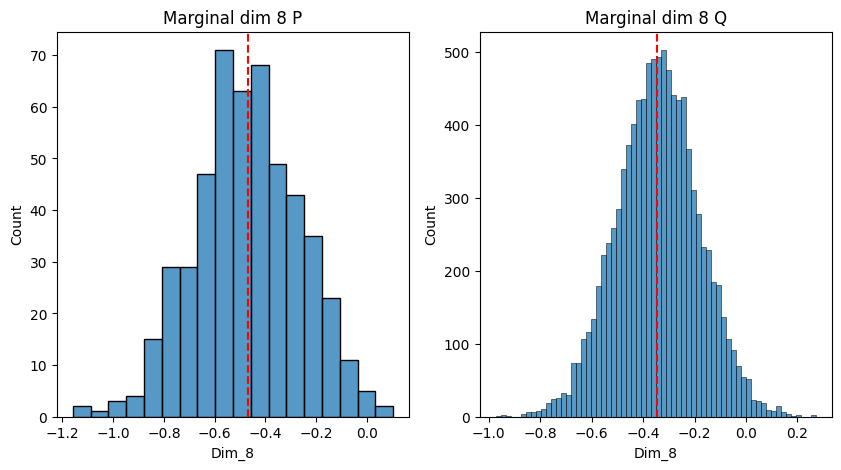

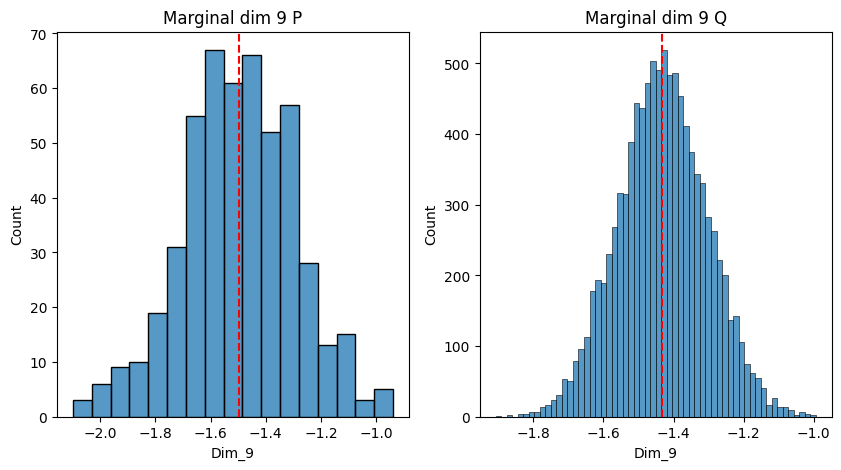

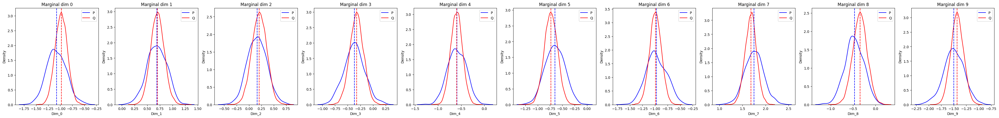

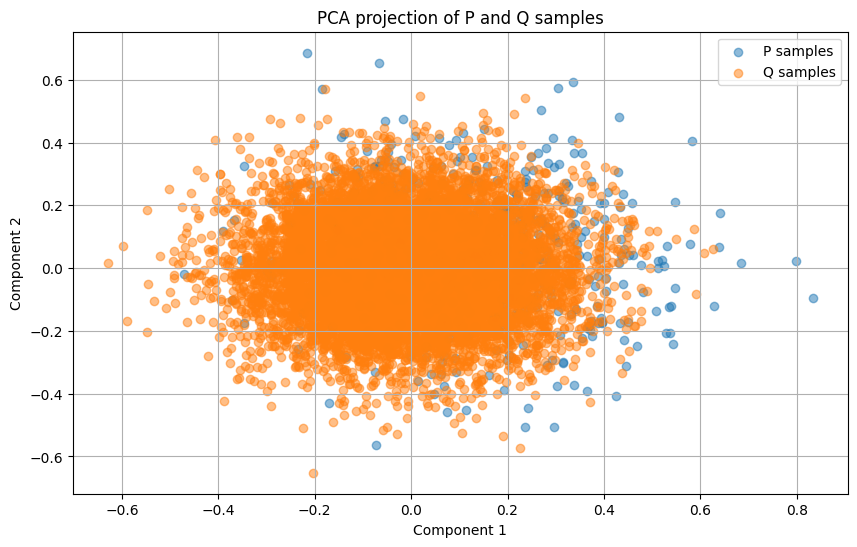

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


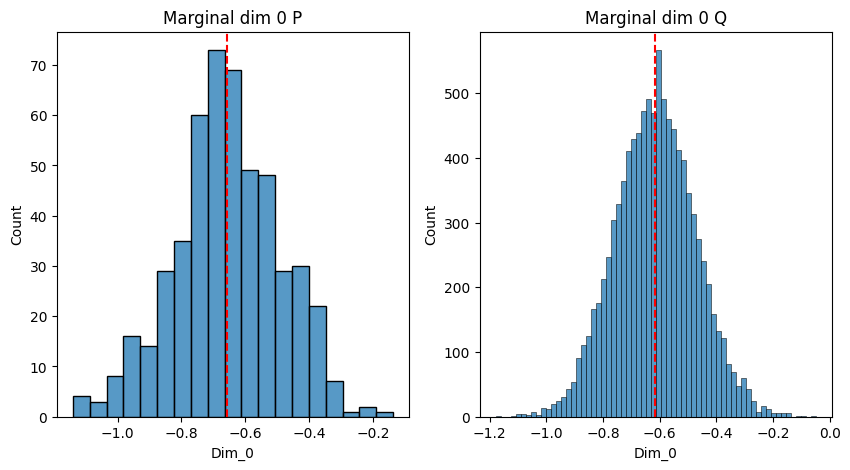

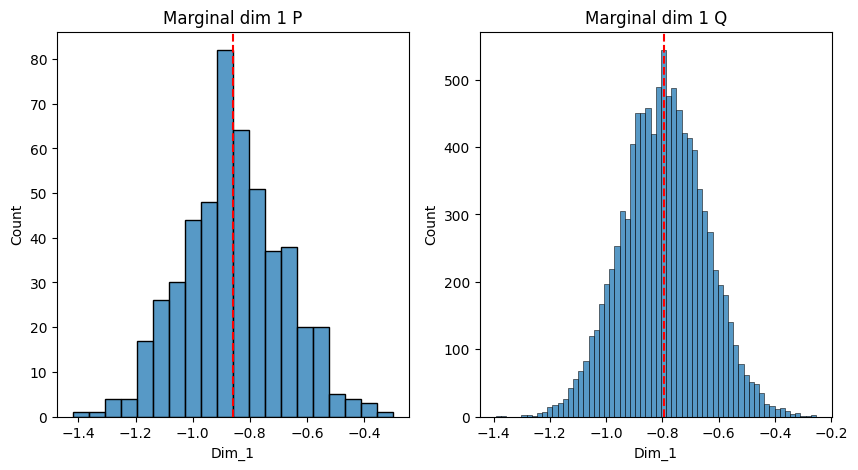

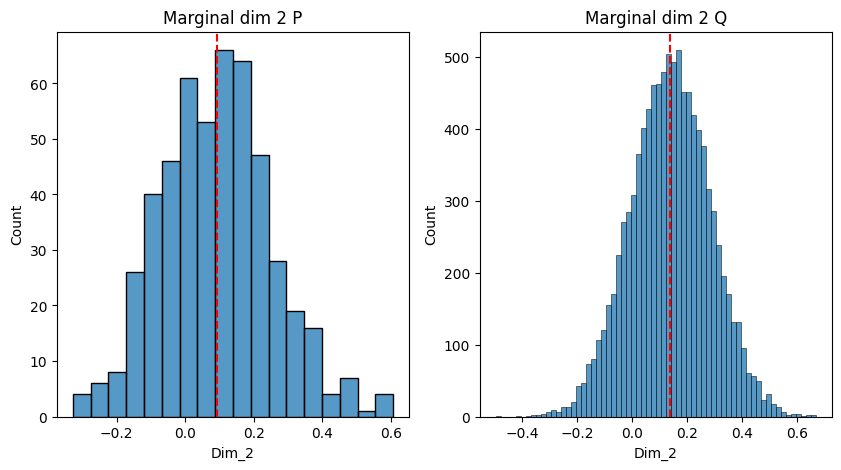

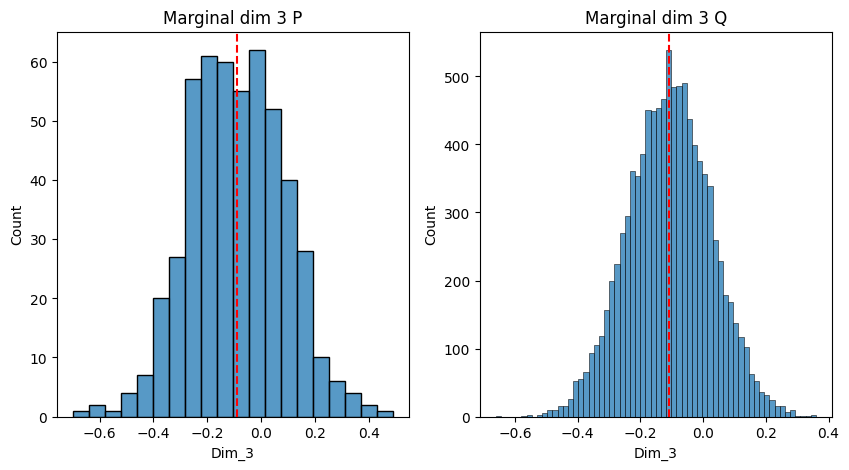

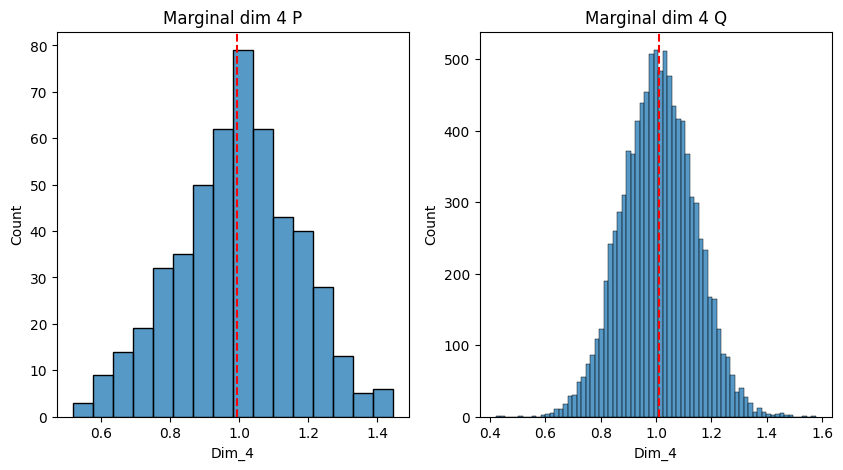

...

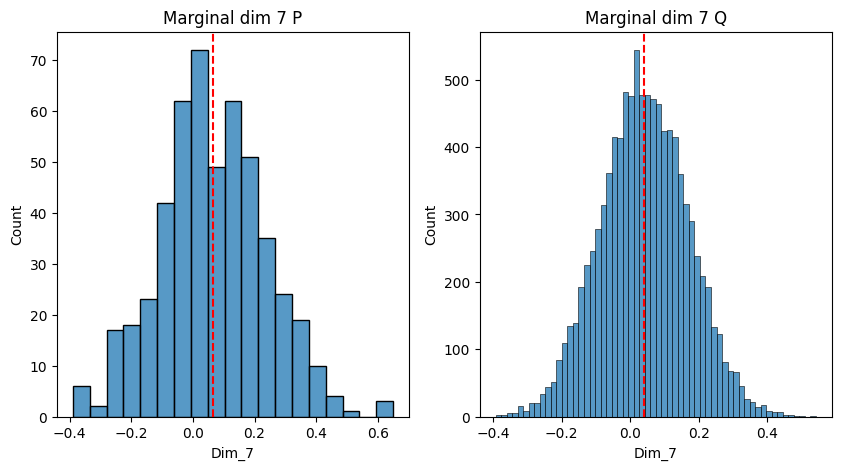

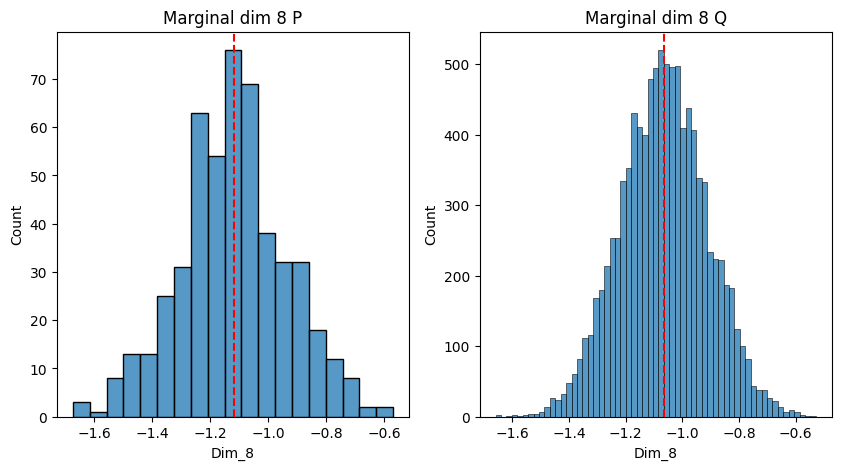

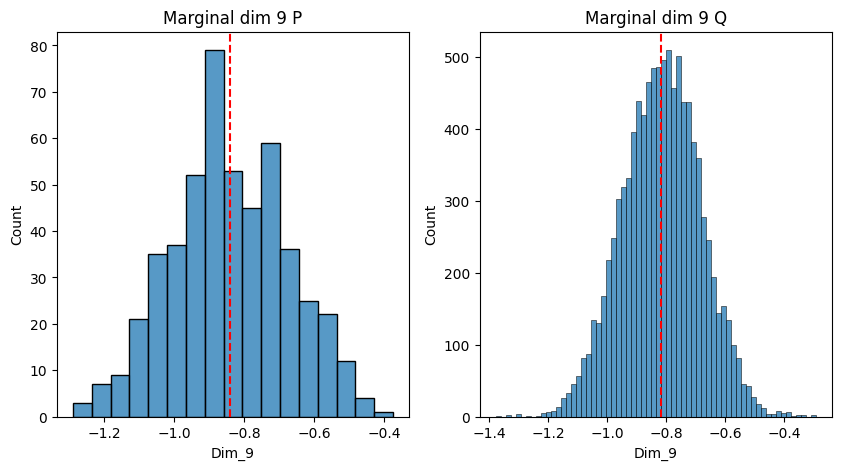

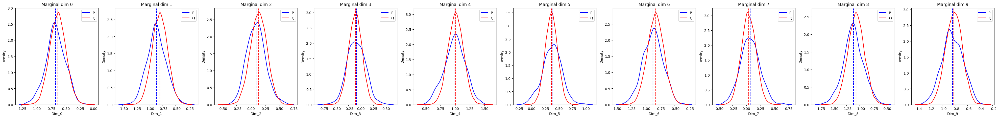

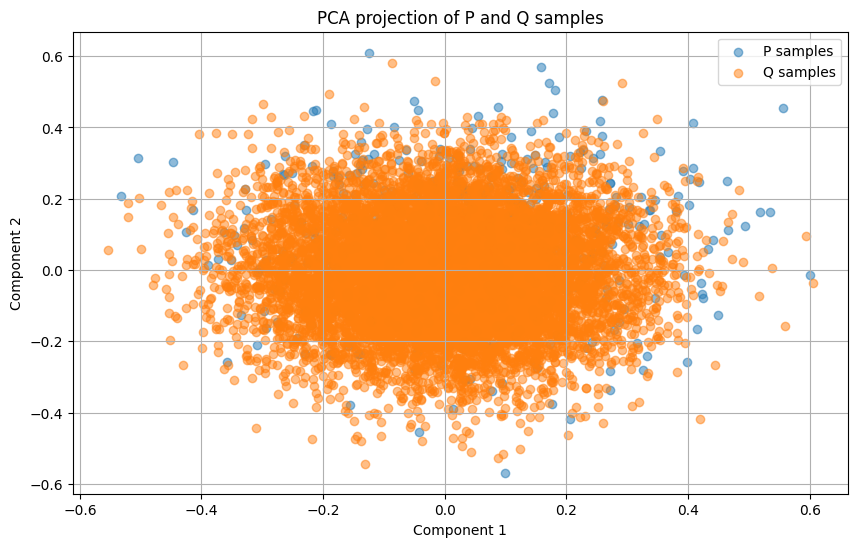

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


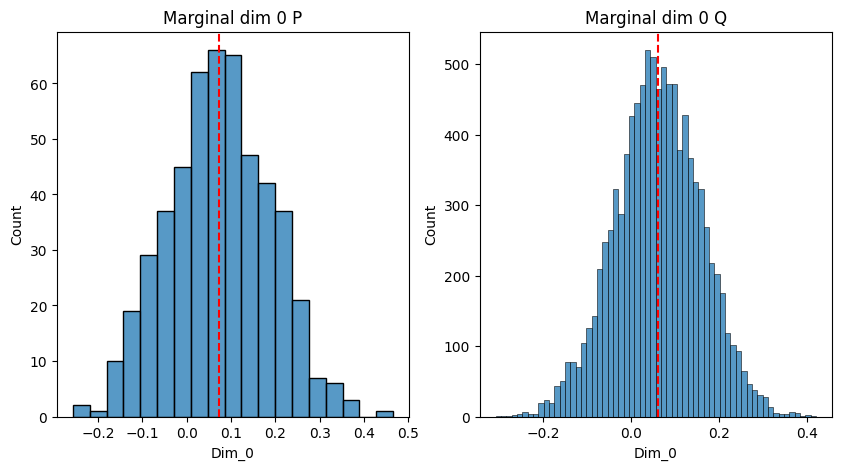

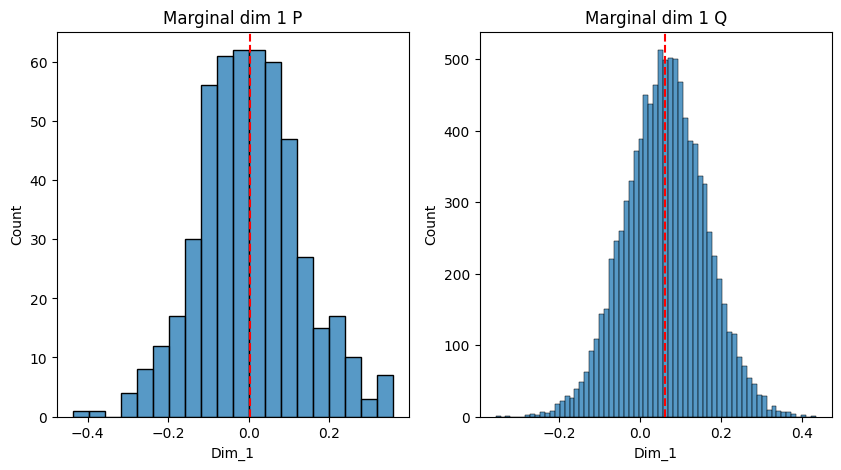

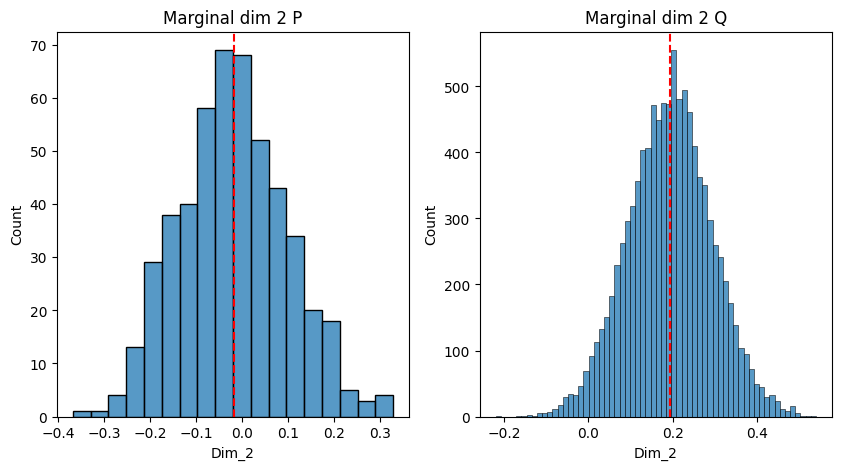

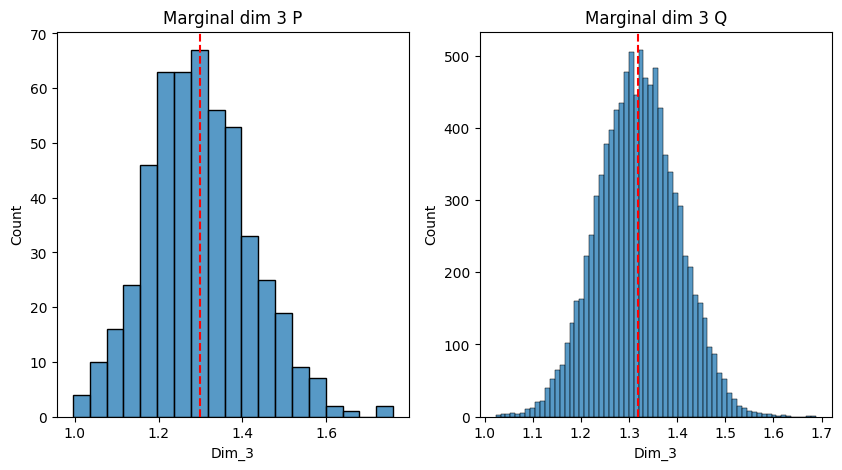

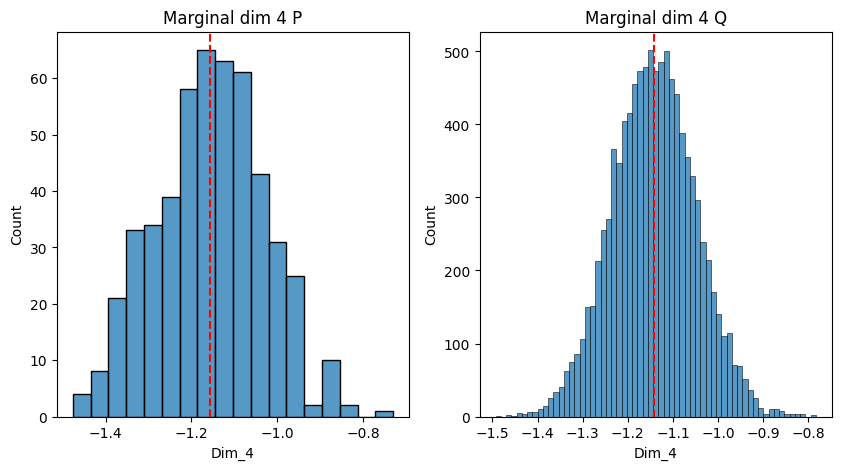

...

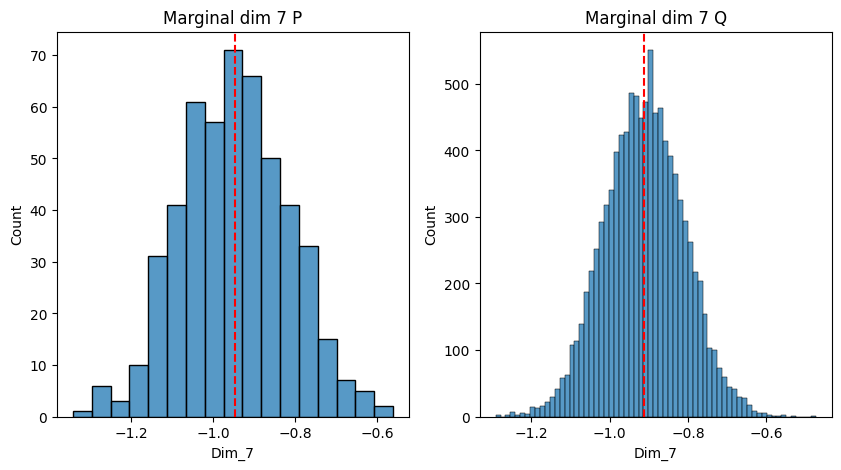

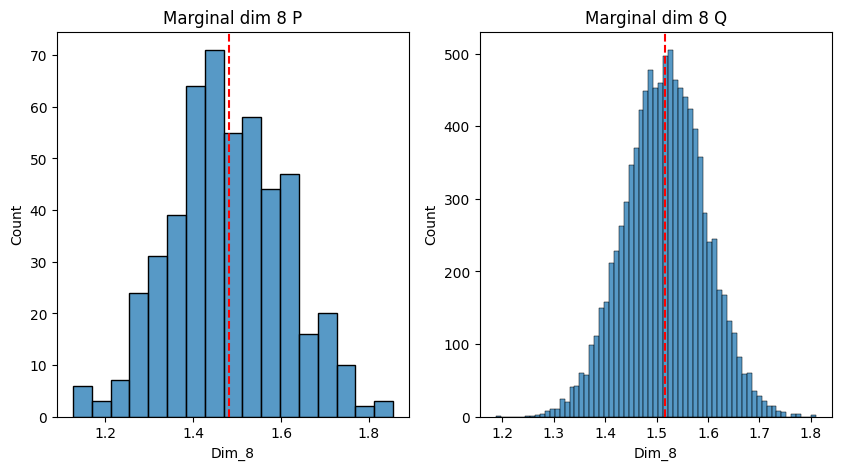

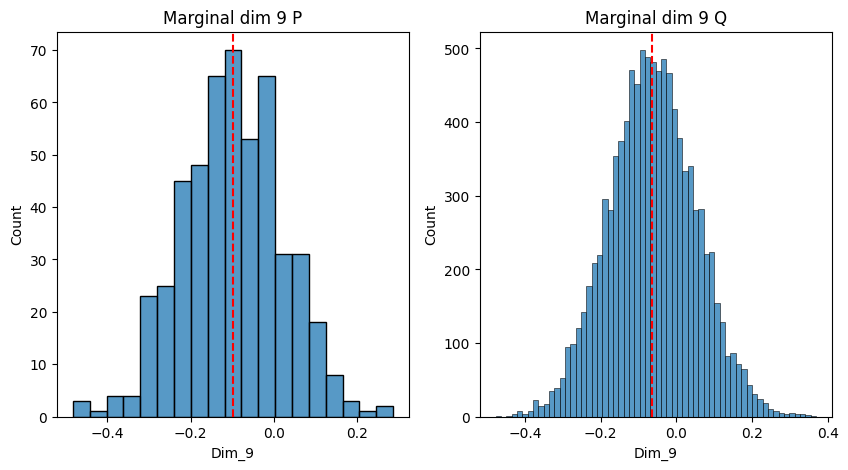

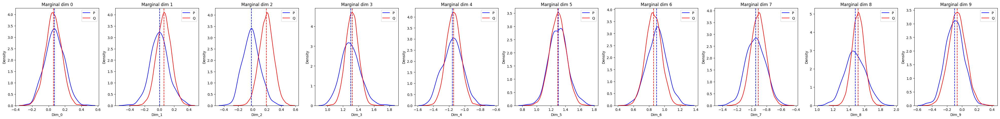

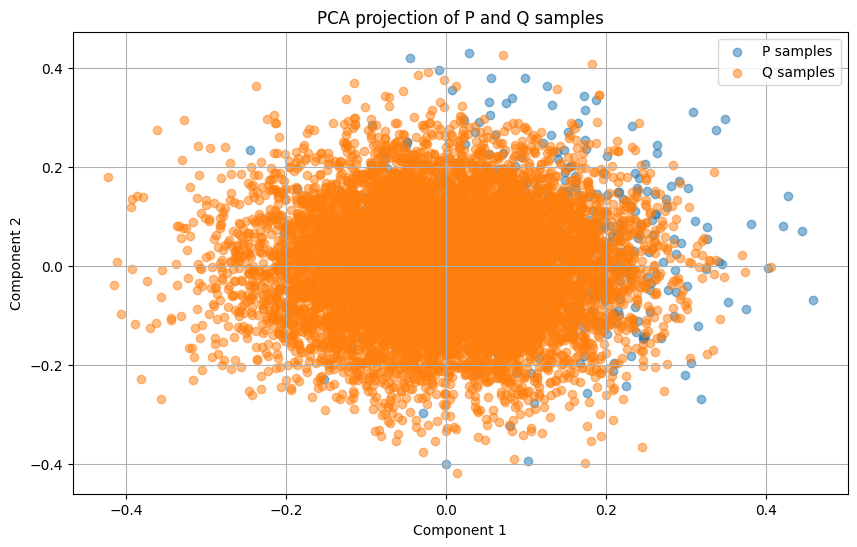

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


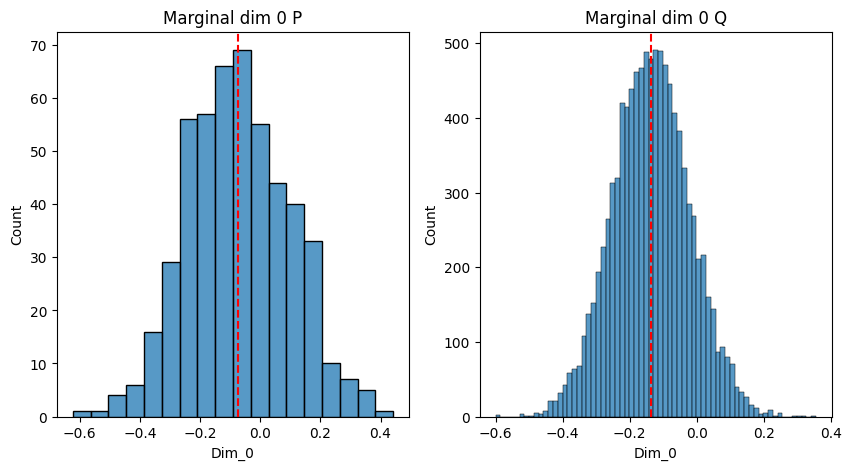

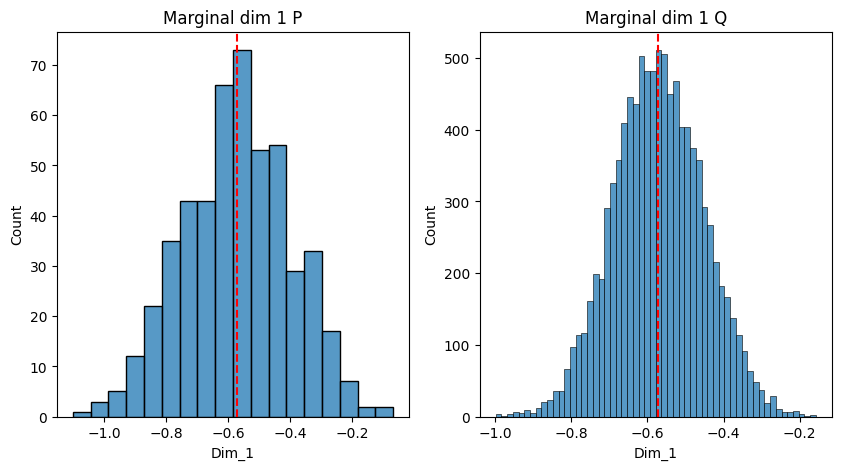

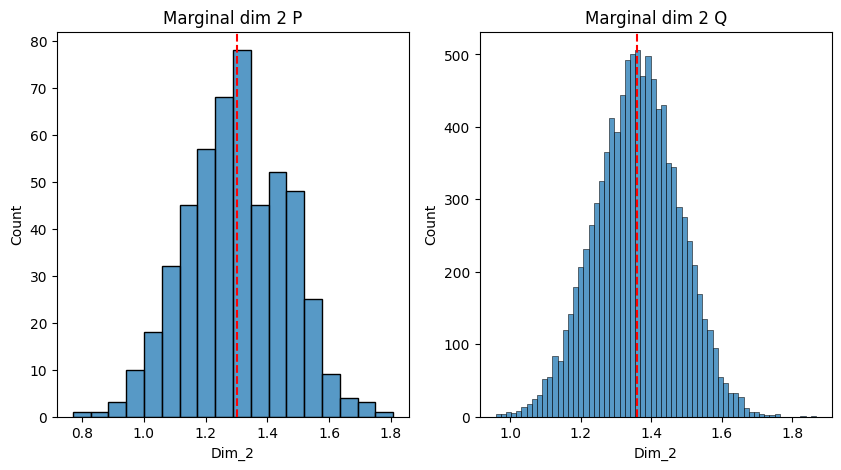

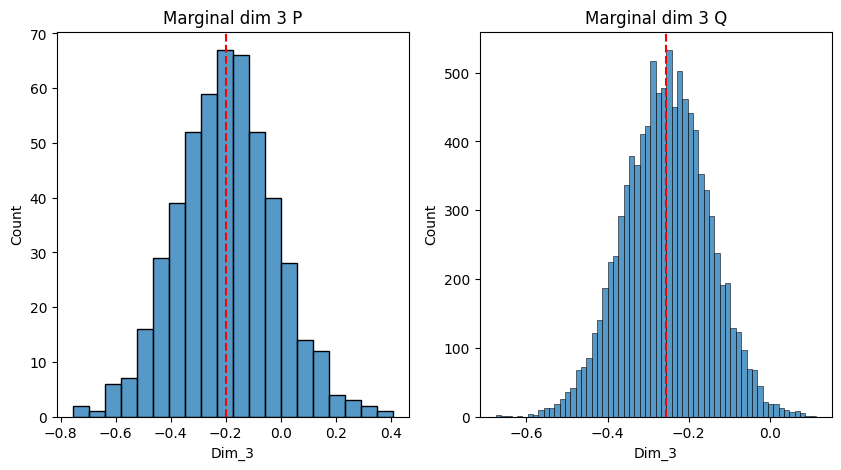

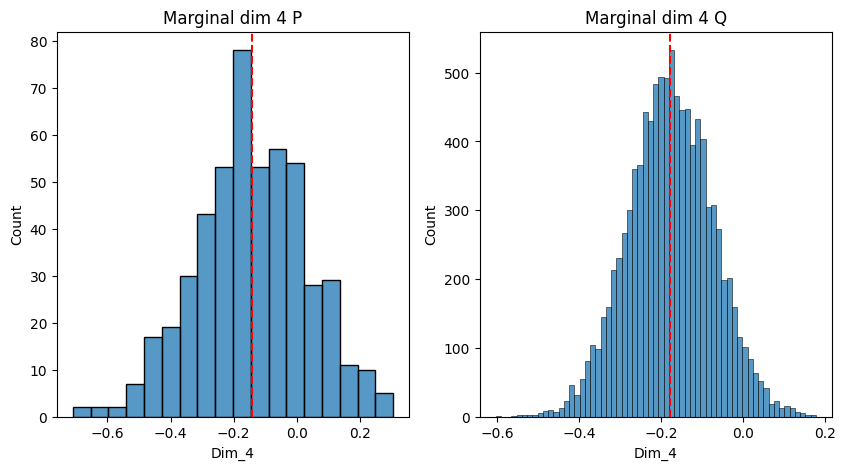

...

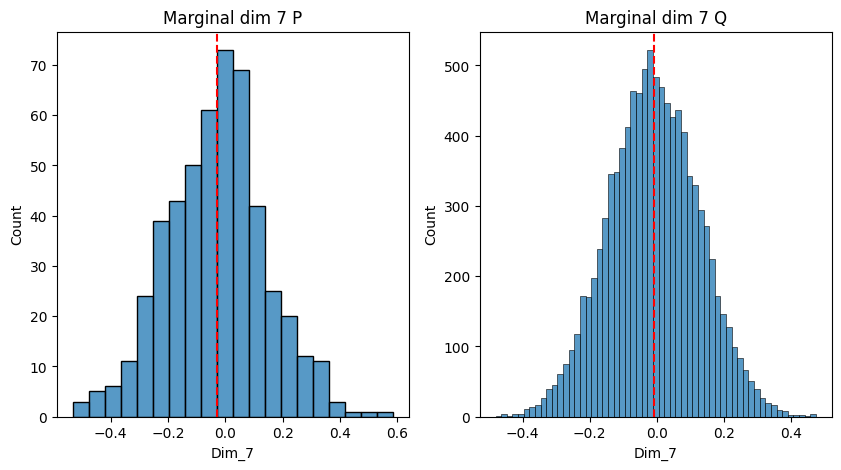

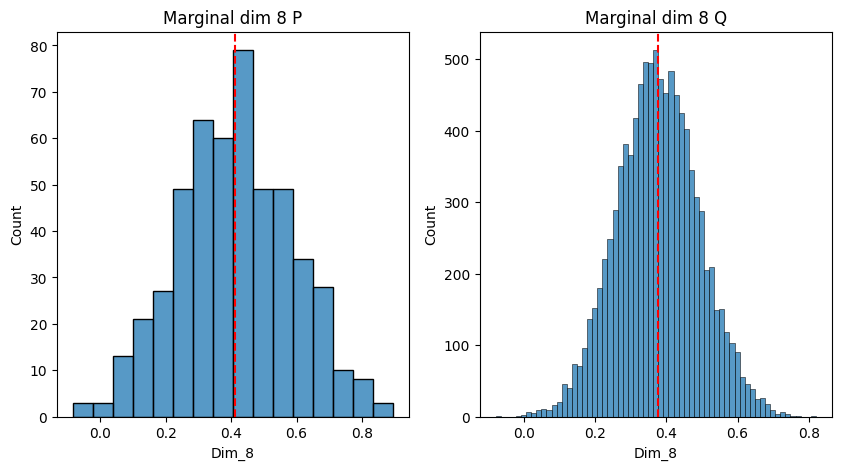

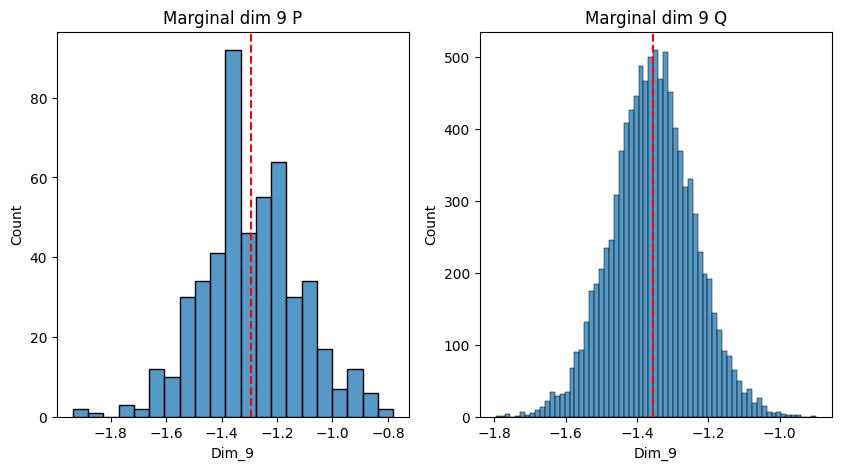

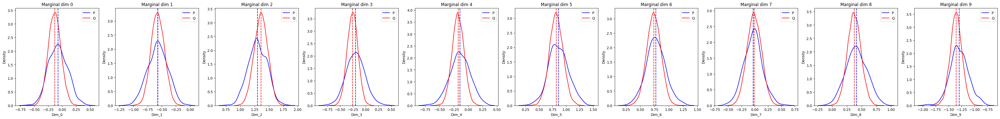

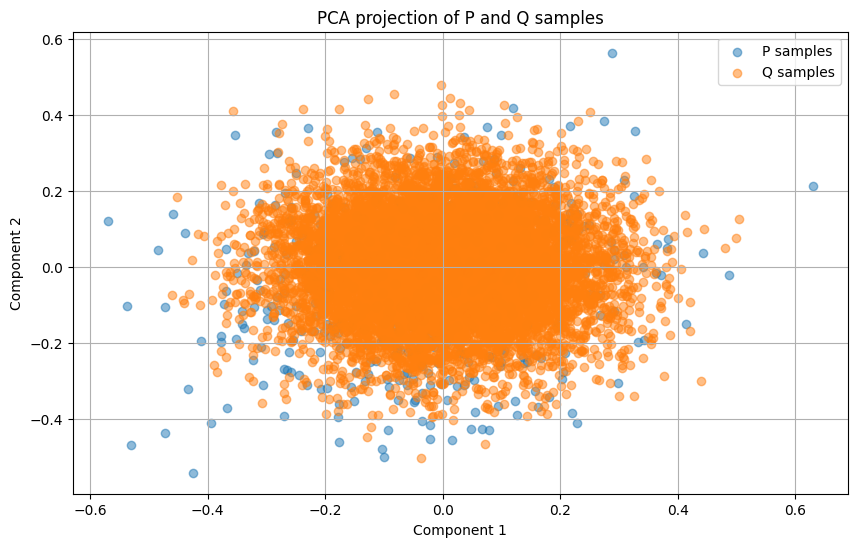

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


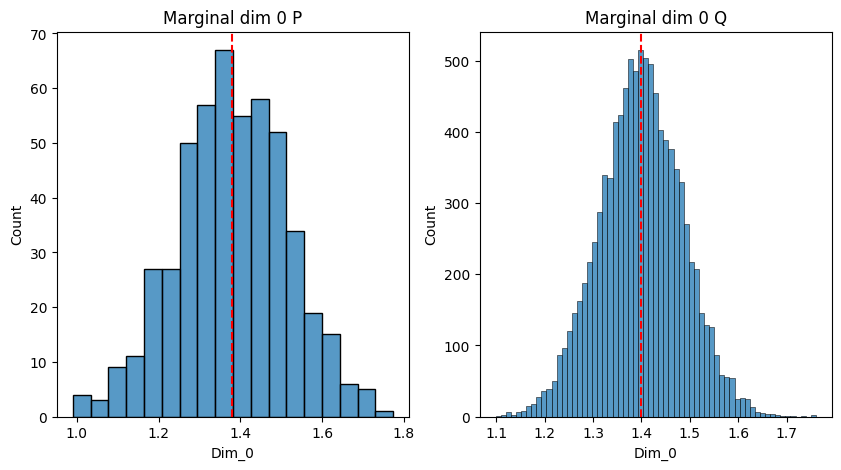

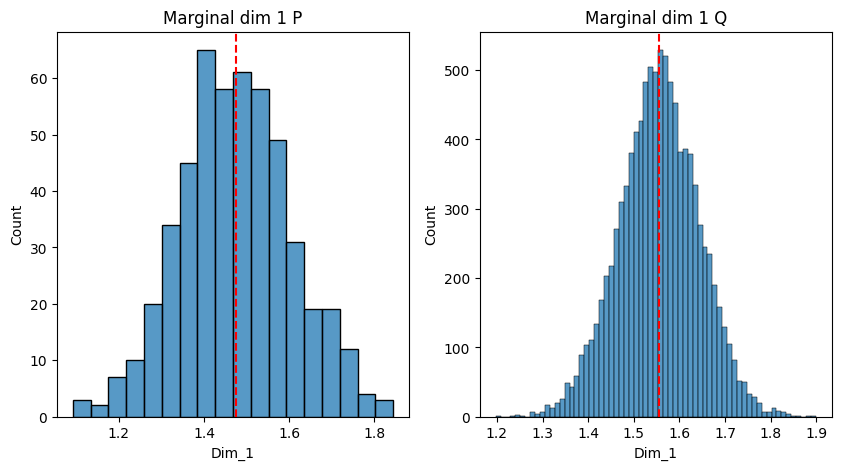

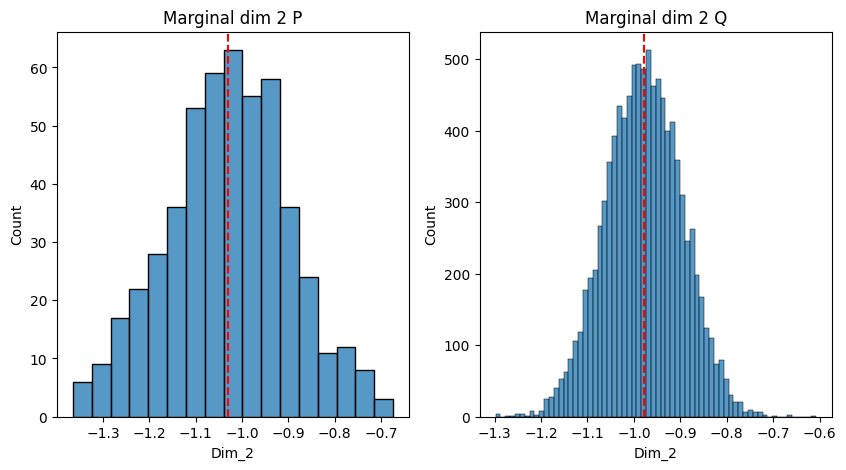

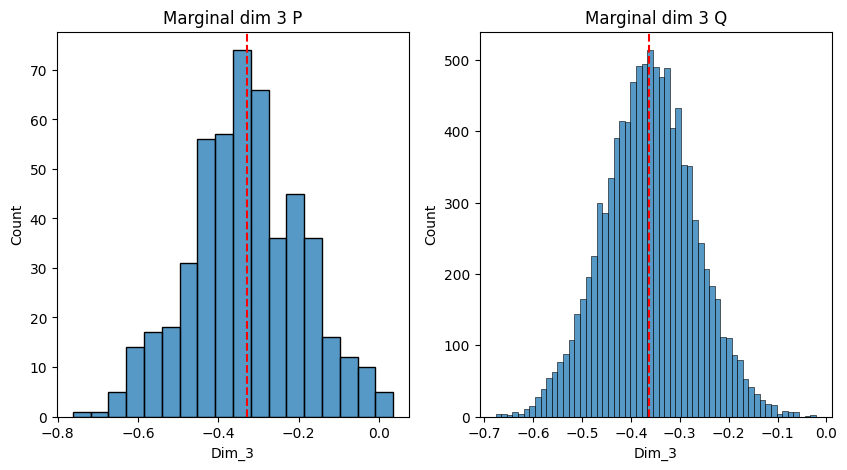

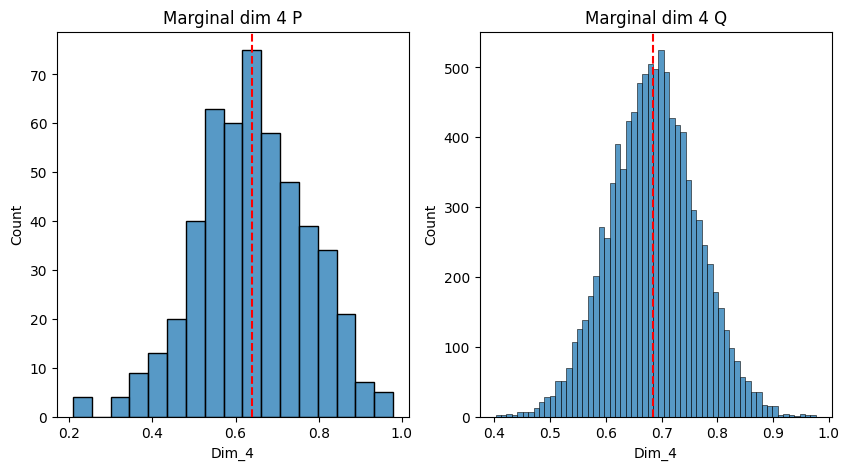

...

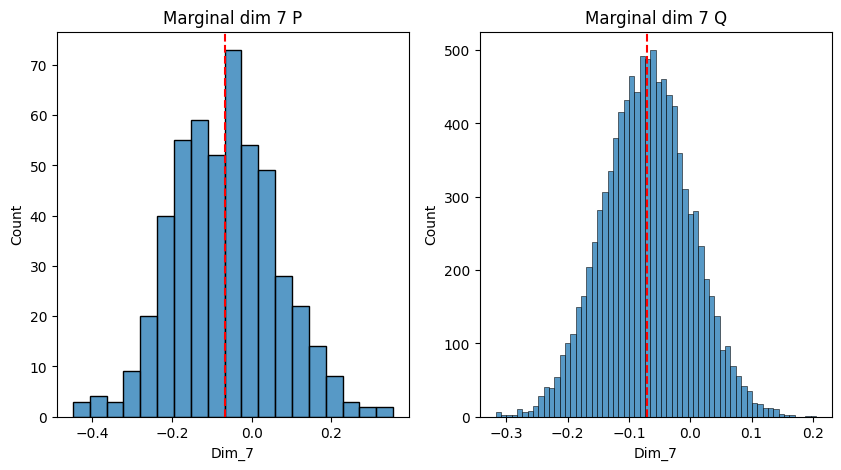

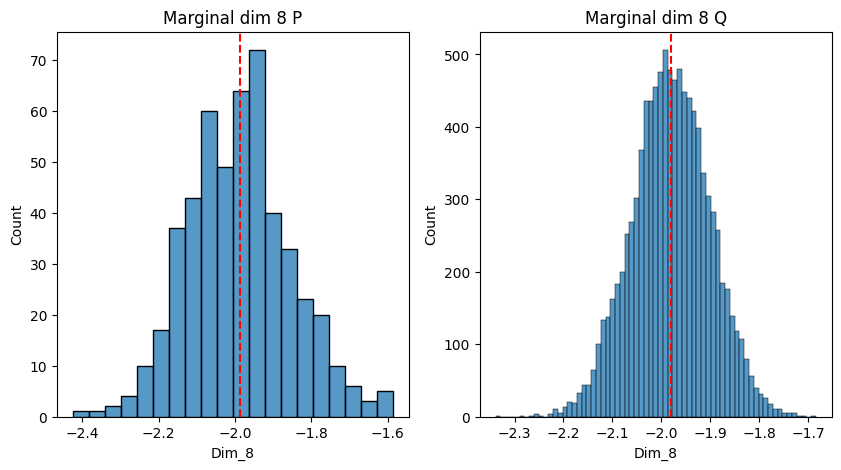

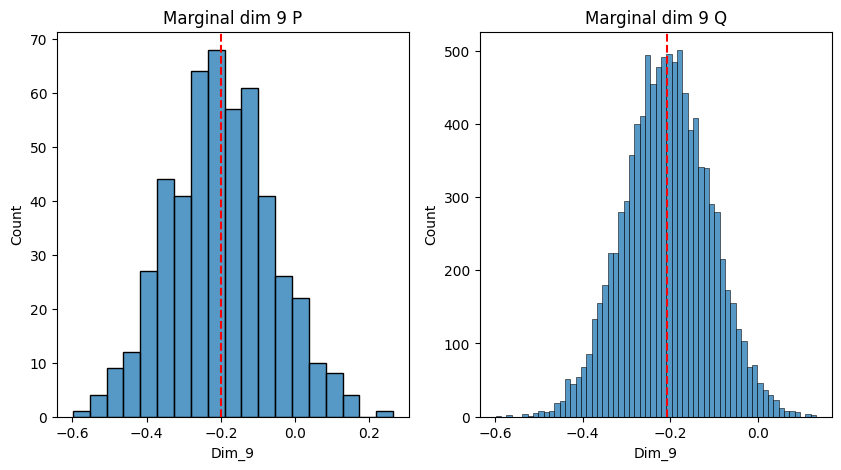

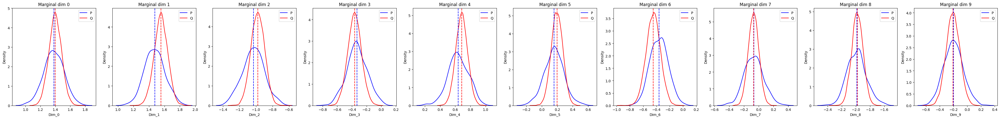

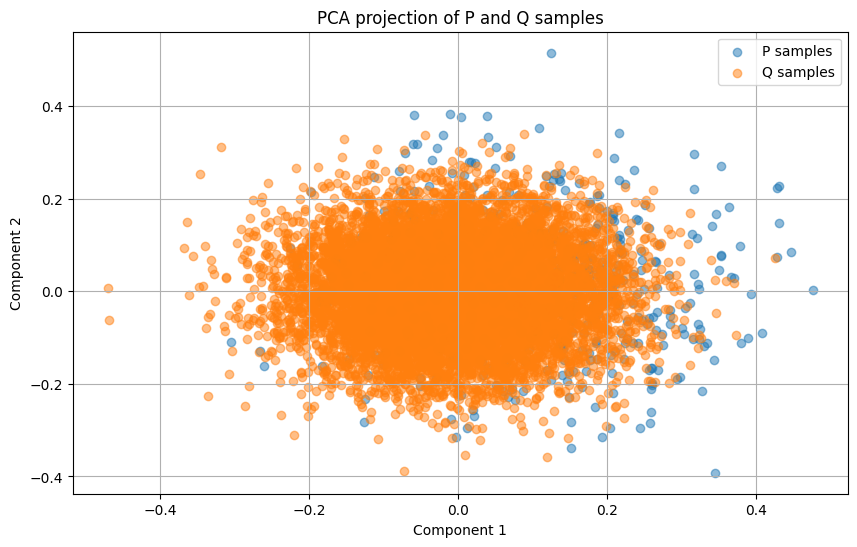

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


In [ ]:
comparison_model2 = ModelComparison(
    modelposterior=full_model,
    comparison_model=vi,
    save_path = trainer.save_path
)
r_vi = comparison_model2.compare_sample_metrics_batch(test_batch["x"][:5].cpu(), test_batch["y"][:5].cpu())

In [ ]:
print(r_vi)

([{'CST': {'accuracy': 0.851, 'roc_auc_score': 0.851}, 'MMD': 0.382432222366333, 'Wasserstein_distance with metric euclidean': 0.44791263341903687, 'mean_stats': {'absolute_mean_diff': tensor(0.0558), 'squared_mean_diff': tensor(0.0045), 'P_mean': tensor([-1.0746,  0.6922,  0.1665, -0.3666, -0.5925, -0.6509, -0.9716,  1.7523,
        -0.4697, -1.4973]), 'Q_mean': tensor([-0.9776,  0.7030,  0.2077, -0.3230, -0.5999, -0.7305, -0.9898,  1.6816,
        -0.3448, -1.4322])}, 'std_stats': {'absolute_std_diff': tensor(0.0654), 'squared_std_diff': tensor(0.0044), 'P_std': tensor([0.2018, 0.1914, 0.1939, 0.2014, 0.1959, 0.1951, 0.2007, 0.2001, 0.2074,
        0.2023]), 'Q_std': tensor([0.1268, 0.1334, 0.1499, 0.1359, 0.1262, 0.1344, 0.1170, 0.1246, 0.1604,
        0.1269])}, 'q_025_stats': {'absolute_q_025_diff': tensor(0.1429), 'squared_q_025_diff': tensor(0.0250), 'P_q_025': tensor([-1.4545,  0.3094, -0.1885, -0.7536, -0.9733, -1.0300, -1.3322,  1.3717,
        -0.8687, -1.9311]), 'Q_q_025': 

In [ ]:
print_wasserstein_distances(r_vi)

[0.44791263341903687, 0.35822588205337524, 0.3355266749858856, 0.37461939454078674, 0.3033846616744995]
0.3639338493347168


In [ ]:
comparison_model_gt_vi =  CompareComparisonModels(
    comparison_model_1=analytical_solution,
    comparison_model_2=vi,
    n_samples_comparison_model_1=10_000,
    save_path = trainer.save_path
)


.

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


...................


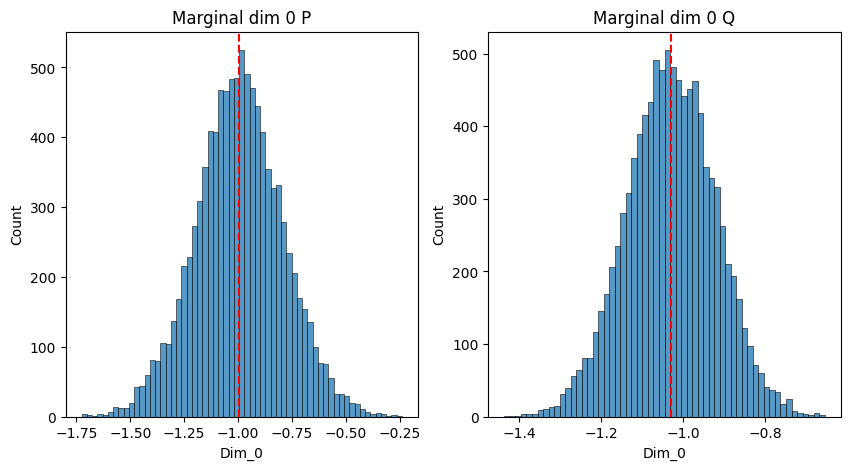

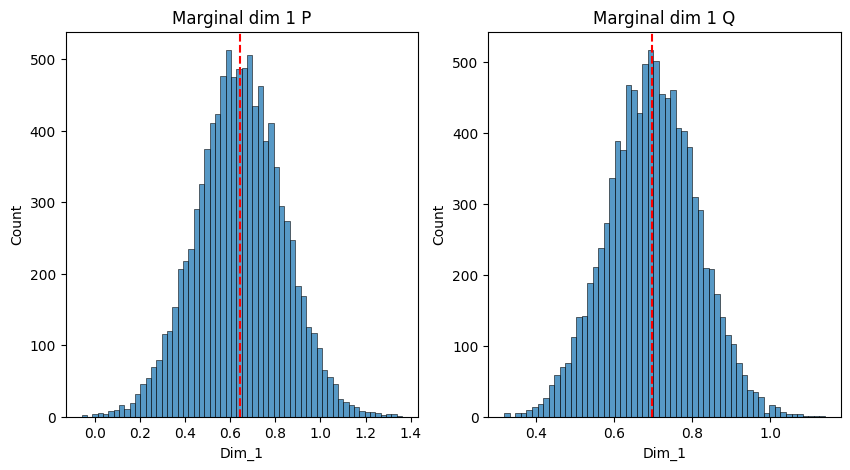

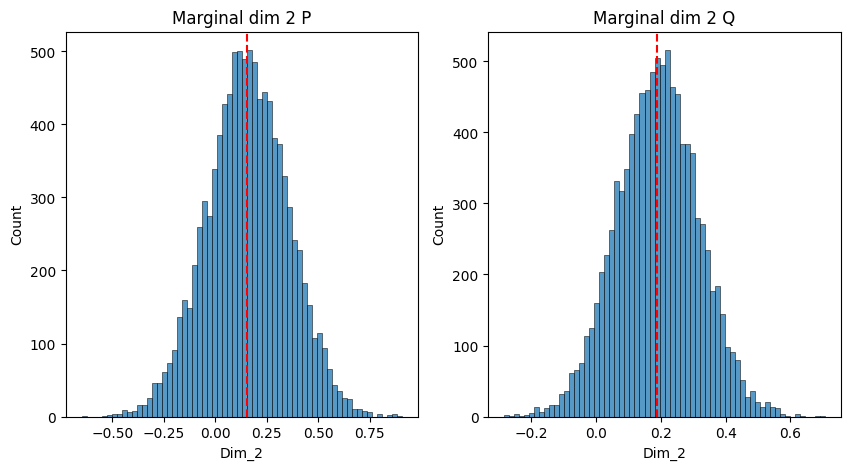

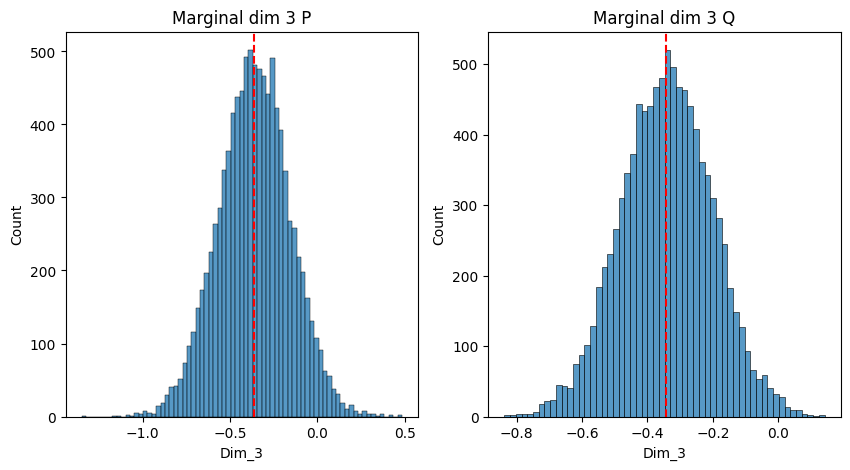

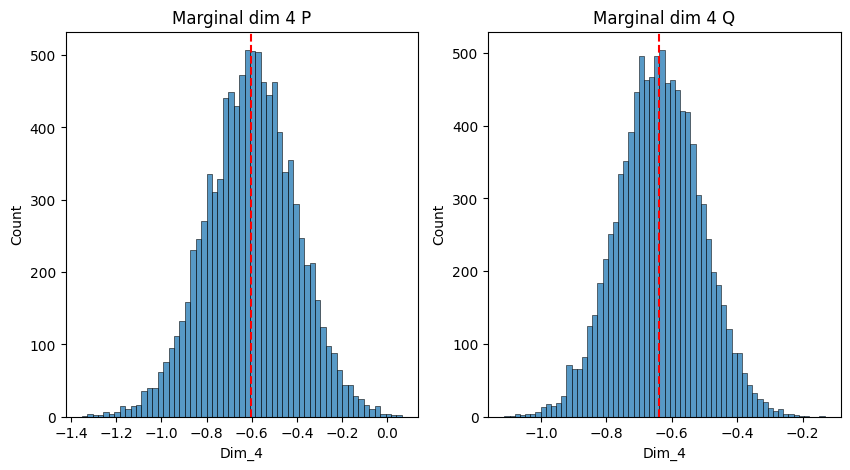

...

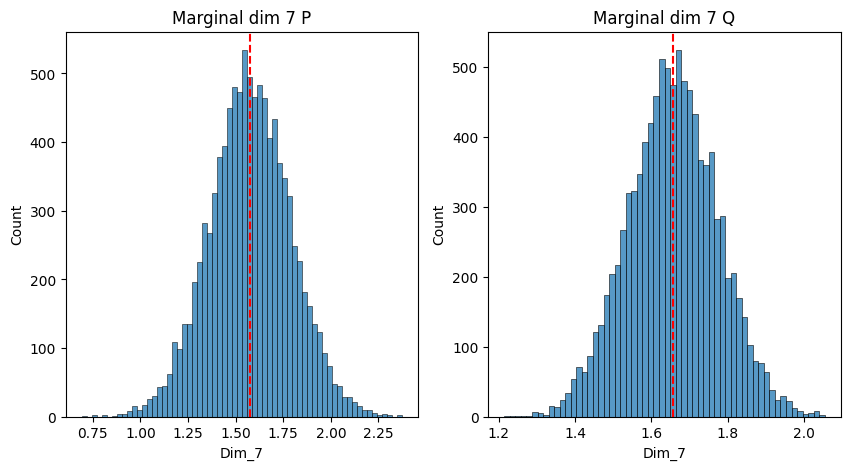

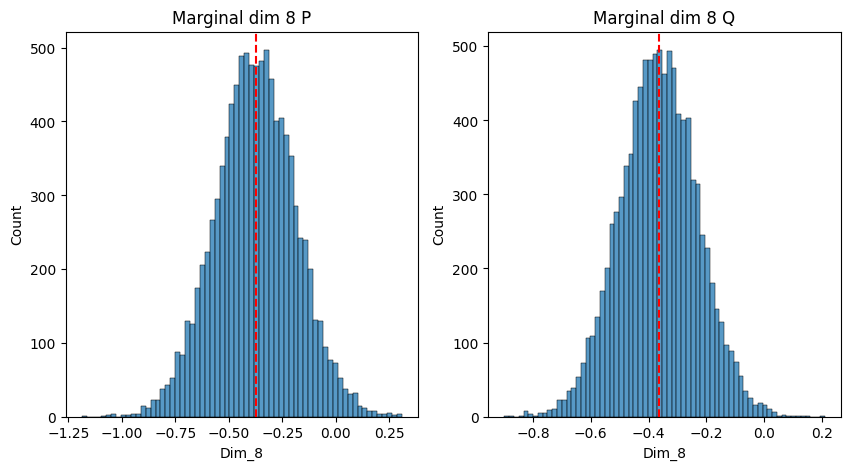

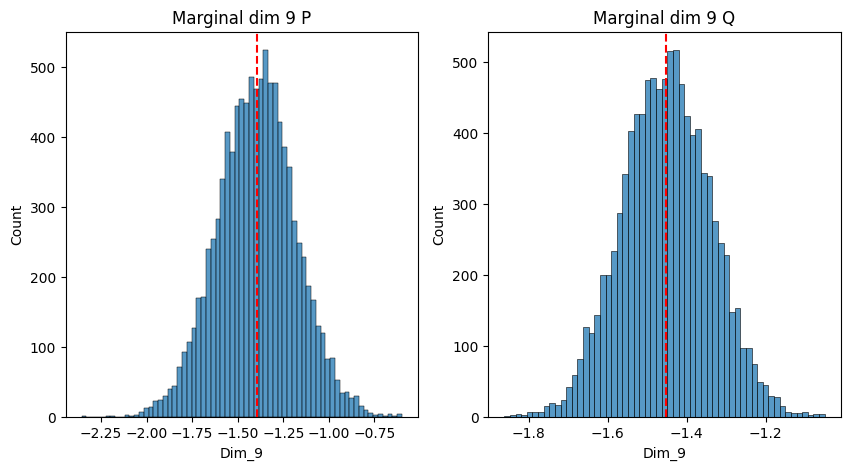

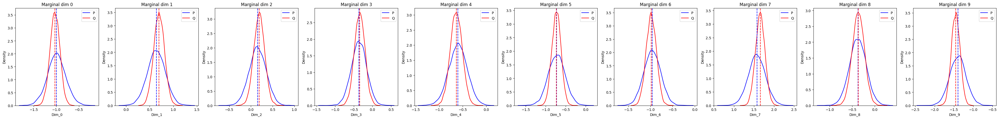

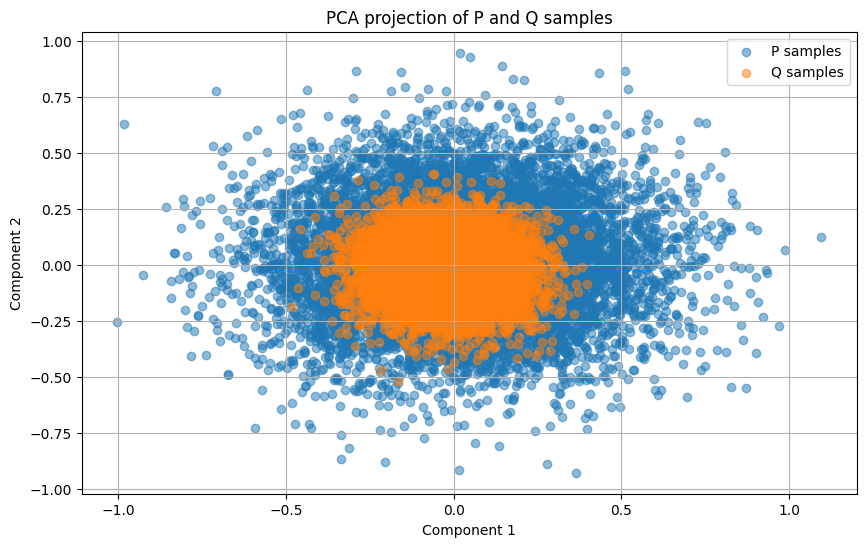

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


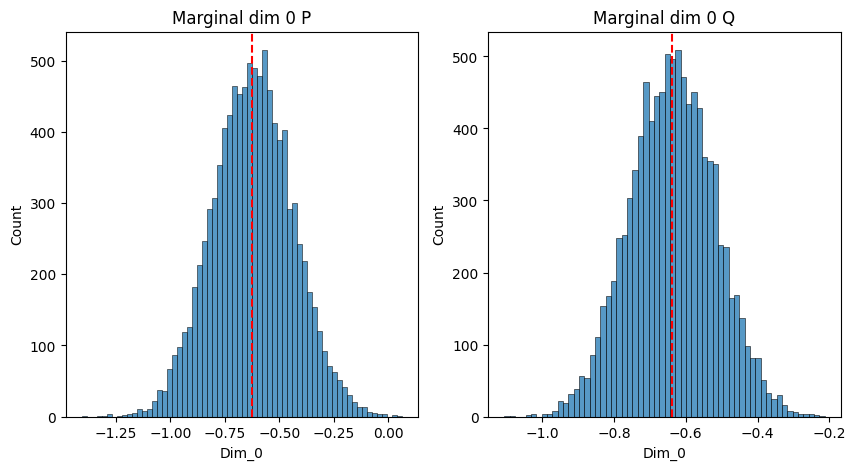

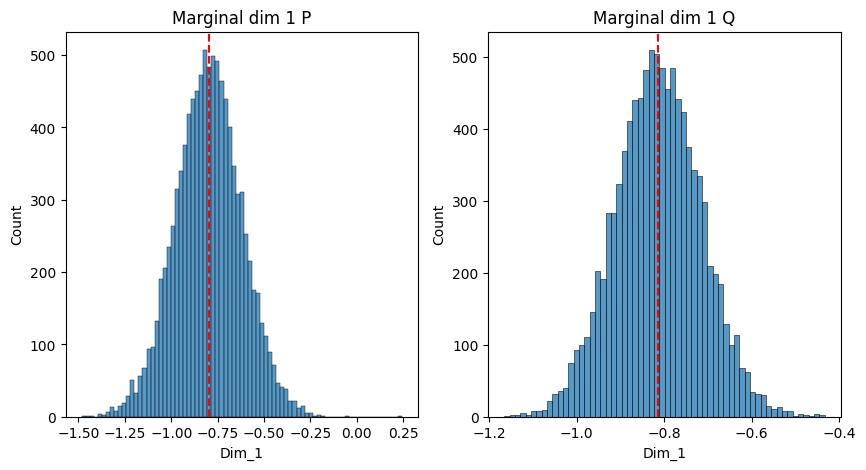

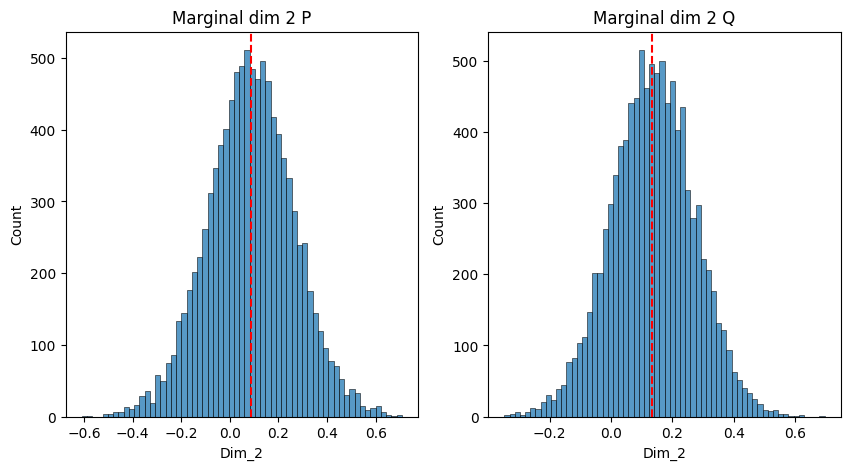

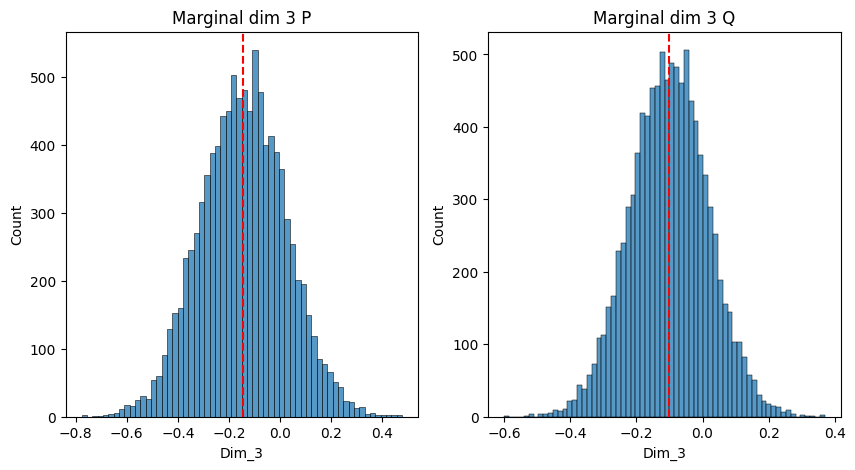

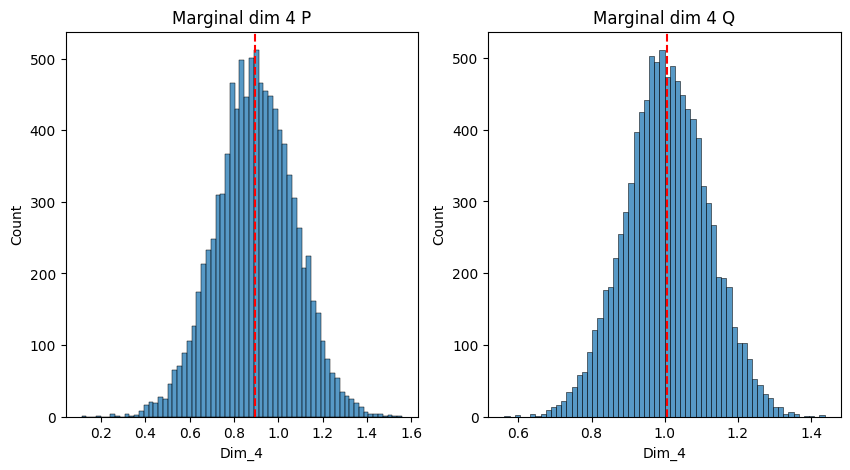

...

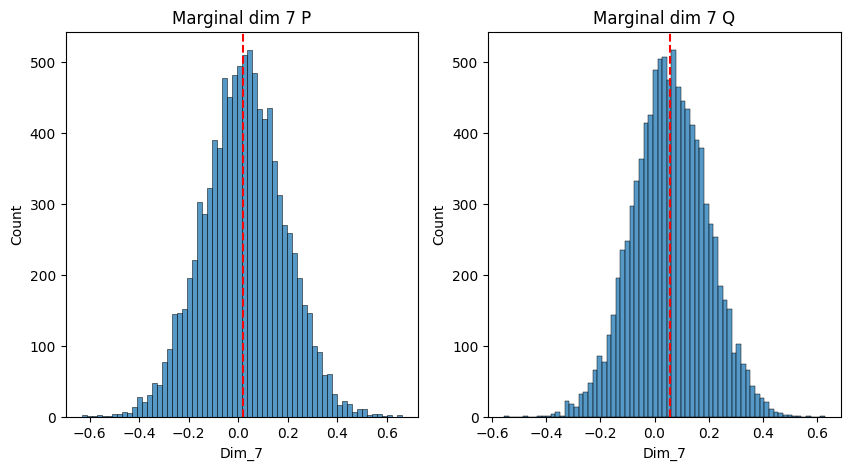

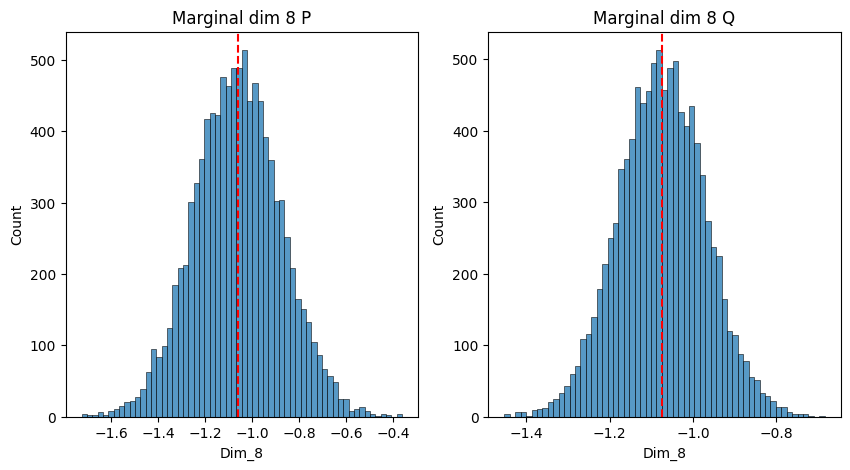

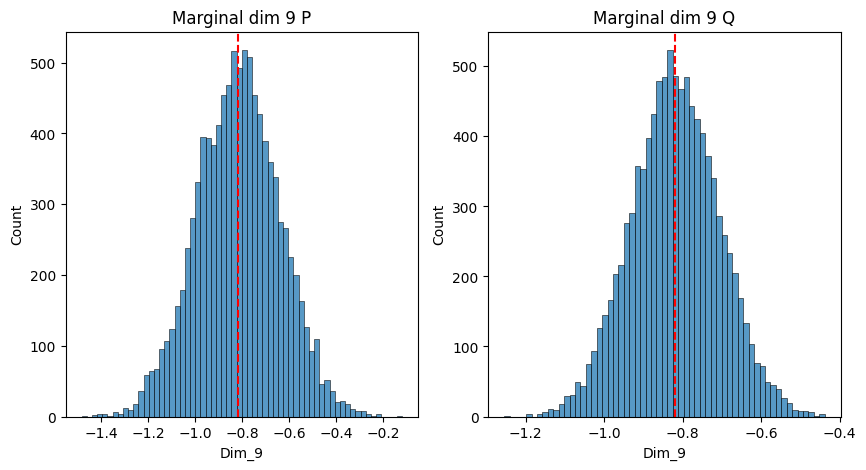

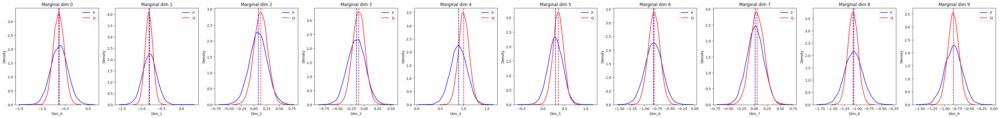

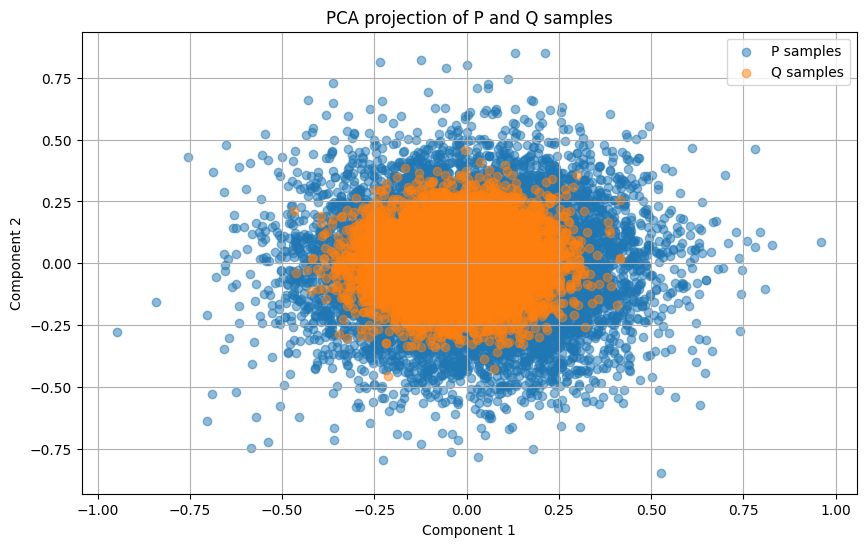

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


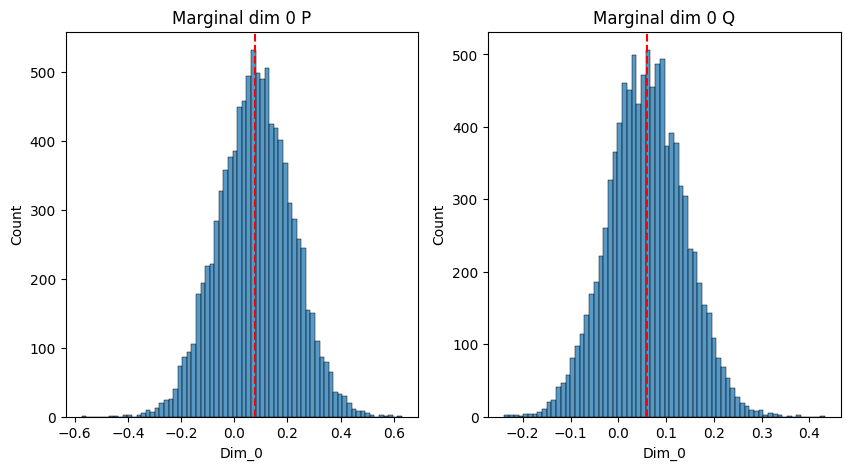

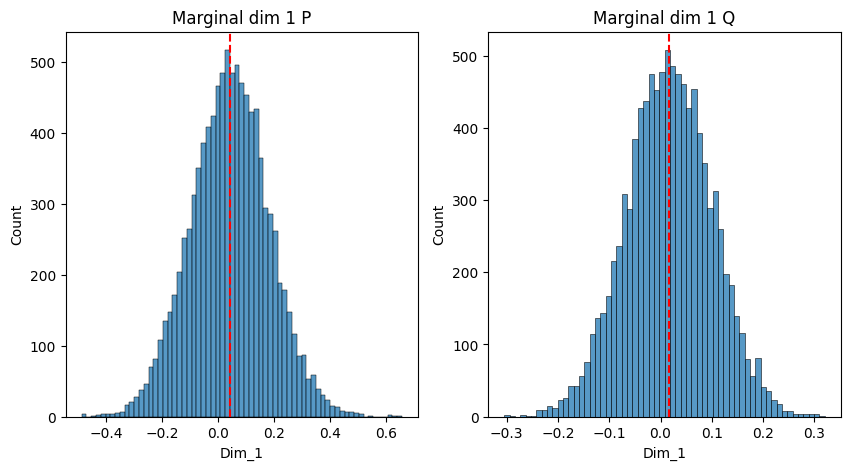

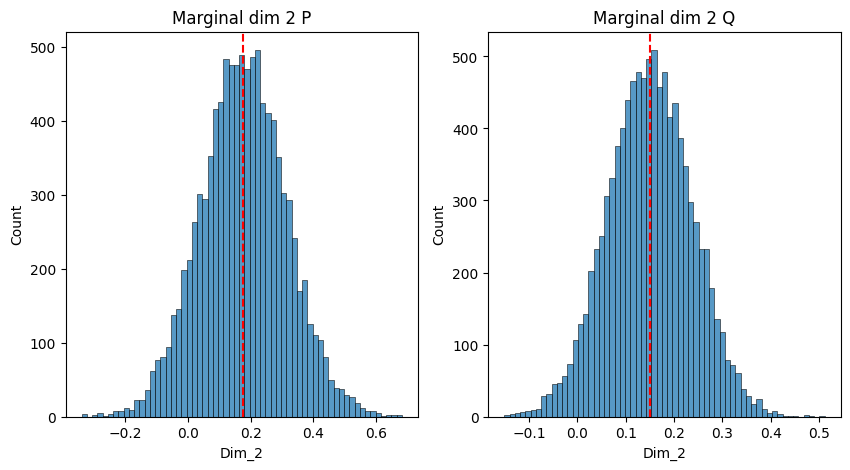

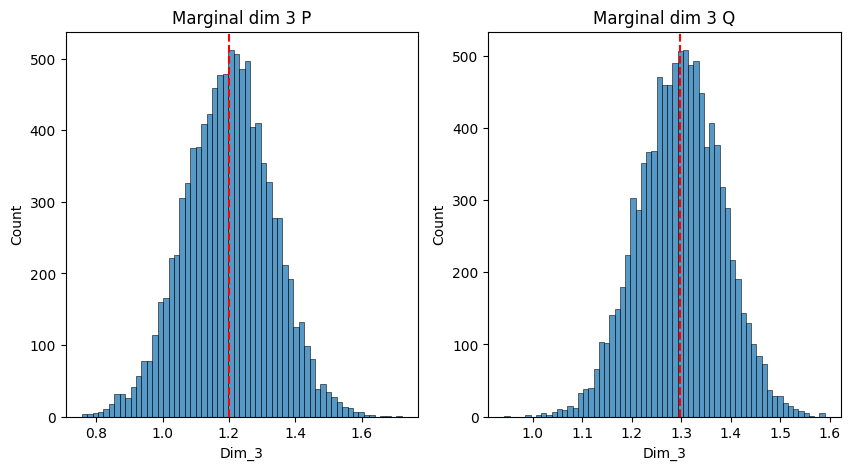

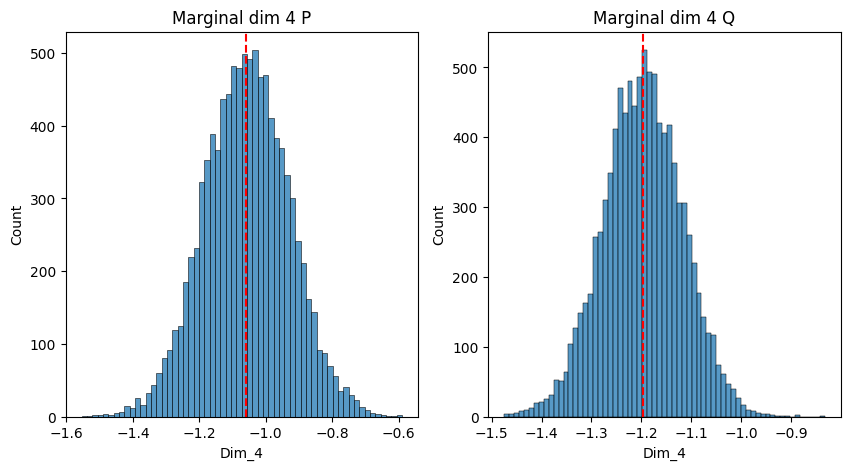

...

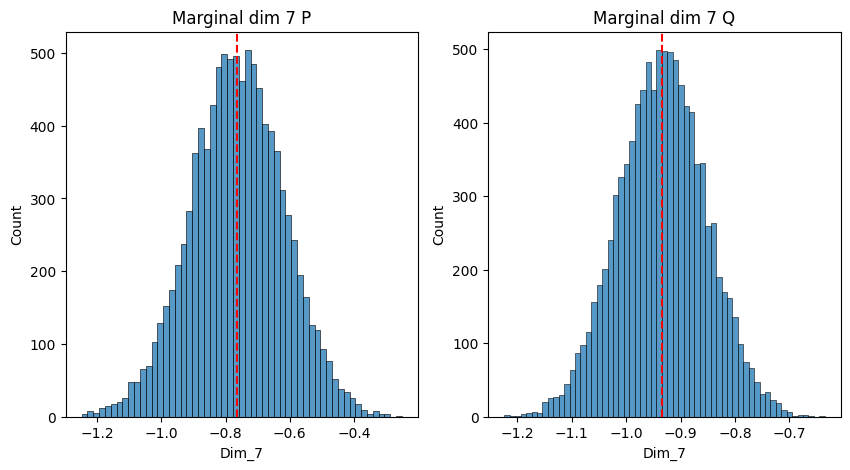

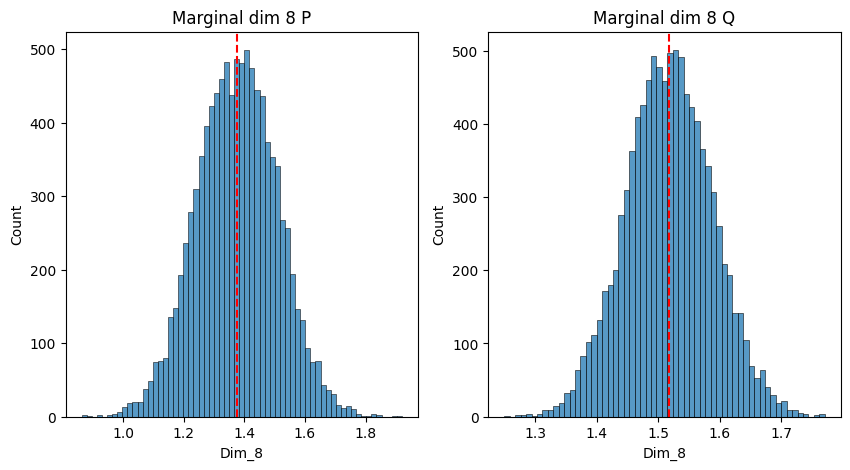

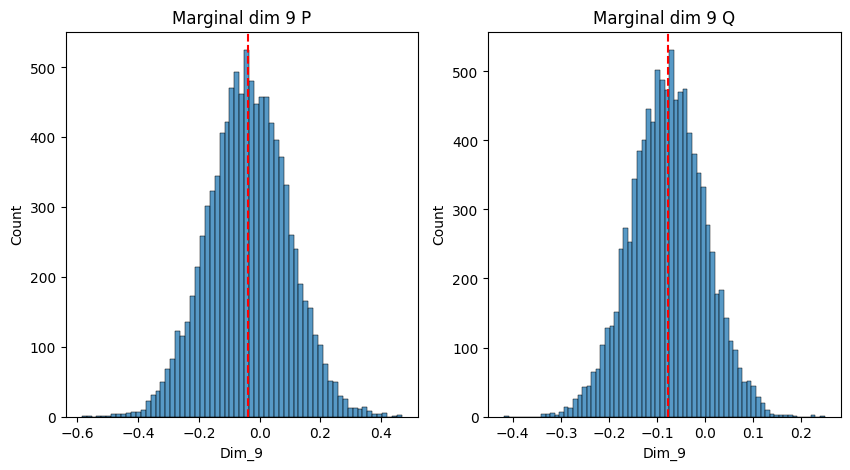

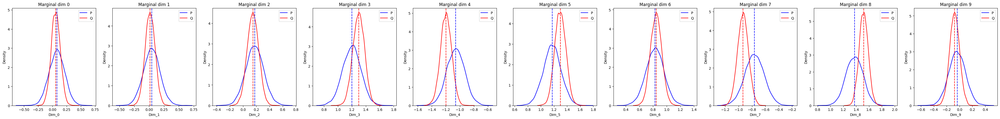

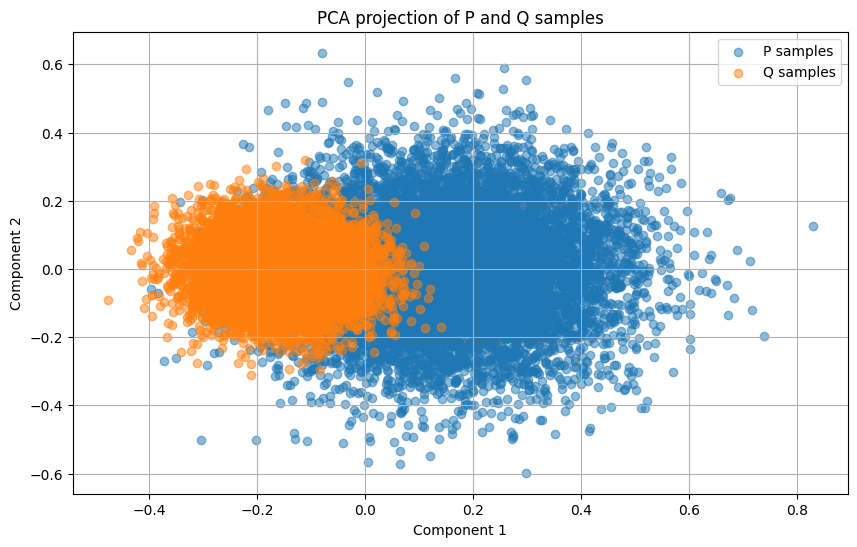

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


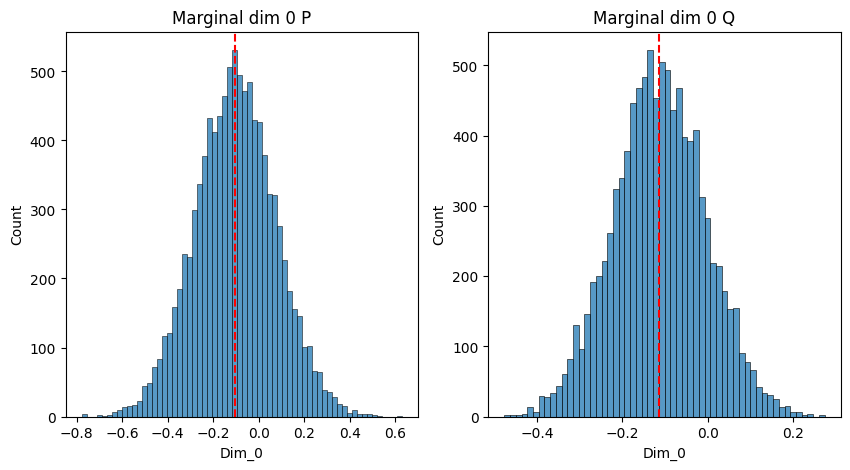

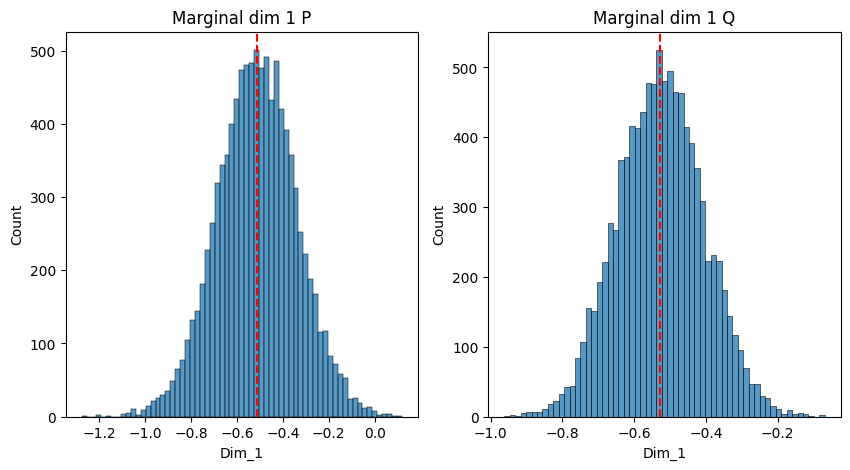

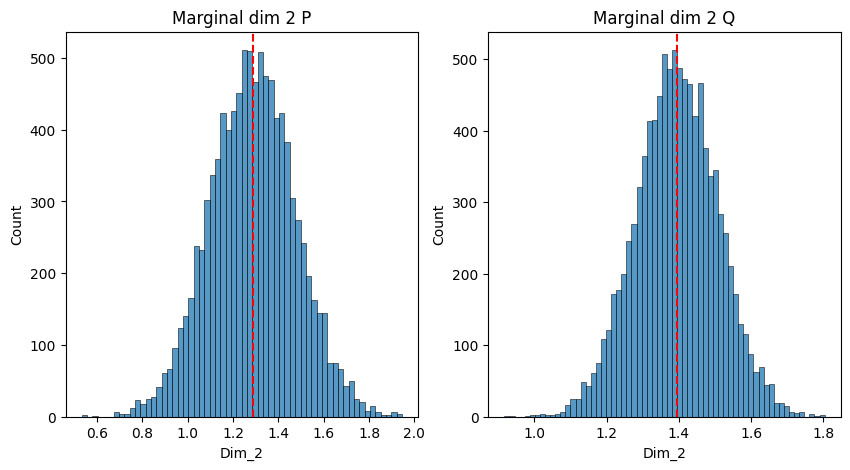

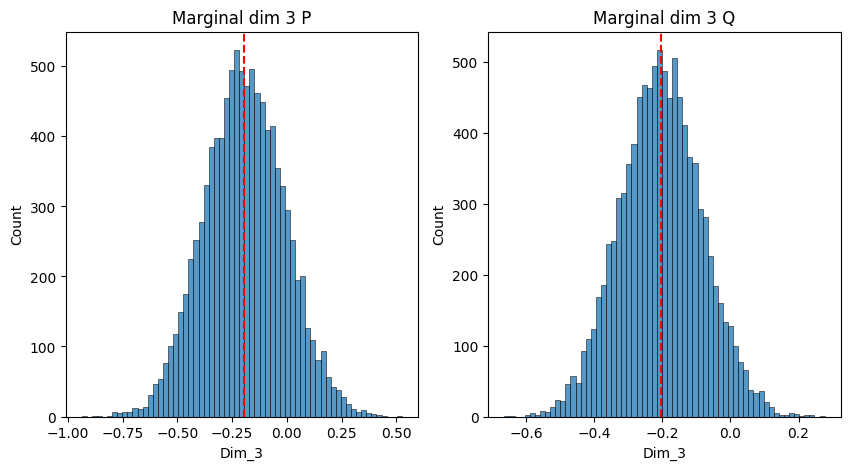

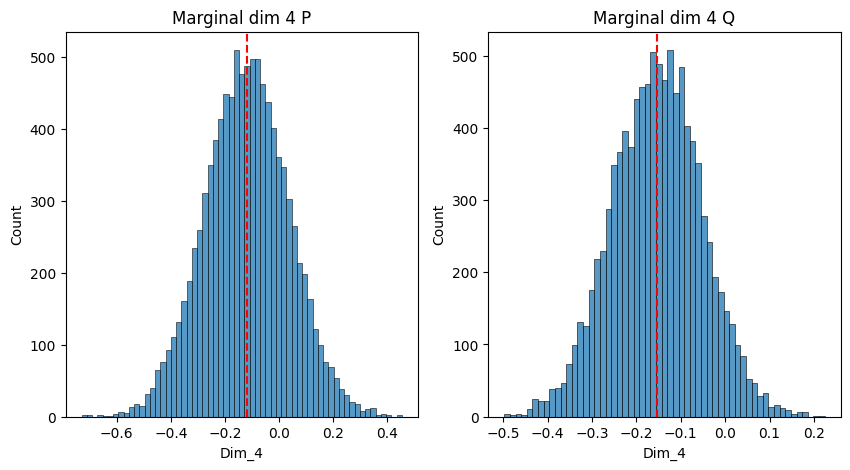

...

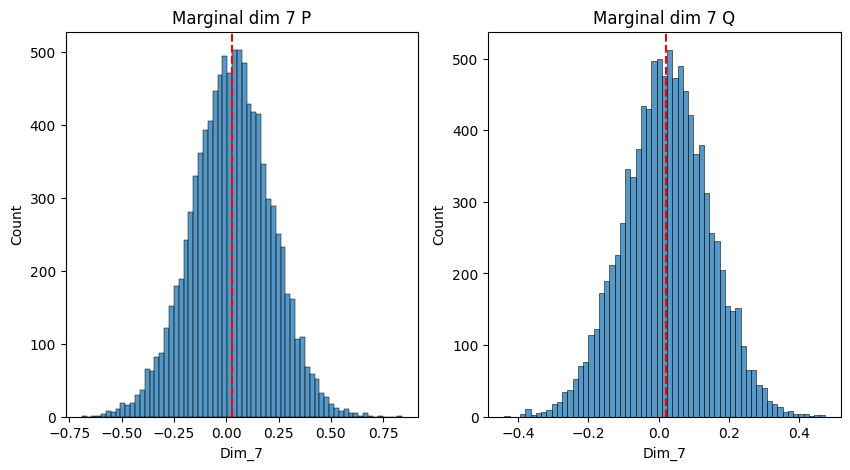

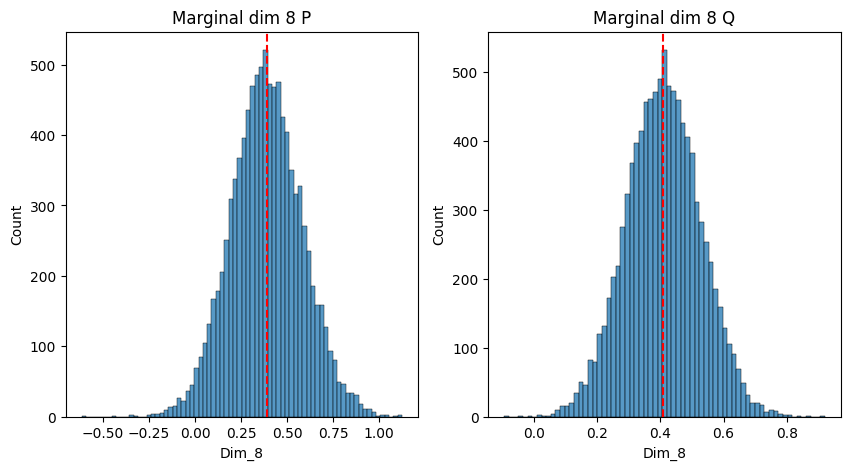

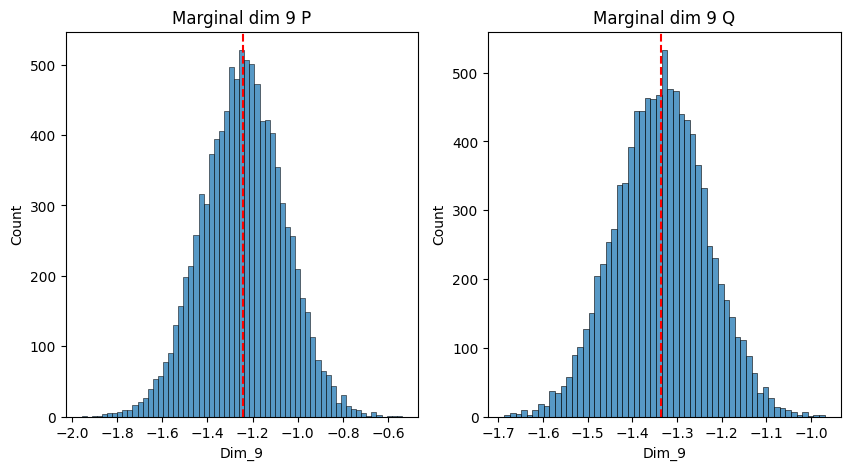

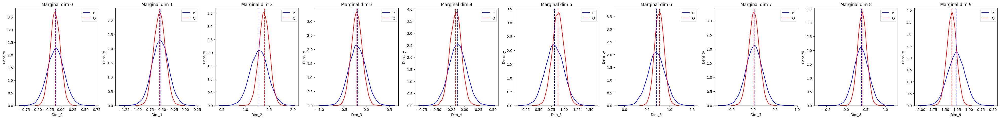

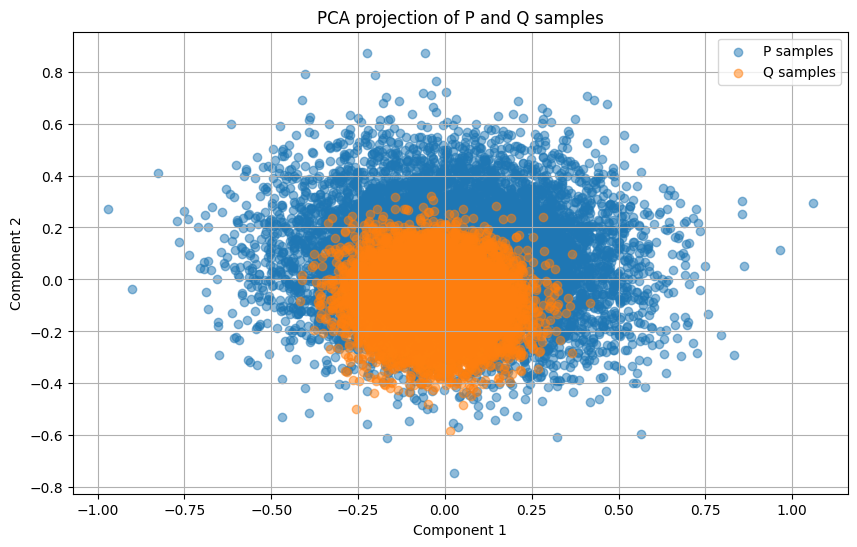

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)
/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


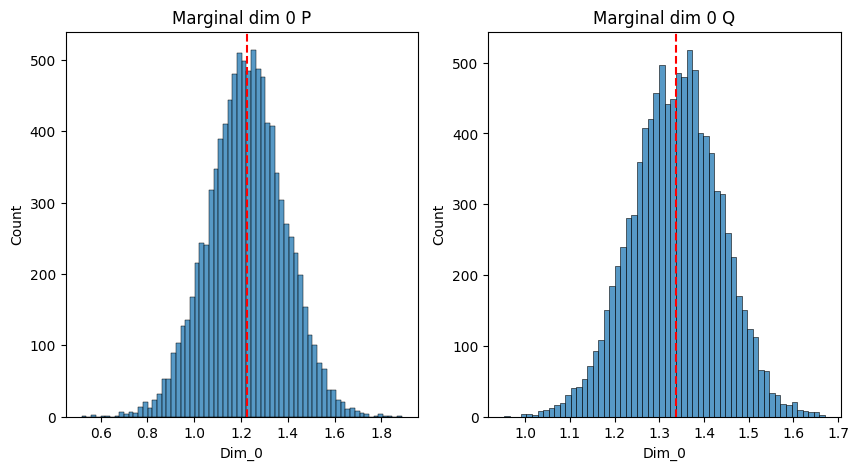

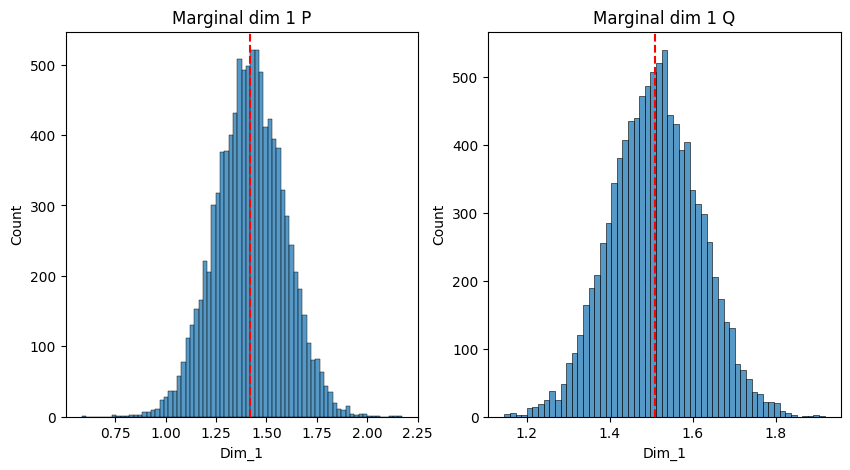

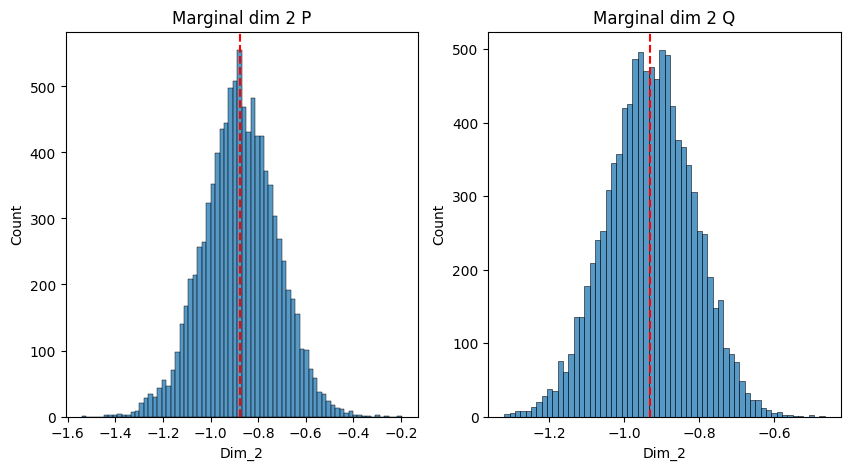

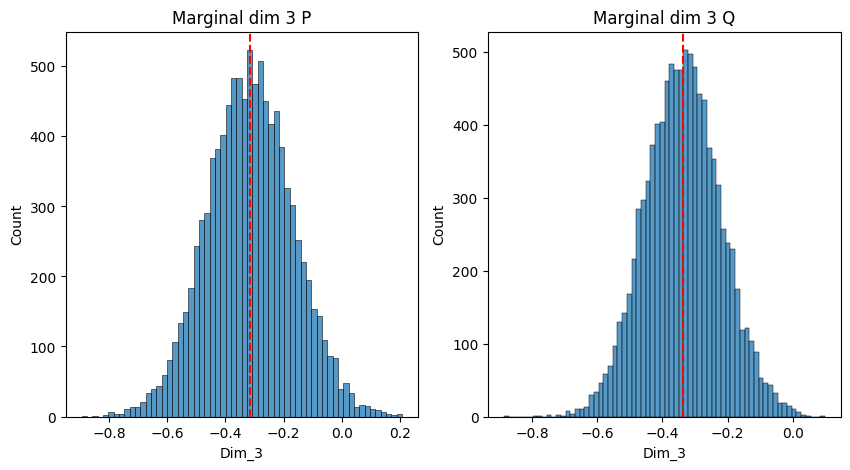

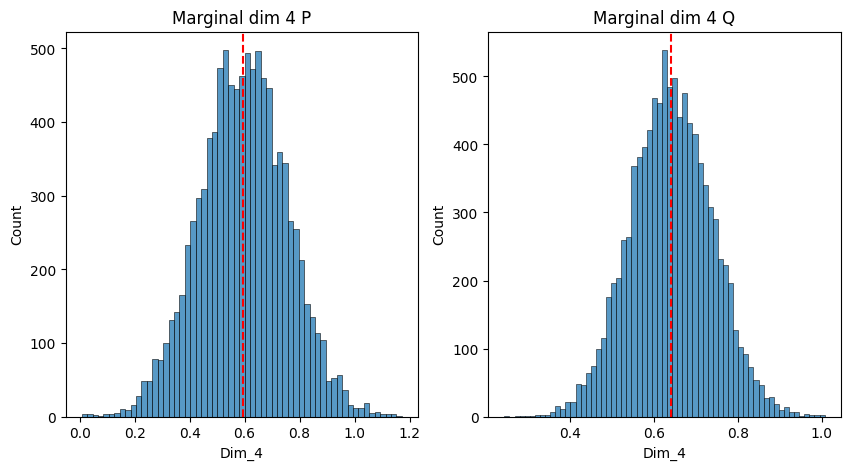

...

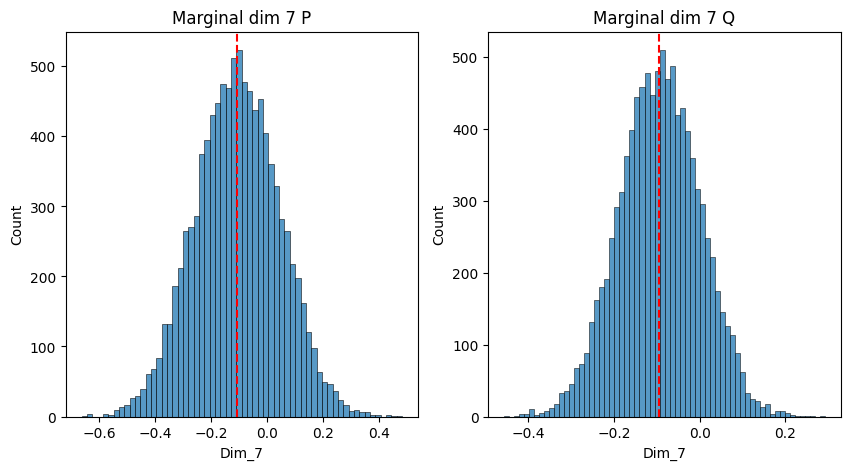

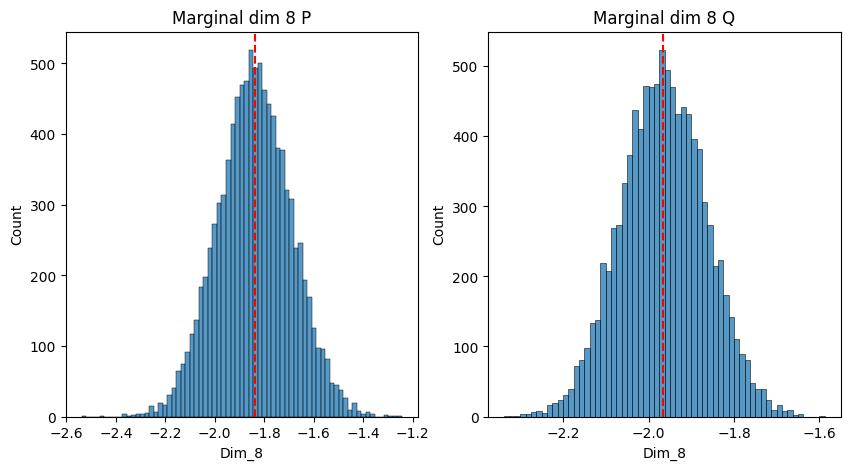

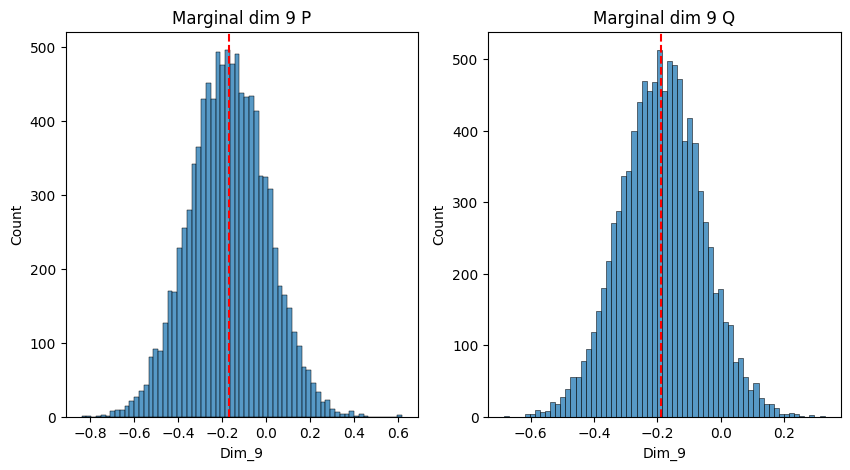

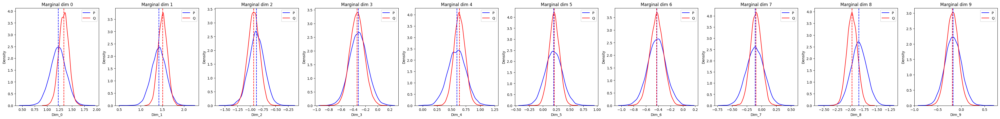

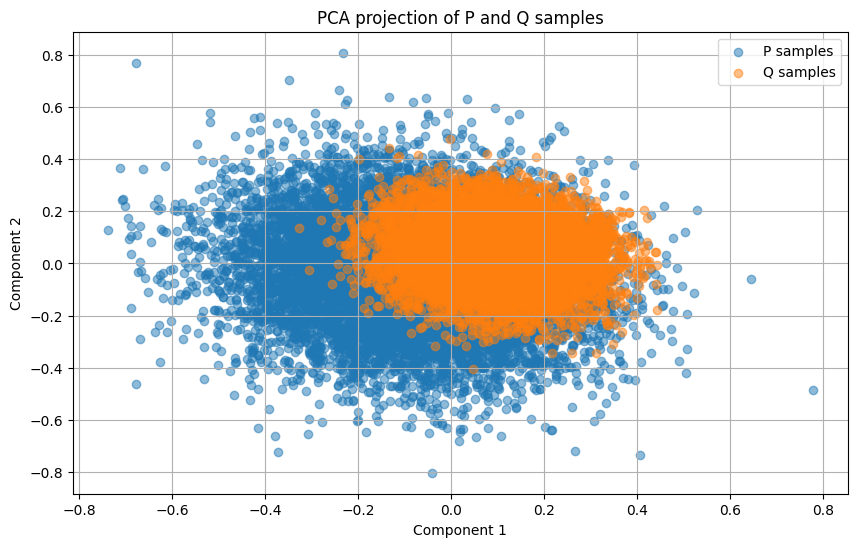

/usr/local/lib/python3.10/dist-packages/ot/lp/__init__.py:571: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  check_result(result_code)


([{'CST': {'accuracy': 0.8741000000000001, 'roc_auc_score': 0.8741000000000001}, 'MMD': 0.3836963176727295, 'Wasserstein_distance with metric euclidean': 0.40875568985939026, 'mean_stats': {'absolute_mean_diff': tensor(0.0356), 'squared_mean_diff': tensor(0.0018), 'P_mean': tensor([-0.9951,  0.6424,  0.1562, -0.3602, -0.6027, -0.7259, -0.9593,  1.5740,
        -0.3750, -1.3962]), 'Q_mean': tensor([-1.0302,  0.6991,  0.1901, -0.3421, -0.6381, -0.7324, -0.9823,  1.6560,
        -0.3651, -1.4515])}, 'std_stats': {'absolute_std_diff': tensor(0.0803), 'squared_std_diff': tensor(0.0067), 'P_std': tensor([0.2024, 0.1914, 0.1970, 0.2052, 0.1969, 0.2113, 0.1901, 0.2140, 0.1874,
        0.2125]), 'Q_std': tensor([0.1088, 0.1136, 0.1250, 0.1400, 0.1265, 0.1127, 0.1153, 0.1175, 0.1339,
        0.1123])}, 'q_025_stats': {'absolute_q_025_diff': tensor(0.1619), 'squared_q_025_diff': tensor(0.0285), 'P_q_025': tensor([-1.4001,  0.2602, -0.2317, -0.7632, -0.9942, -1.1368, -1.3252,  1.1570,
        -0.7

In [ ]:
r_vi_gt = comparison_model_gt_vi.compare_sample_metrics_batch(test_batch["x"][:5], test_batch["y"][:5])
print(r_vi_gt)

In [ ]:
print_wasserstein_distances(r_vi_gt)

[0.40875568985939026, 0.3579156994819641, 0.4064515233039856, 0.3871266841888428, 0.36089691519737244]
0.38422930240631104


In [ ]:
comparison_model_comparer = CompareComparisonModels(
    comparison_model_1=vi,
    comparison_model_2=hmc_sampler,
    n_samples_comparison_model_1=1000,
    save_path = trainer.save_path
)

.

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


...................


Sample: 100%|██████████| 800/800 [00:55, 14.32it/s, step size=1.86e-01, acc. prob=0.930]


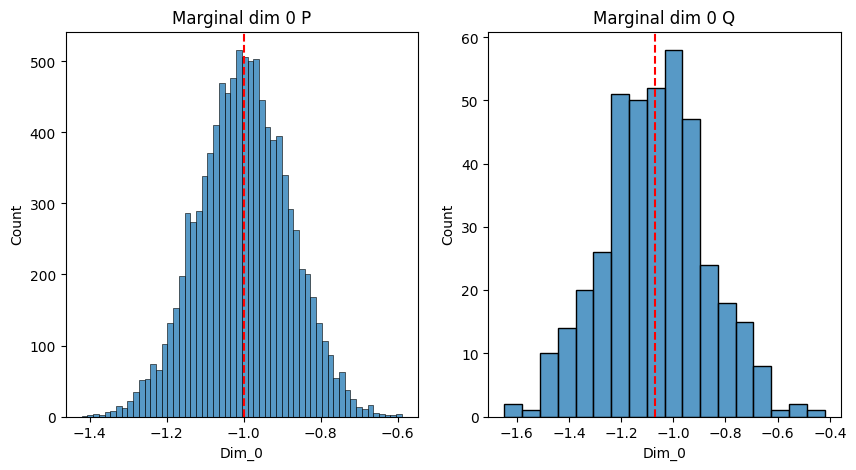

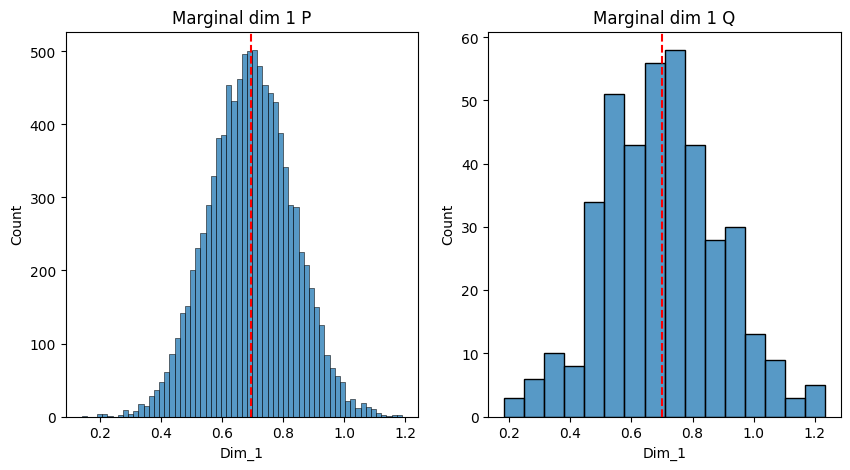

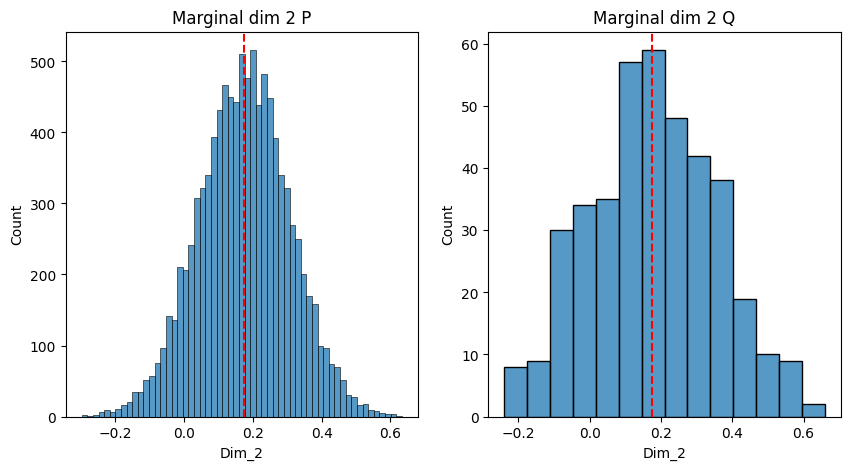

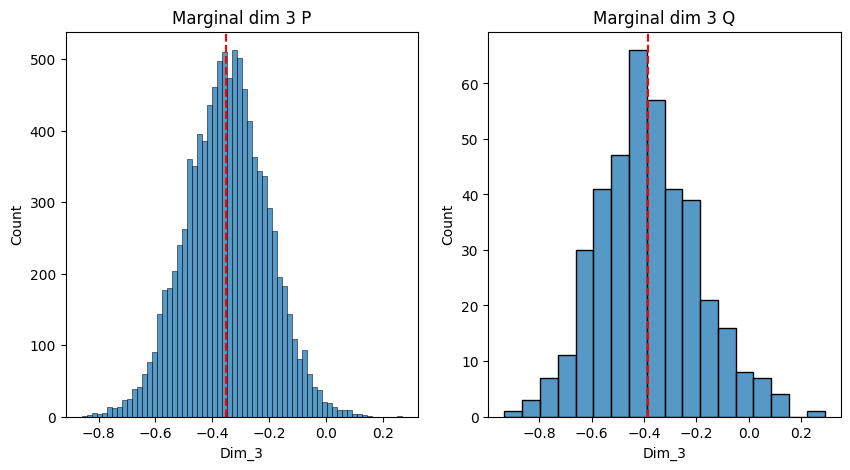

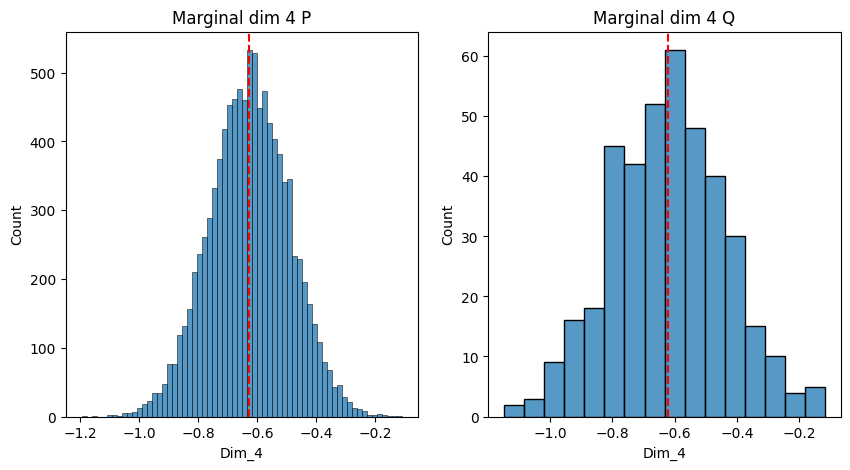

...

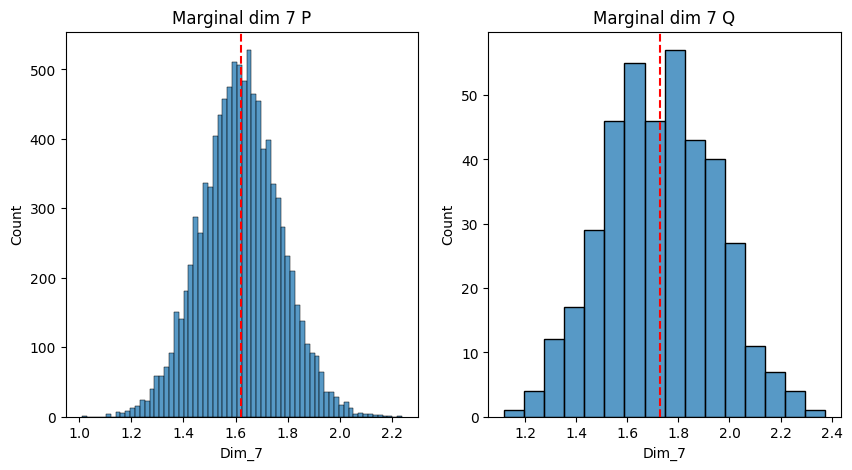

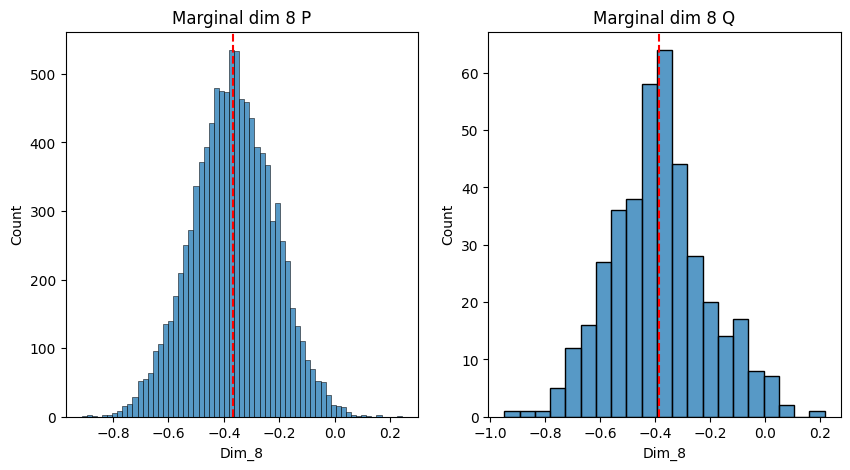

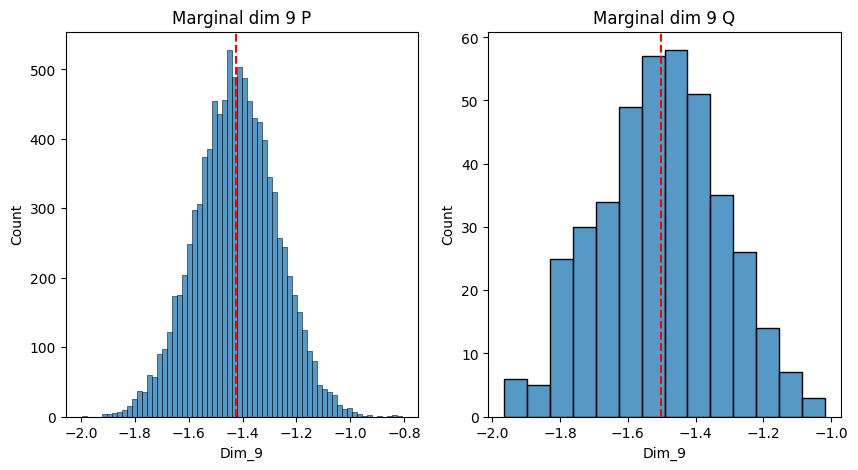

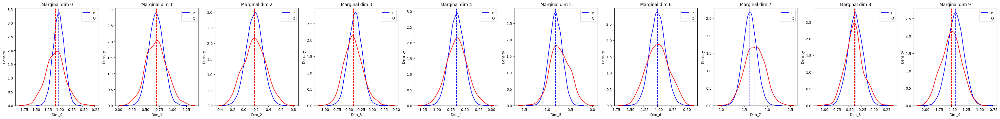

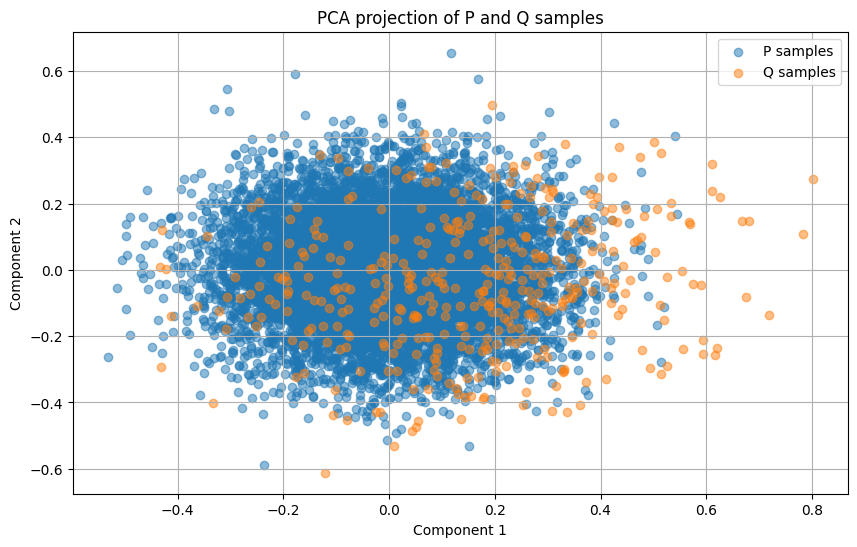

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


Sample: 100%|██████████| 800/800 [00:49, 16.22it/s, step size=2.02e-01, acc. prob=0.926]


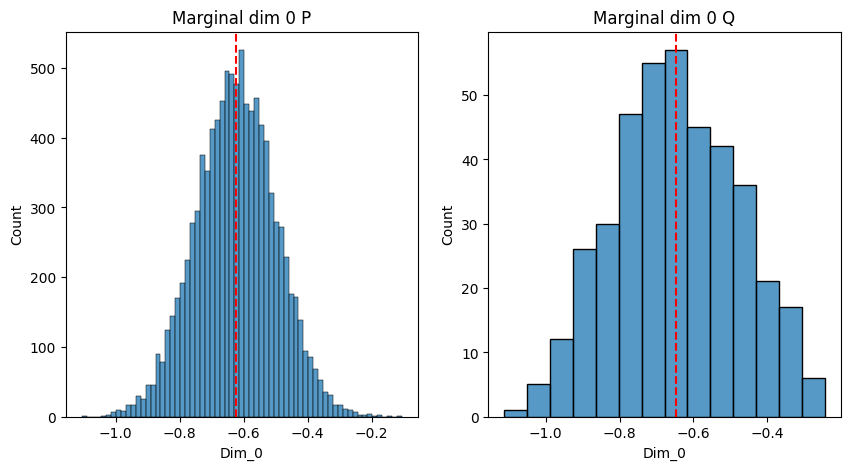

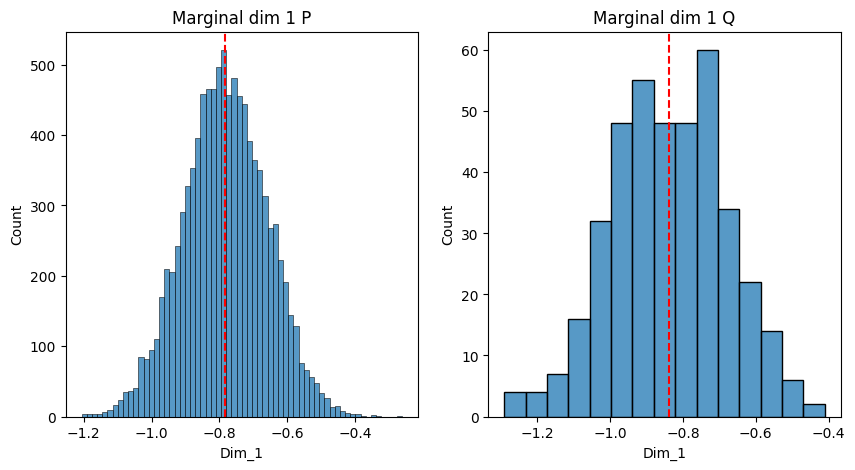

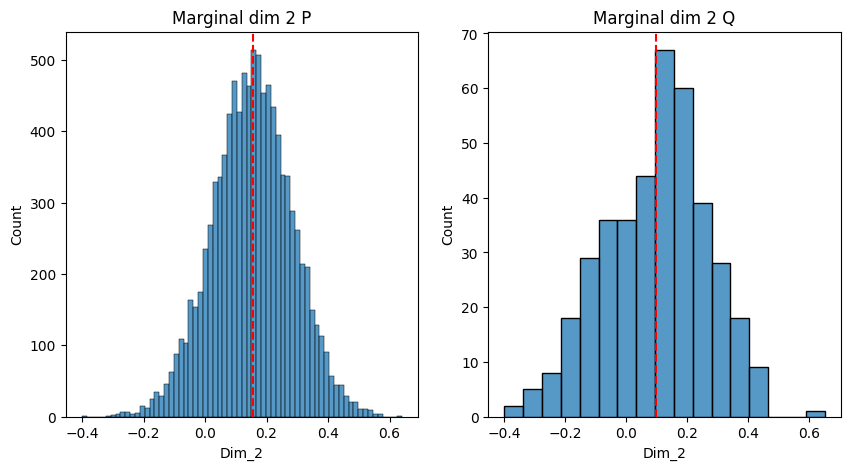

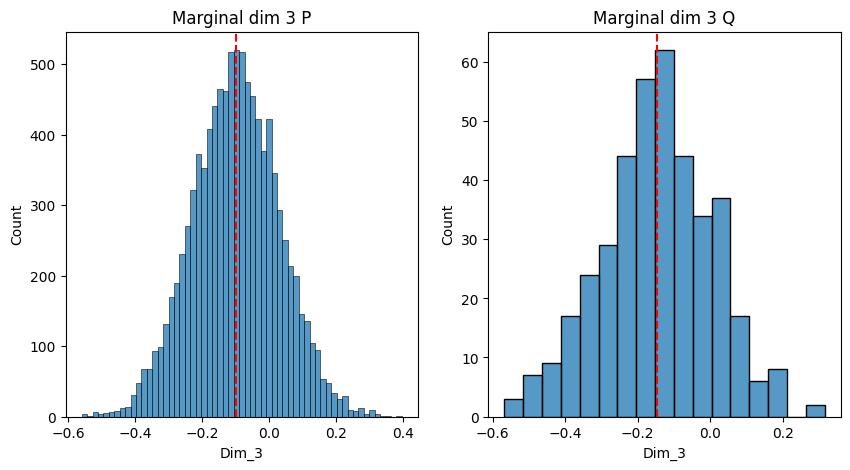

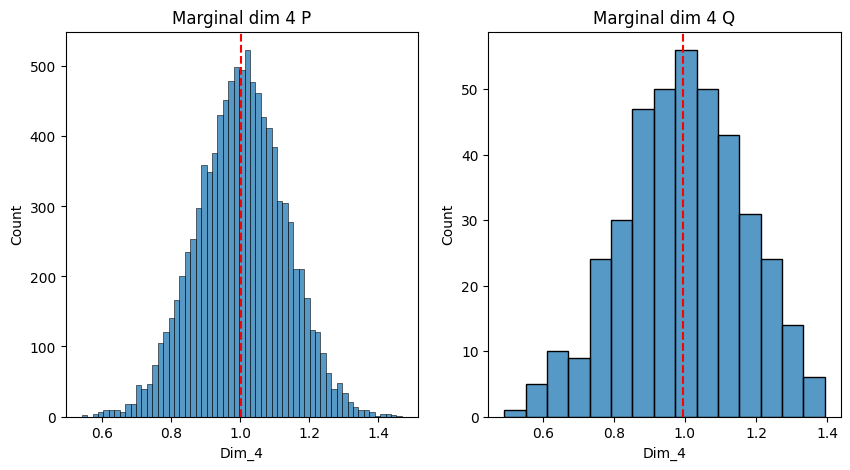

...

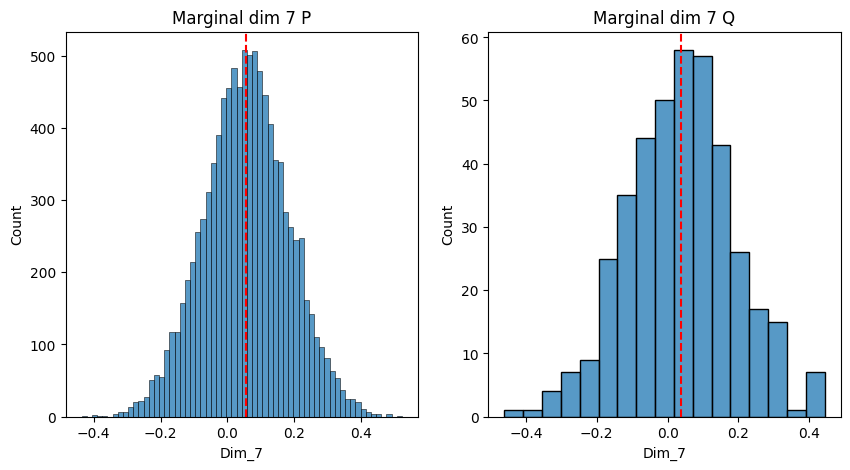

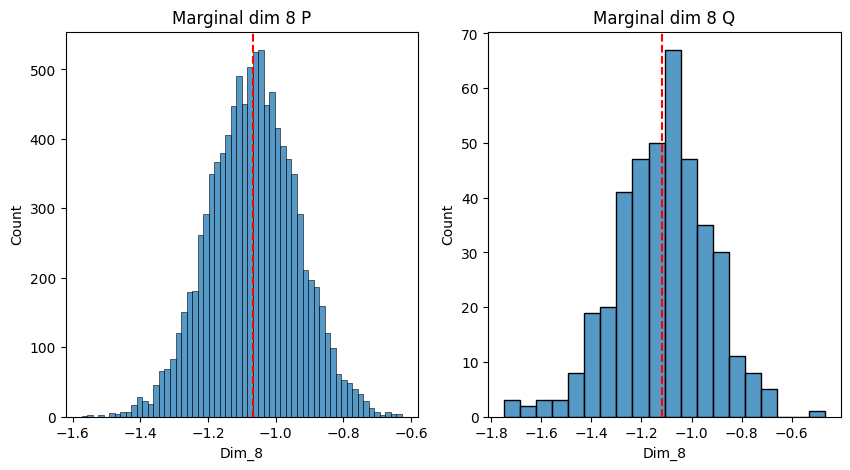

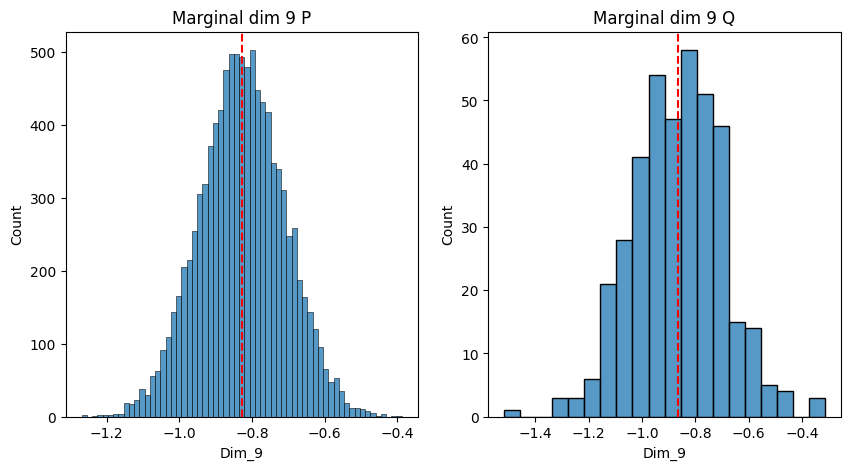

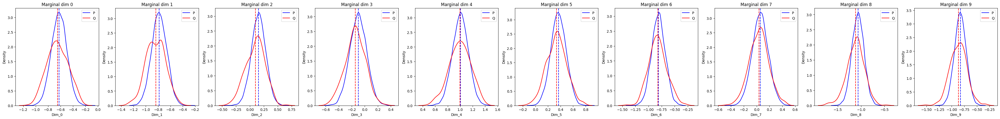

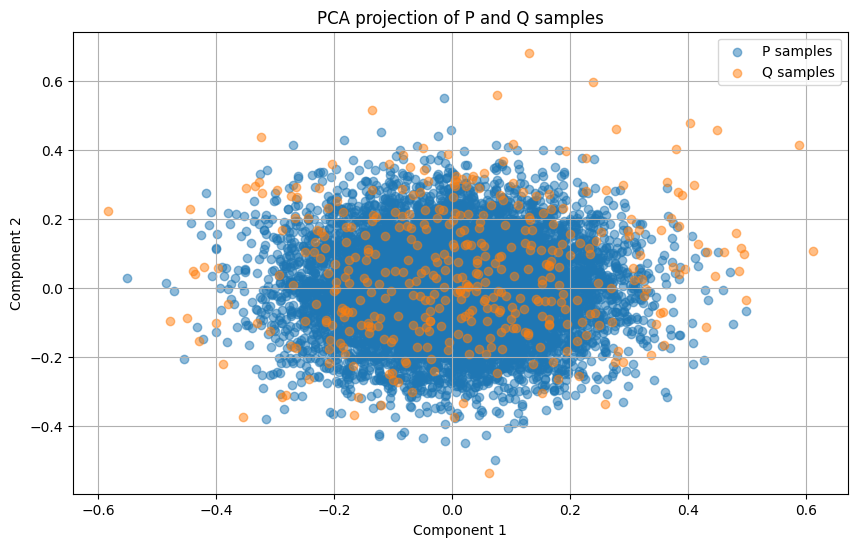

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


Sample: 100%|██████████| 800/800 [00:58, 13.71it/s, step size=1.69e-01, acc. prob=0.944]


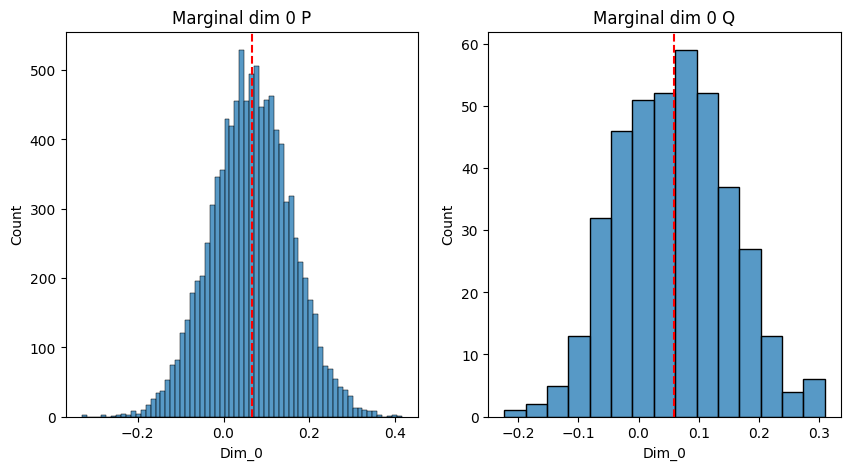

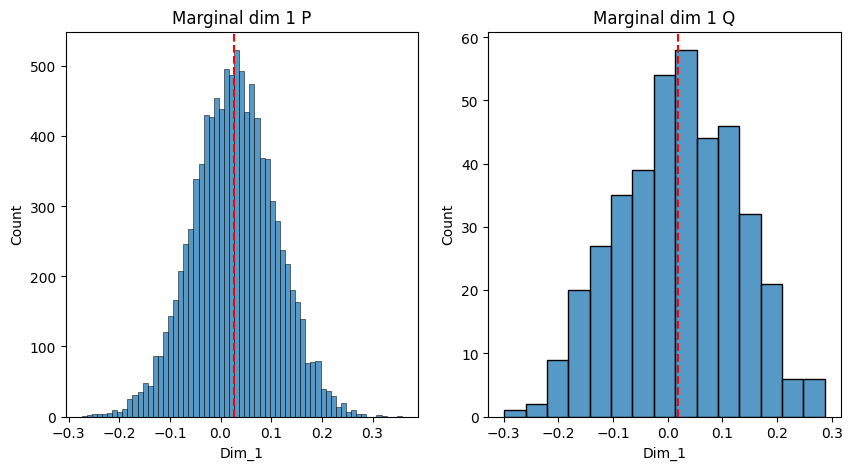

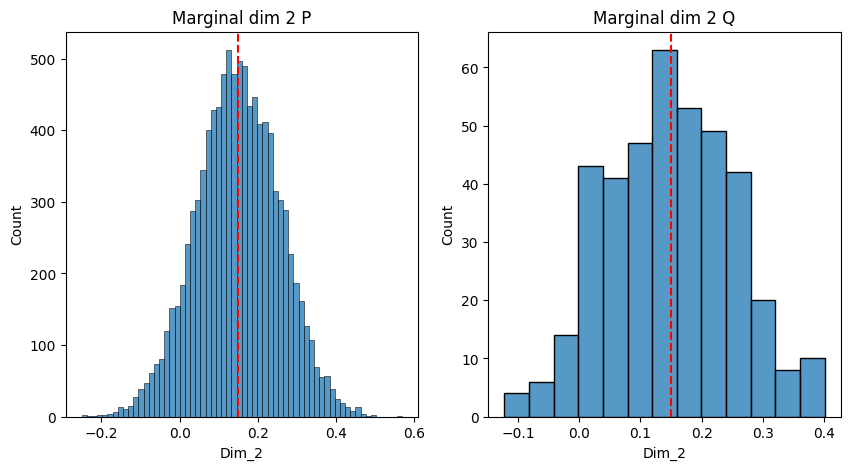

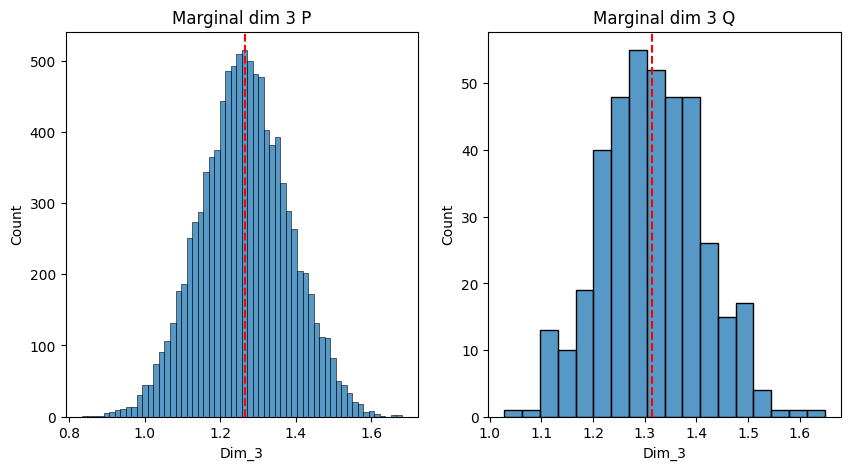

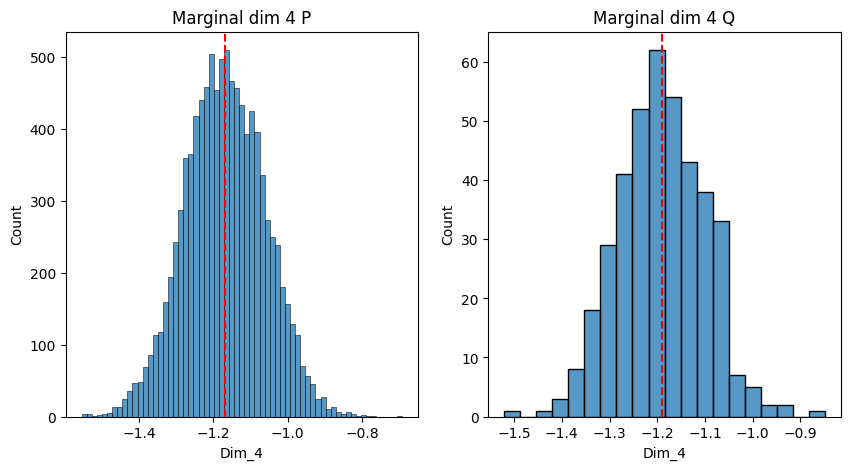

...

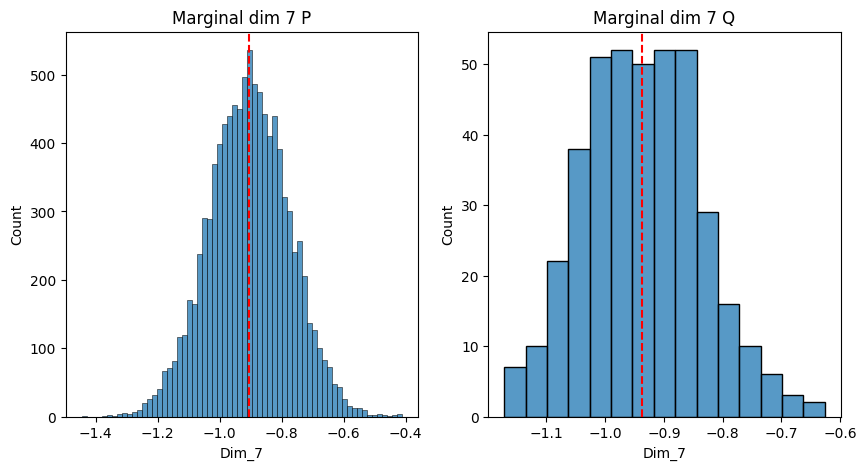

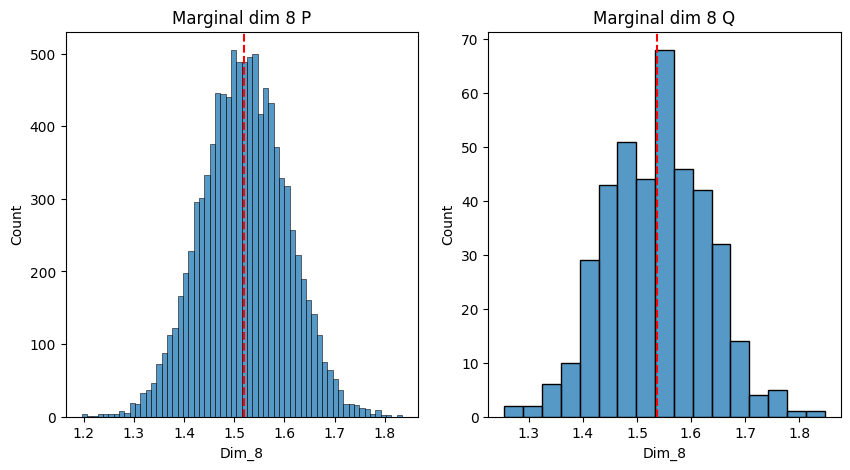

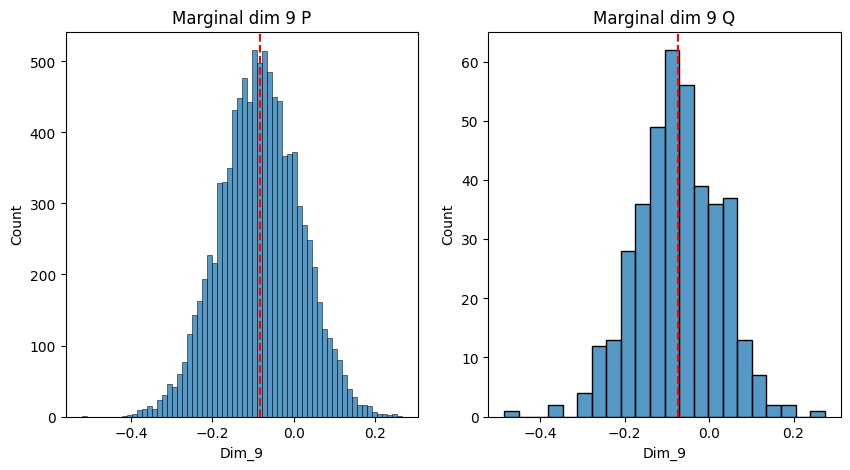

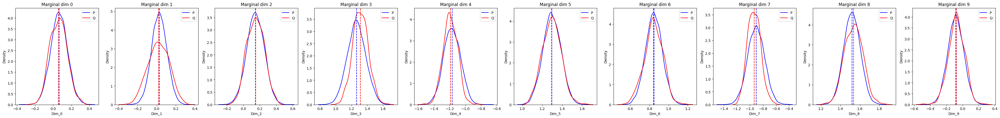

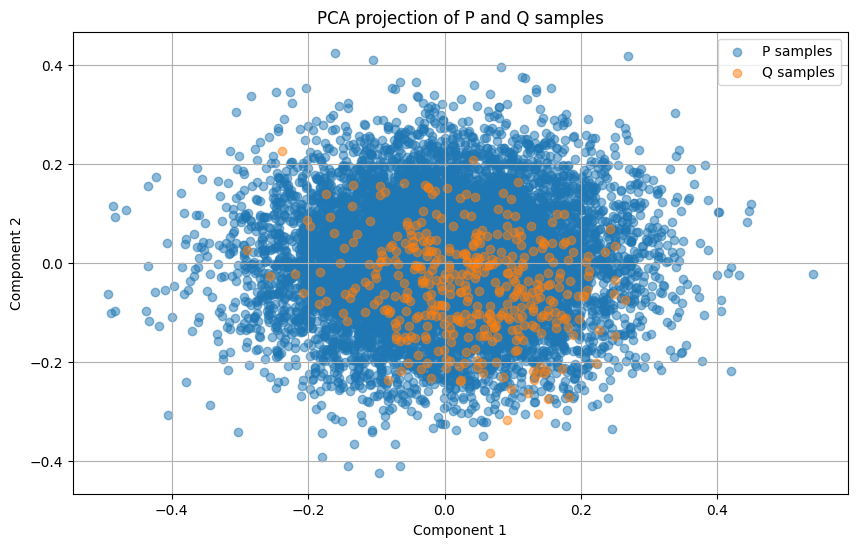

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


Sample: 100%|██████████| 800/800 [00:58, 13.70it/s, step size=1.85e-01, acc. prob=0.934]


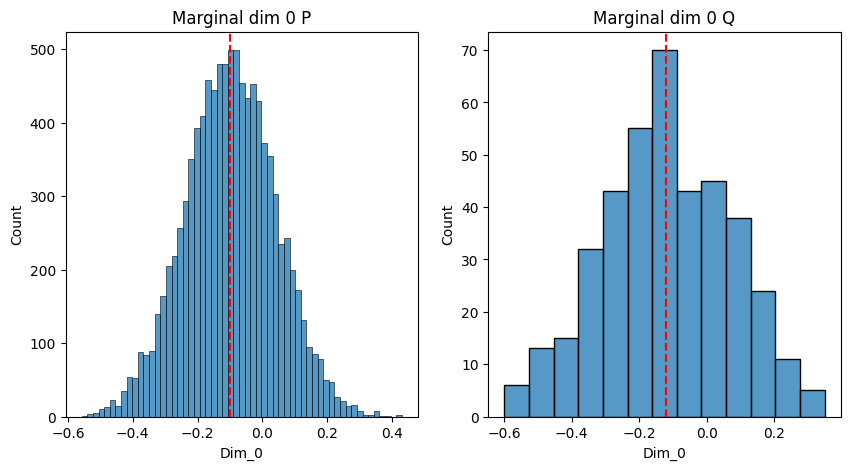

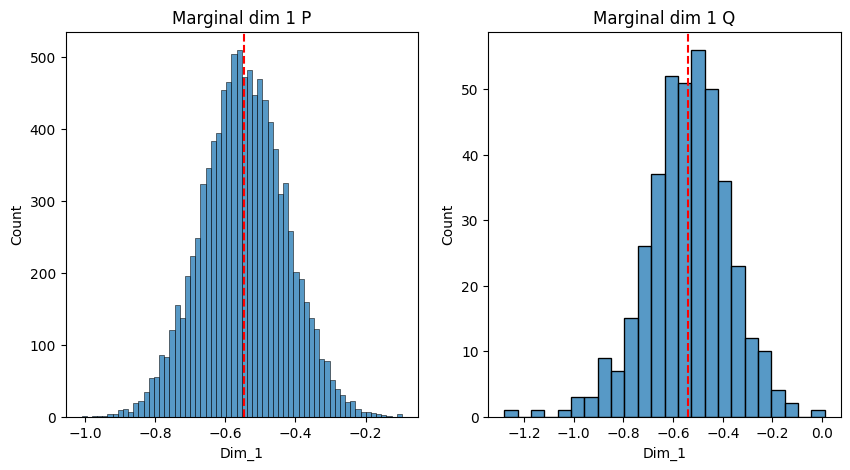

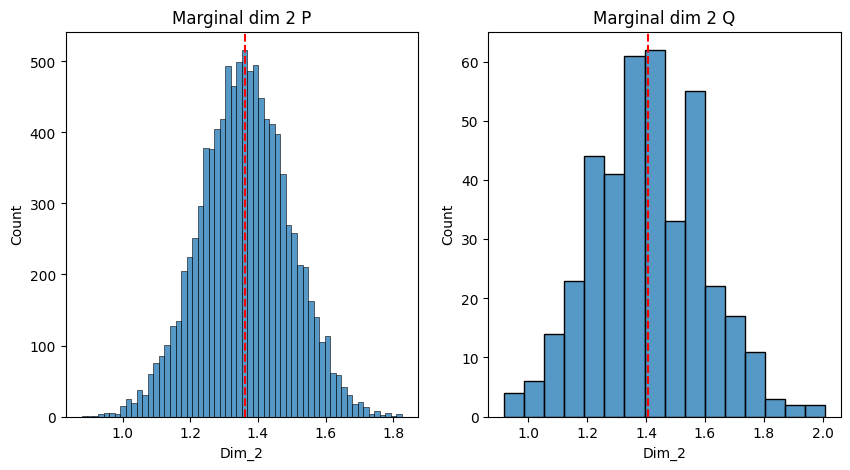

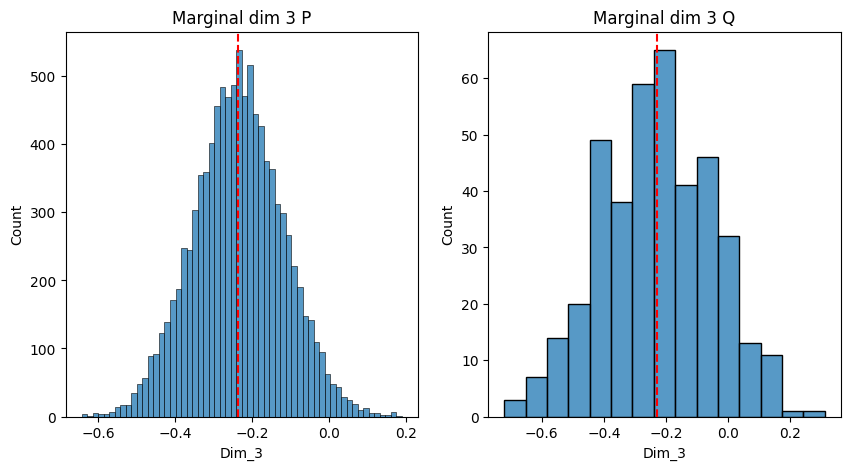

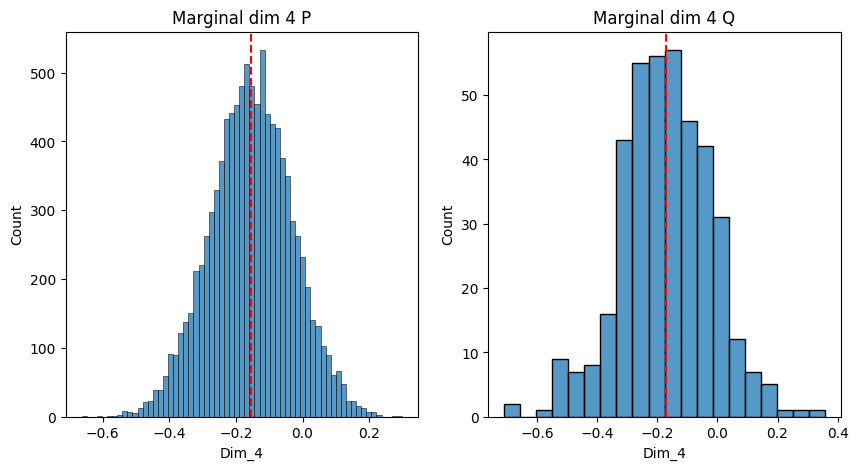

...

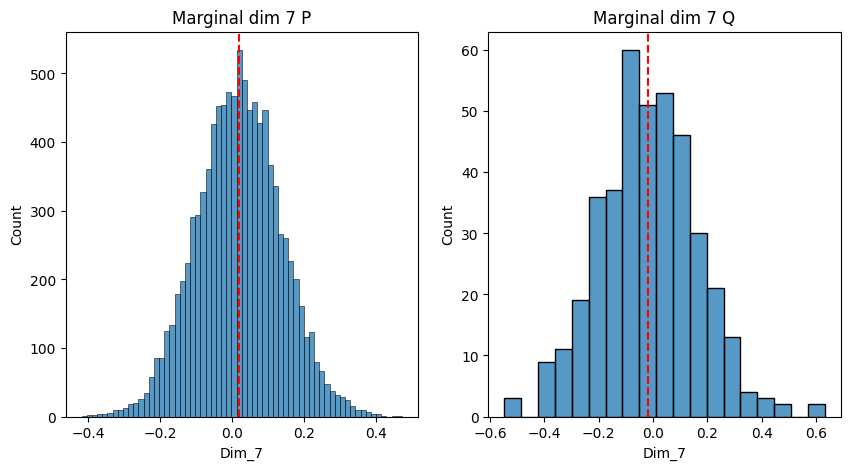

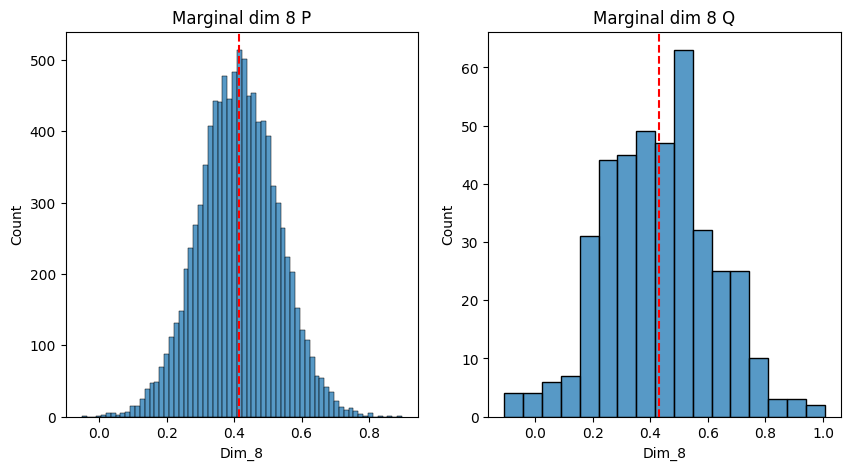

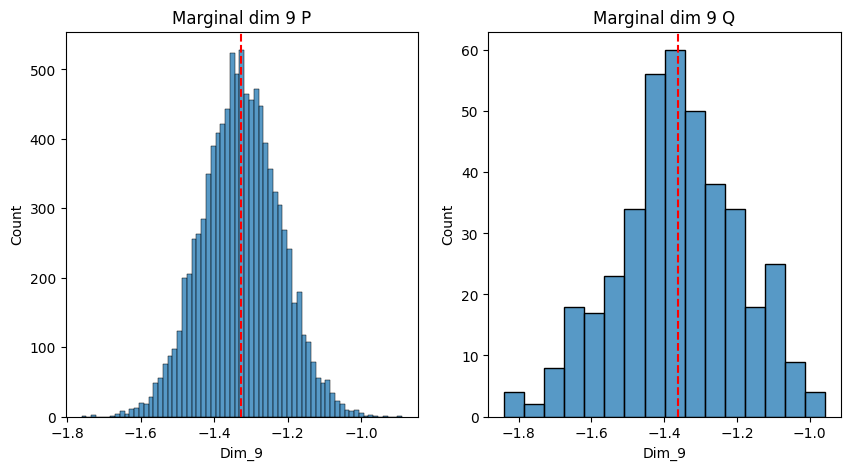

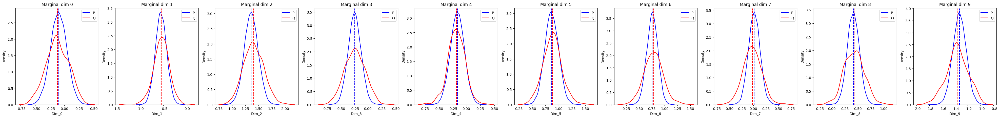

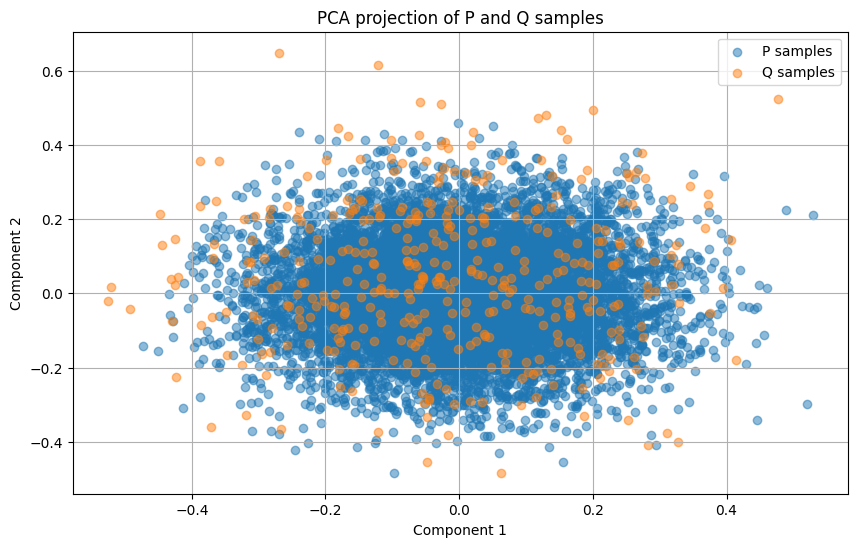

/usr/local/lib/python3.10/dist-packages/pyro/util.py:288: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'beta_var'}
  warnings.warn(


....................


Sample: 100%|██████████| 800/800 [01:02, 12.74it/s, step size=1.65e-01, acc. prob=0.942]


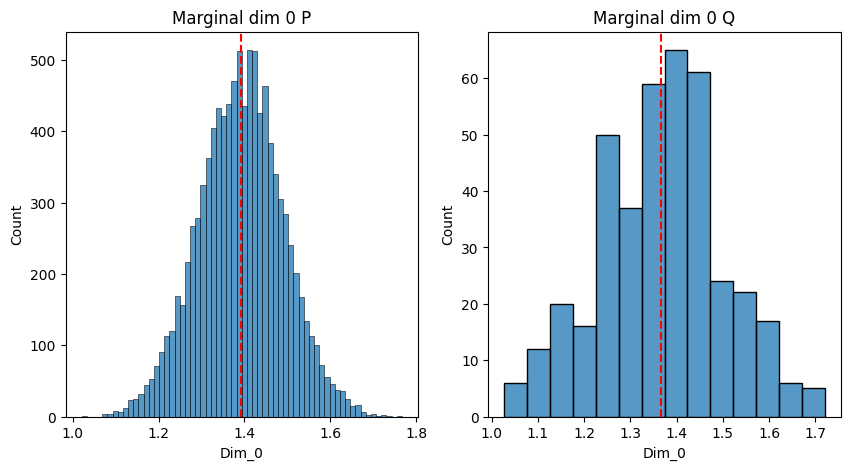

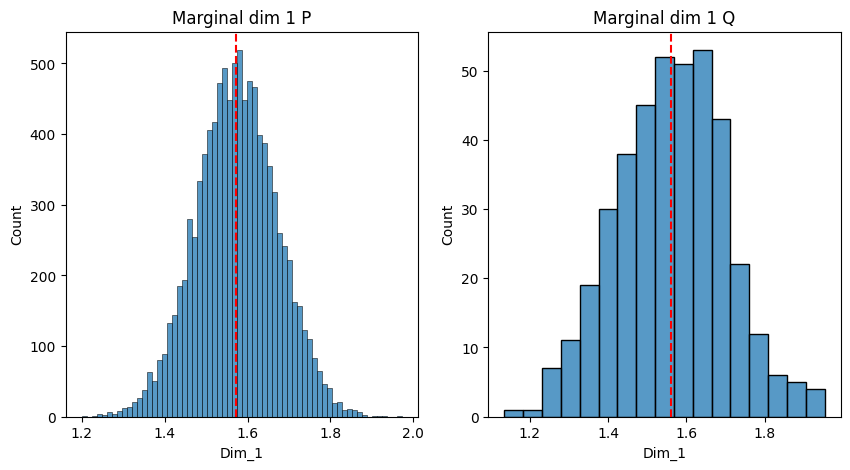

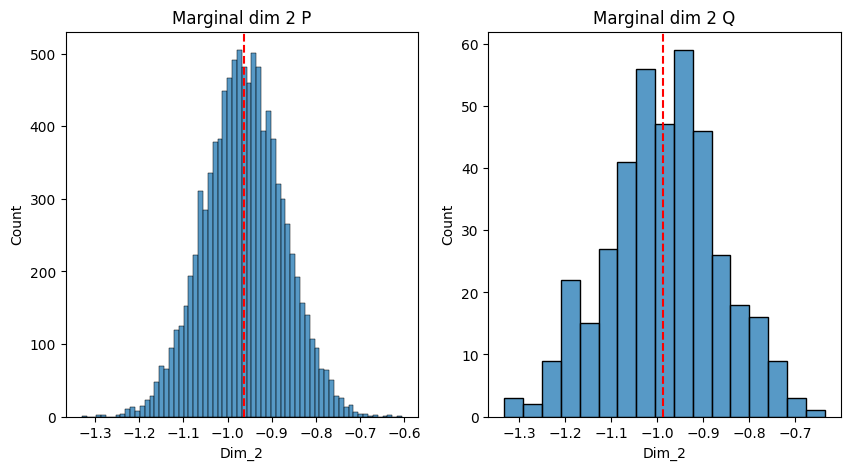

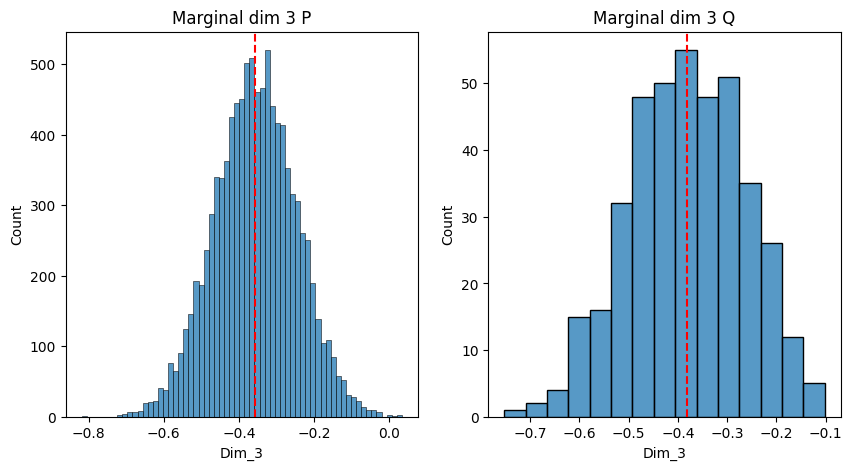

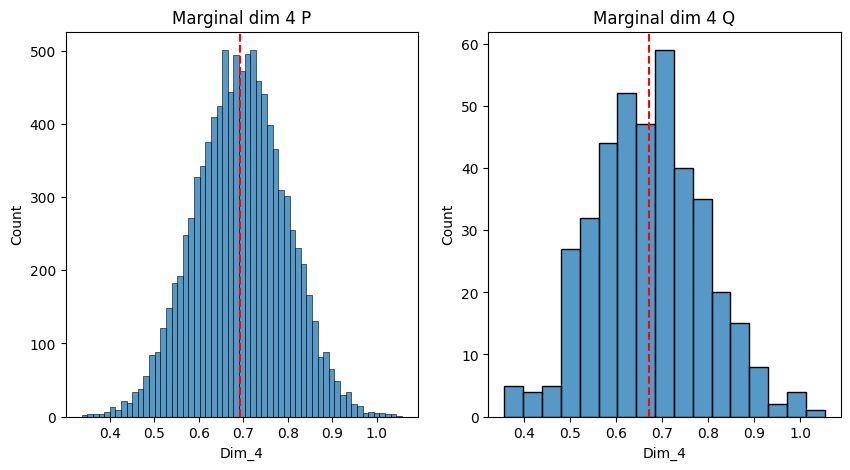

...

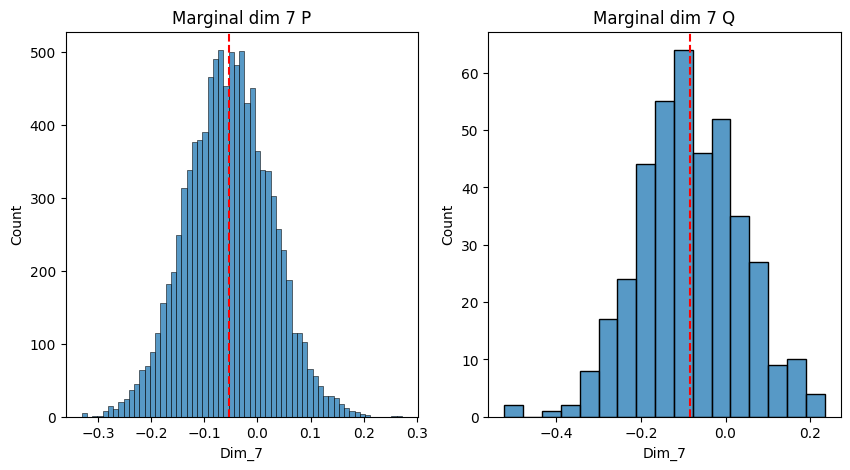

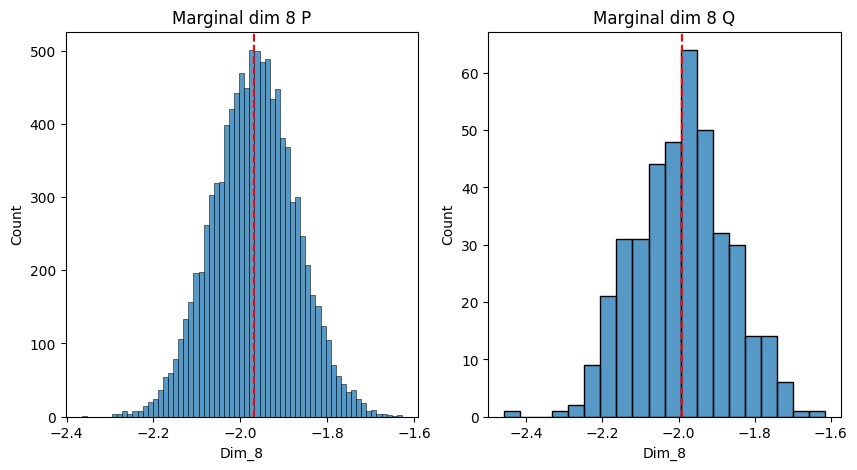

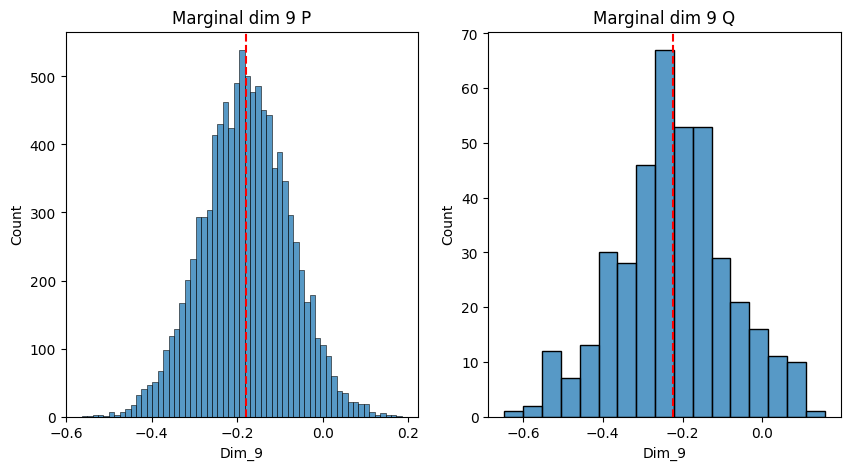

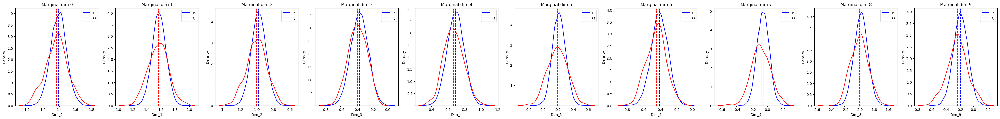

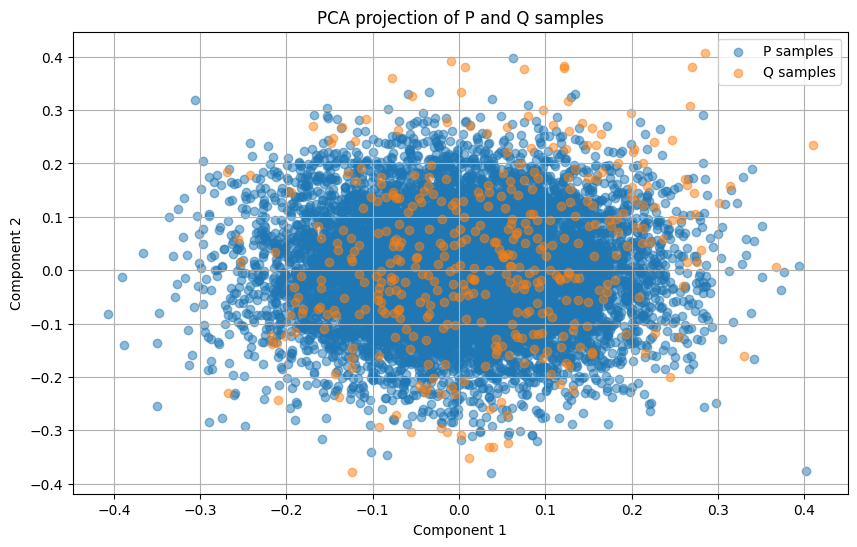

In [ ]:
vi_hmc_res = comparison_model_comparer.compare_sample_metrics_batch(test_batch["x"][:5], test_batch["y"][:5])

In [ ]:
print_wasserstein_distances(vi_hmc_res)

[0.4266628324985504, 0.3555838167667389, 0.22717873752117157, 0.3681538701057434, 0.2735488712787628]
0.33022562563419344
